## Import packages
### Standard modules
* datetime: [Basic date and time types.](https://docs.python.org/3/library/datetime.html)
* glob: [Unix style pathname pattern expansion.](https://docs.python.org/3/library/glob.html?highlight=glob#module-glob)
* gzip: [This module provides a simple interface to compress and decompress files.](https://docs.python.org/3/library/gzip.html)
* math: [Mathematical functions.](https://docs.python.org/3/library/math.html)
* os: [Miscellaneous operating system interfaces.](https://docs.python.org/3/library/os.html?highlight=os#module-os)
* random: [Generate pseudo-random numbers.](https://docs.python.org/3/library/random.html?highlight=random#module-random)
* shutil: [Offers a number of high-level operations on files and collections of files.](https://docs.python.org/3/library/shutil.html?highlight=shutil#module-shutil)
* struct: [Interpret bytes as packed binary data.](https://docs.python.org/3/library/struct.html?highlight=struct#module-struct)

### Jupyter notebook modules
* jupyter: [Coding framework.](https://docs.jupyter.org/en/latest/)
* IPython: [IPython provides a rich toolkit to help you make the most of using Python interactively.](https://ipython.readthedocs.io/en/stable/)
* ipywidgets: [Jupyter Widgets are interactive browser controls for Jupyter notebooks.](https://ipywidgets.readthedocs.io/en/latest/)

### Additional packages
* imageio: [Provides an easy interface to read and write a wide range of image data.](https://imageio.readthedocs.io/en/stable/)
* matplotlib: [Library for creating static, animated, and interactive visualizations.](https://matplotlib.org/stable/users/index)
* numpy: [Library that provides a multidimensional array object, various derived objects, and an assortment of routines for fast operations on arrays.](https://numpy.org/doc/stable/)
* torch: [An optimized tensor library for deep learning using GPUs and CPUs.](https://pytorch.org/docs/stable/index.html)
* torchvision: [Package consists of popular datasets, model architectures, and common image transformations for computer vision.](https://pytorch.org/vision/stable/index.html)
* tqdm : [Adds a smart progress meter to loops.](https://tqdm.github.io/)
* wget: [Package for downloading files from web addresses.](https://pypi.org/project/wget/)

In [1]:
# Install additional packages.
!pip install -qq imageio matplotlib numpy torch torchvision tqdm wget jupyter ipywidgets==7.4.2

# Import python standard modules.
from datetime import datetime
import glob
import gzip
import math
import os
import random
import shutil
import struct

# Jupyter notebook modules.
from IPython.display import Image

# Import the installed packages. 
import imageio
import matplotlib.pyplot as plt
import numpy as np
import torch
from torchvision import transforms
from tqdm.notebook import tqdm
import wget

print('Finished importing the packages.')

Finished importing the packages.


## Define arguments
### DATA_*
Arguments for loading the data.
* DATA_FILE_TYPES: The file extensions of the norb dataset.
* DATA_FOLDER: The folder where the data files are stored.
* DATA_PREFIXES: The file prefix of the norb file names.
* DATA_NUMBERS_FOR_MAPPING_DATA_TYPES: The magic number encodes the element type of the matrix. Note: Those are only the numbers needed for the files in this project.
* DATA_URL: Url for downloading the data files.

### PREP_*
Arguments for preparing the data.
* PREP_BATCH_SIZE: Defines how many files are processed at each step.
* PREP_CAMERA: Index of the camera (channel of the image).
* PREP_IMAGE_SIZE: The pixel size of the images.
* PREP_SHUFFLE_DATA: If true, the data is shuffled.

### RUN_*
Arguments for defining and running the neural network.
* RUN_CRITIC_REPEAT: Defines how often the critic is used in each step.
* RUN_DEVICE: Which device to use for running the network (CUDA or CPU).
* RUN_DISPLAY_EACH: Show images, each n steps.
* RUN_DROPOUT_VALUE: Probability of an element to be zeroed.
* RUN_EPOCHS: Defines how often the training is repeated for all data.
* RUN_HIDDEN_DIM: The ground value for the dimensions in the hidden layers.
* RUN_LABEL_CHANNELS: The total number of classes for labeling the data set.
* RUN_LEAK_VALUE: Controls the angle of the negative slope of the leakyRelu function.
* RUN_OPT_BETA_1: Parameter for the Adam optimizer. The exponential decay rate for the first-moment estimates.
* RUN_OPT_BETA_2: Parameter for the Adam optimizer. The exponential decay rate for the second-moment estimates.
* RUN_OPT_LR: Weight of the gradient penalty
* RUN_TEST_LABELS: Label classes for creating a specific test noise.
* RUN_Z_DIM: Defines how many channels the noise tensor has.

### RES_*
Arguments for showing the results.
* RES_GIF_FILE: Name and path for storing the GIF file, containing the result data.
* RES_IMAGE_AMOUNT: How many images to show.
* RES_IMAGE_FOLDER: Folder for generated test images, inside the output folder.
* RES_LOSS_DATA_CRIT: File for storing the critic's loss values.
* RES_LOSS_DATA_GEN: File for storing the generator loss values.
* RES_LOSS_DATA_TEST: File for storing the test loss values.
* RES_LOSS_PLOT_TEST: File for storing the test loss plot. 
* RES_LOSS_PLOT_TRAIN: File for storing the training loss plot. 
* RES_MODEL_PATH: Path for storing the models.
* RES_OUTPUT_FOLDER: Folder for this runs results.
* RES_PLOT_COLUMNS: The amount of images in one row of the plot.
* RES_PLOT_SIZE: The size of the plots width and height in inches.

In [2]:
# Define variables.
DATA_FILE_TYPES = ['info', 'cat', 'dat']
DATA_FOLDER = "./data/"
DATA_PREFIXES = {
    'train': 'smallnorb-5x46789x9x18x6x2x96x96-training-',
    'test': 'smallnorb-5x01235x9x18x6x2x96x96-testing-',
}
DATA_NUMBERS_FOR_MAPPING_DATA_TYPES = {
    '1e3d4c55': np.uint8,
    '1e3d4c54': np.int32,
}
DATA_URL = 'https://cs.nyu.edu/~ylclab/data/norb-v1.0-small/'

PREP_BATCH_SIZE = 32
PREP_CAMERA = 0
PREP_IMAGE_SIZE = 67
PREP_SHUFFLE_DATA = True

RUN_CRITIC_REPEAT = 3
RUN_CRITIC_LAMBDA = 10.0
RUN_DEVICE = 'cuda'
RUN_DISPLAY_EACH = 1
RUN_DROPOUT_VALUE = 0.1
RUN_EPOCHS = 100
RUN_HIDDEN_DIM = 32
RUN_LABEL_CHANNELS = [5, 10, 9, 18, 6] # (5 categories, 10 instances, 9 elevations, and 18 azimuths, 6 lightings)
RUN_LEAK_VALUE = 0.1
RUN_OPT_BETA_1 = 0.9
RUN_OPT_BETA_2 = 0.999
RUN_OPT_LR = 0.001
RUN_TEST_LABELS = torch.as_tensor([2, 6, 7, 17, 0], dtype=torch.int64)
RUN_Z_DIM = 100

RES_GIF_FILE = 'norb_test_images.gif'
RES_IMAGE_AMOUNT = 9
RES_IMAGE_FOLDER = './img'
RES_LOSS_DATA_CRIT = 'norb_loss_crit.txt'
RES_LOSS_DATA_GEN = 'norb_loss_gen.txt'
RES_LOSS_DATA_TEST = 'norb_loss_test.txt'
RES_LOSS_PLOT_TEST = 'norb_loss_plot_test.png'
RES_LOSS_PLOT_TRAIN = 'norb_loss_plot_train.png'
RES_MODEL_PATH = './'
RES_OUTPUT_FOLDER = datetime.now().strftime("%Y%m%d_%H%M%S_%f")
RES_PLOT_COLUMNS = 5
RES_PLOT_SIZE = 21

print('Finished setting the arguments.')

Finished setting the arguments.


## Load files
### Description
Download the files and convert the binary data to tensor objects. Afterwards, show some examples.

### Functions
* download_and_unzip: Downloads and unzips a file.
* get_int_from_file: Helper function for reading int from binary file.
* load_norb_data: Load the norb data from binary files and convert it to images.
* show_tensor_images: Shows images using pyplot from the matplotlib package. Also prints some information about the images.

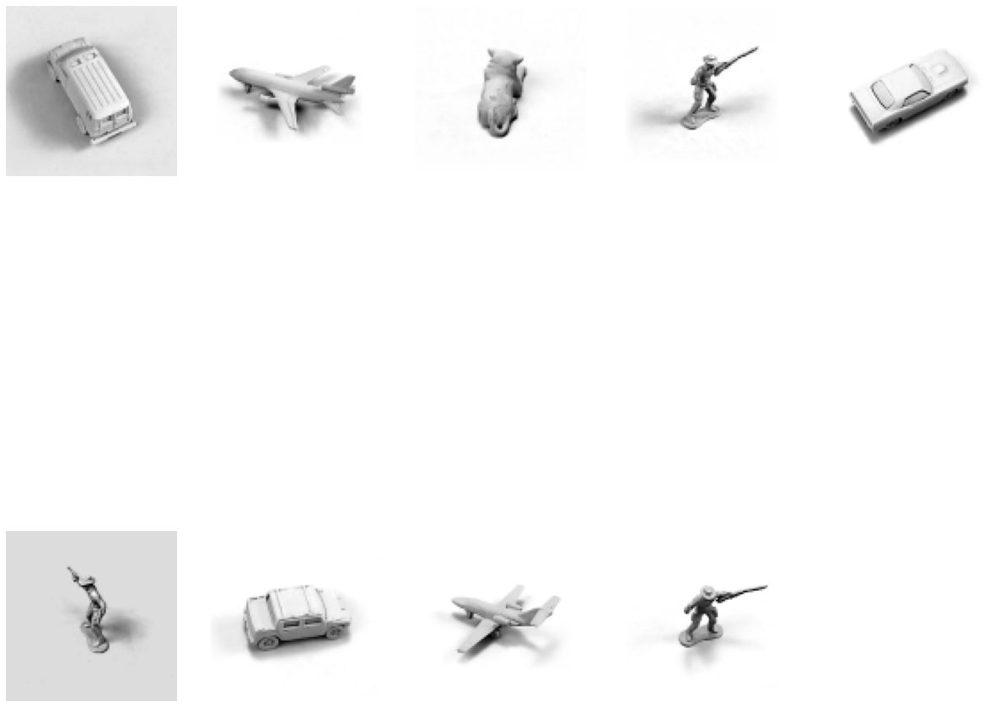

1: 3 [ 4  5 16  4]
2: 2 [ 9  0 26  4]
3: 0 [6 1 8 0]
4: 1 [4 0 4 4]
5: 4 [ 6  4 10  3]
6: 1 [ 4  1 28  2]
7: 3 [9 3 4 5]
8: 2 [ 8  0 26  5]
9: 1 [4 3 2 5]
Finished loading files.


In [3]:
def download_and_unzip(file_name: str, file_extension: str, dst_folder: str, url: str) -> None:
    """
    Downloads and unzips a file.
    
    Parameters
    ----------
    file_name: str
         The basename of the compressed file (without the extension for the compressed version).
    file_extension: str
        The file extension for the compressed version.
    dst_folder: str
        Destination folder for the files.
    url: str
        Source URL for the file, without the filename.
    """
    # Build file and zip path.
    file_path = os.path.join(dst_folder, file_name)
    gz_name = file_name + '.gz'

    # Check if the data folder already exists, if not create the folder.
    if not os.path.exists(dst_folder):
        os.mkdir(dst_folder)

    # Check if this file already exists.
    if not os.path.exists(file_path):
        # Download the file.
        wget.download(url + gz_name , gz_name)

        # Decompress the file and move it to the folder.
        with gzip.open(gz_name, 'rb') as f_in:
            with open(file_path, 'wb') as f_out:
                shutil.copyfileobj(f_in, f_out)

        # Delete the compressed version afterwards.
        os.remove(gz_name)

def get_int_from_file(f: object) -> int:
    """
    Helper function for reading int from binary file.
    
    Parameters
    ----------
    f: file-object
        The data file.
    
    Returns
    -------
    int
        The content of the file as integer.
    """
    num, = struct.unpack('i', f.read(4))
    return num


def load_norb_data(file_folder: str, file_prefix: object, file_types: list, map_data_types: object) -> object: 
    """
    Load the norb data from binary files and convert it to images.
    
    Parameters
    ----------
    file_folder: str
        The folder where the data files are stored.
    file_prefix: object of str
        The file prefix of the norb file names.
    file_types: list of str
        The file extensions of the norb dataset.
    map_data_types: object of numpy.dtype
        The magic number encodes the element type of the matrix.
        
    Returns
    -------
    object
        Images of the norb dataset.
    """
    # Define the return object.
    loaded_data = {}
    
    # Loop over each file.
    for dataset, prefix in file_prefix.items():
        for filetype in file_types:
            # Set up the file name and path for reading the files.
            filename = prefix + filetype + ".mat"
            file_loc = os.path.join(file_folder, filename)

            with open( file_loc, 'rb') as f:
                # Read the magic_num, convert it to hexadecimal and look up the data_type.
                raw_magic_num = get_int_from_file(f)
                magic_num = format(raw_magic_num, '02x')
                data_type = map_data_types[magic_num]

                # Read how many dimensions to expect.
                ndim = get_int_from_file(f)

                # Read at least 3 ints, or however many ndim there are.
                shape = [
                    get_int_from_file(f)
                    for i in range(max(ndim, 3))
                ]   

                # But in case ndims < 3, take at most n_dim elements.
                shape = shape[:ndim]

                # Now load the actual data.
                loaded_data[(dataset, filetype)] = np.fromfile(
                    f, 
                    dtype=data_type, 
                    count=np.prod(shape)
                ).reshape(shape)
    
    return loaded_data        


def show_tensor_images(image: np.array, infos: list, columns: int, size: int, channel: int =-1, file_path: str ='') -> None:
    """
    Shows images using pyplot from the matplotlib package. Also prints some information about the images.
    
    Parameters
    ----------
    image: np.array
        The image numpy array.
    infos: list of str
        Contains some information about the images.
    columns: int
        The amount of columns for the plot
    size: int
        The size of the plots width and height in inches.
    channel: int, optional
        If -1 all channels are shown as RGB image. If not -1 only this specific channel is shown as a grayscale image.
    file_path: str, optional
        If '' the plots are not saved as GIF. If not '' the content of file_path is used to save the images as PNG.
    """
    # Get the image amount and define the amount of rows for the plot.
    image_length = len(image)
    rows = math.ceil(image_length / columns)
    
    # Set the size for each image in the plot.
    fig = plt.figure(figsize=(size,size)) 
    
    # Loop over each image and add it to the plot.
    for i in range(0, image_length):
        plt.subplot(rows, columns, i+1)
        
        if channel == -1:
            plt.imshow(images[i], cmap="rgb")
        else:
            plt.imshow(image[i][channel], cmap="gray")
            
        plt.axis('off')
    
    # Save the file, if file_path is set.
    if file_path != '':
        plt.savefig('{}.png'.format(file_path))
    
    plt.show()
    
    # Print the content of the info list.
    for j in range(0, len(infos)):
        print(f'{j+1}: {infos[j]}')


# Loop over each file prefix and file type and download the files.
for prefix in DATA_PREFIXES:
    for t in DATA_FILE_TYPES:   
        download_and_unzip(DATA_PREFIXES[prefix] + t + '.mat', '.gz', DATA_FOLDER, DATA_URL)
                
# Load the data files.
loaded_data = load_norb_data(DATA_FOLDER, DATA_PREFIXES, DATA_FILE_TYPES, DATA_NUMBERS_FOR_MAPPING_DATA_TYPES)

# Show some random original images.
idx = np.random.randint( loaded_data[('train', 'cat')].shape[0], size=RES_IMAGE_AMOUNT)

# Collect the information from the files to show some examples.
infos = []
images = []
for i in idx:
    # Get the information from the cat file.
    info_text = str(loaded_data[('train', 'cat')][i]) + ' ' + str(loaded_data[('train', 'info')][i])
    infos.append(info_text)
    
    # Get the image data from the dat file.
    images.append(loaded_data[('train', 'dat')][i])
    
# Show image.
show_tensor_images(np.array(images), infos, RES_PLOT_COLUMNS, RES_PLOT_SIZE, 0, '')

print('Finished loading files.')

## Prepare data
### Description
Here the data are prepared (normalization, resizing etc.) and a data loader is created, that can be used for training the model.

### Transformation steps
* Selecting a specific camera (tensor channel).
* Converting the tensor values from a range of 0 to 255 to a range of 0 to 1.
* Insure that all images have the same size.

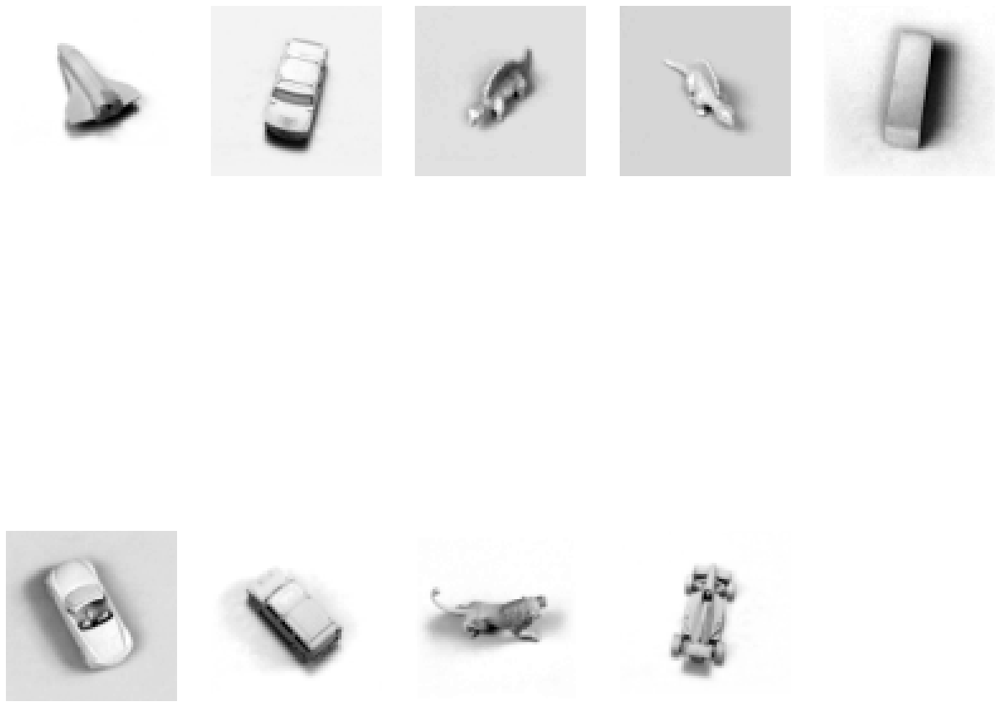

Finished preparing the data.


In [4]:
def categories_tensor_values(tensor: torch.Tensor, index: int) -> torch.Tensor:
    """
    Gets the a distinct sorted list of all values in a tensor.
    Afterwards the values in the tensor are replaced with the corresponding position of this value in the sorted list.
    
    Parameters
    ----------
    tensor: torch.Tensor
        The input tensor object.
    index: int
        The index for dimension 1. Only values in this specific position are replaced.
        
    Returns
    -------
    torch.Tensor
        The tensor object, with the changed values.
    """
    # Get the unique value list.
    categories = torch.unique(tensor[:, index])
    
    # Loop over the category list and dimension 0 of the input tensor.
    for i in range(0, len(categories)):
        for j in range(0, len(tensor[:, index])):
            # Check if the value in the category list matches with the value in the tensor.
            # If so, replace the value in the tensor with the index from the category list.
            if tensor[j, index] == categories[i]:
                tensor[j, index] = i
    return tensor

# Load the content of the dat files.
images_train = torch.from_numpy(loaded_data[('train', 'dat')])
images_test  = torch.from_numpy(loaded_data[('test', 'dat')])

# Load the content of the cat files.
category_train = torch.from_numpy(loaded_data[('train', 'cat')])
category_test  = torch.from_numpy(loaded_data[('test', 'cat')])

# Load the content of the cat files.
info_train = torch.from_numpy(loaded_data[('train', 'info')])
info_test  = torch.from_numpy(loaded_data[('test', 'info')])

# Join the categories and information to a combined label tensor.
labels_train = torch.cat([category_train.view(len(category_train), 1), info_train], dim=1).to(torch.int64)
labels_test = torch.cat([category_test.view(len(category_test), 1), info_test], dim=1).to(torch.int64)

# Categories the azimuth values.
labels_train = categories_tensor_values(labels_train, 3)
labels_test = categories_tensor_values(labels_test, 3)

# Define transformation for the data.
transform = transforms.Compose([
    transforms.Lambda(lambda x: x[PREP_CAMERA]),
    transforms.Lambda(lambda x: x / 255),
    transforms.ToPILImage(),
    transforms.Resize(PREP_IMAGE_SIZE),
    transforms.ToTensor()
])

# Transform the training data.
data_train = torch.empty([images_train.size(0), 1, PREP_IMAGE_SIZE, PREP_IMAGE_SIZE])
for i in range(0, images_train.size(0)):
    data_train[i] = transform(images_train[i])

# Transform the test data.
data_test = torch.empty([images_test.size(0), 1, PREP_IMAGE_SIZE, PREP_IMAGE_SIZE])
for i in range(0, images_test.size(0)):
    data_test[i] = transform(images_test[i])
    
# Create data sets for training and test files.
data_train = torch.utils.data.TensorDataset(data_train, labels_train)
data_test = torch.utils.data.TensorDataset(data_test, labels_test)

# Merge both datasets.
merged_data = torch.utils.data.ConcatDataset([data_train, data_test])

# Get image from test label.
test_image = []
for image, label in merged_data:
    if torch.equal(label, RUN_TEST_LABELS):
        test_image.append(image.numpy())

# Create a data loader for the data.
loader_train = torch.utils.data.DataLoader(merged_data, batch_size=PREP_BATCH_SIZE, shuffle=PREP_SHUFFLE_DATA)

# Show some random prepared images.
idx = np.random.randint( len(merged_data), size=RES_IMAGE_AMOUNT)

images = []
for i in idx:
    # Get the image data from the dat file.
    images.append((merged_data[i][0]).numpy())

# Show image.
images = np.array(images)
images = images * 255
show_tensor_images(images, [], RES_PLOT_COLUMNS, RES_PLOT_SIZE, 0, '')

print('Finished preparing the data.')

## Define the network
### Description
Defines a function for creating the noise vector and the classes for the generator and the critic.

In [5]:
def get_noise(n_samples: int, z_dim: int, device: str ='cpu') -> torch.Tensor:
    """
    Create a noise vector with dimensions (n_samples, z_dim)
    
    Parameters
    ----------
    n_samples: int
        The amount of samples.
    z_dim: int
        The amount of dimensions/channels.
        
    Returns
    -------
    torch.tensor
        Noise vector.
    """
    return torch.randn(n_samples, z_dim, device=device)


class Generator(torch.nn.Module):
    """ 
    The generator class for producing fake images.
    
    Parameters
    ----------
    z_dim: int
        The dimensions/channels of the noise vector.
    hidden_dim: int
        The ground value for the dimensions in the hidden layers.
    dropout_value: float, optional
        The probability of an element to be zeroed.
    leak_value: float, optional
        Controls the angle of the negative slope.
    """
    def __init__(self, z_dim: int, hidden_dim: int, dropout_value: float =0.5, leak_value: float = 0.01) -> None:
        """
        Initialization function for the generator. 
        Defines how many network blocks are used and which are used for each block.
        """
        super(Generator, self).__init__()
        
        self.layers = torch.nn.Sequential(
            self.convTranspose2d_block(z_dim, hidden_dim, 3, 1, dropout_value, leak_value),
            self.convTranspose2d_block(hidden_dim, hidden_dim, 3, 2, dropout_value, leak_value),
            self.convTranspose2d_block(hidden_dim, hidden_dim, 5, 1, dropout_value, leak_value),
            self.convTranspose2d_block(hidden_dim, hidden_dim, 5, 2, dropout_value, leak_value),
            self.convTranspose2d_block(hidden_dim, hidden_dim, 7, 1, dropout_value, leak_value),
            self.convTranspose2d_block(hidden_dim, 1, 7, 2, dropout_value, leak_value, final_layer=True)
        )

    def convTranspose2d_block(self, input_channels: int, output_channels: int, 
                  kernel_size: int, stride: int, dropout_value: float, 
                  leak_value: float, final_layer: bool =False) -> torch.nn.Sequential:
        """
        Implements a set of layers of the network. The main part of this block is the ConvTranspose2d layer.
        
        Parameters
        ----------
        input_channels: int
            Number of channels in the input image.
        output_channels: int
            Number of channels produced by the convolution.
        kernel_size: int
            The size of the filters that are used.
        stride: int
            The amount of steps taken, moving from one frame to another the next frame.
        dropout_value: float
            The probability of an element to be zeroed.
        leak_value: float
            Controls the angle of the negative slope.
        final_layer: bool
            Flag for differentiating between the final layer and all other layers.
        
        Returns
        -------
        torch.nn.Sequential
            A combination of different layers for the generator.
        """
        if not final_layer:
            # Define the block for not final layer.
            return torch.nn.Sequential(
                torch.nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                torch.nn.InstanceNorm2d(output_channels),
                torch.nn.LeakyReLU(leak_value, inplace=True),
                torch.nn.Dropout(dropout_value)
            )
        else:
            # Define the block for the final layer.
            return torch.nn.Sequential(
                torch.nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                torch.nn.InstanceNorm2d(output_channels),
                torch.nn.Tanh()
            )
        
    def forward(self, noise: torch.Tensor) -> torch.Tensor:
        """
        Function for completing a forward pass of the generator.
        
        Parameters
        ----------
        noise: torch.Tensor
            A noise vector.
        
        Returns
        -------
        torch.Tensor
            An image.
        """
        x = noise.view(noise.size(0), noise.size(1), 1, 1)        
        x = self.layers(x)       
        return x


class Critic(torch.nn.Module):
    """
    The critic class defining how real a fake image is.
    
    Parameters
    ----------
    img_channel: int
        The channels of the image.
    hidden_dim: int
        The ground value for the dimensions in the hidden layers.
    dropout_value: float, optional
        The probability of an element to be zeroed.
    leak_value: float, optional
        Controls the angle of the negative slope.
    """
    
    def __init__(self, img_channel: int, hidden_dim: int, dropout_value: float =0.5, leak_value: float = 0.01) -> None:
        super(Critic, self).__init__()
        """
        Initialization function for the critic. 
        Defines how many network blocks are used and which are used for each block.
        """

        self.layers = torch.nn.Sequential(
            self.conv2d_block(img_channel, hidden_dim, 7, 2, dropout_value, leak_value),
            self.conv2d_block(hidden_dim, hidden_dim, 7, 1, dropout_value, leak_value),
            self.conv2d_block(hidden_dim, hidden_dim, 5, 2, dropout_value, leak_value),
            self.conv2d_block(hidden_dim, hidden_dim, 5, 1, dropout_value, leak_value),
            self.conv2d_block(hidden_dim, hidden_dim, 3, 2, dropout_value, leak_value),
            self.conv2d_block(hidden_dim, 1, 3, 1, dropout_value, leak_value, final_layer=True)
        )
        
    def conv2d_block(self, input_channels: int, output_channels: int,
                   kernel_size: int, stride: int, dropout_value: float,
                   leak_value: float, final_layer: bool =False) -> torch.nn.Sequential:
        """
        Implements a set of layers of the network. The main part of this block is the Conv2d layer.
        
        Parameters
        ----------
        input_channels: int
            Number of channels in the input image.
        output_channels: int
            Number of channels produced by the convolution.
        kernel_size: int
            The size of the filters that are used.
        stride: int
            The amount of steps taken, moving from one frame to another the next frame.
        dropout_value: float
            The probability of an element to be zeroed.
        leak_value: float
            Controls the angle of the negative slope.
        final_layer: bool
            Flag for differentiating between the final layer and all other layers.
        
        Returns
        -------
        torch.nn.Sequential
            A combination of different layers for the generator.
        """
        if not final_layer:
            # Define the block for not final layer.
            return torch.nn.Sequential(
                torch.nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                torch.nn.InstanceNorm2d(output_channels),
                torch.nn.LeakyReLU(leak_value, inplace=True),
                torch.nn.Dropout(dropout_value)
            )
        else:
            # Define the block for the final layer.
            return torch.nn.Sequential( 
                torch.nn.Conv2d(input_channels, output_channels, kernel_size, stride)
            )
        
    def forward(self, image: torch.Tensor) -> torch.Tensor:
        """
        Function for completing a forward pass of the critic.
        
        Parameters
        ----------
        image: torch.Tensor
            An image tensor with dimension (im_chan).
            
        Returns
        -------
        torch.Tensor
            A 1-dimension tensor representing fake/real.
        """       
        x = self.layers(image)    
        return x.view(len(x), -1)


print('Finished defining noise function, generator and critic.')

Finished defining noise function, generator and critic.


## Gradient Penalty
### Description
This part contains functions for calculating the gradient penalty.
### Functions
* get_gradient: Return the gradient of the critic scores with respect to mixes of real and fake images.
* gradient_penalty: Return the gradient penalty, given a gradient. Given a batch of image gradients, you calculate the magnitude of each image's gradient and penalize the mean quadratic distance of each magnitude to 1.
* get_gen_loss: Return the loss of a generator given the critic scores of the generator's fake images.
* get_crit_loss: Return the loss of a critic given the critic scores for fake and real images, the gradient penalty, and gradient penalty weight.

In [6]:
def get_gradient(crit: Critic, real: torch.Tensor, fake: torch.Tensor, epsilon: torch.Tensor) -> torch.Tensor:
    """
    Return the gradient of the critic scores with respect to mixes of real and fake images.
    
    Parameters
    ----------
        crit: Critic
            The critic model.
        real: : torch.Tensor
            A batch of real images.
        fake: torch.Tensor
            A batch of fake images.
        epsilon: torch.Tensor
            A vector of the uniformly random proportions of real/fake per mixed image.
    
    Returns
    -------
    torch.Tensor
        The gradient of the critic scores, with respect to the mixed image.
    """
    # Mix the images together.
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic scores on the mixed images.
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images.
    return torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]


def gradient_penalty(gradient: torch.Tensor) -> torch.Tensor:
    """
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    
    Parameters
    ----------
        gradient: torch.Tensor
            The gradient of the critic scores, with respect to the mixed image.
    
    Returns
    -------
        penalty: torch.Tensor
            The gradient penalty.
    """
    # Flatten the gradients so that each row captures one image.
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row.
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1.
    return torch.mean((gradient_norm -1)**2)


def get_gen_loss(crit_fake_pred: torch.Tensor) -> torch.Tensor:
    """
    Return the loss of a generator given the critic scores of the generator's fake images.
    
    Parameters
    ----------
    crit_fake_pred: torch.Tensor
        The critic scores of the fake images.
        
    Returns
    -------
    torch.Tensor
        A scalar loss value for the current batch of the generator.
    """
    return -1* torch.mean(crit_fake_pred)


def get_crit_loss(crit_fake_pred: torch.Tensor, crit_real_pred: torch.Tensor,
                  gp: torch.Tensor, c_lambda: float) -> torch.Tensor:
    """
    Return the loss of a critic given the critic scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    
    Parameters
    ----------
    crit_fake_pred: torch.Tensor
        The critic scores of the fake images.
    crit_real_pred: torch.Tensor
        The critic scores of the real images.
    gp: torch.Tensor
        The unweighted gradient penalty.
    c_lambda: float
        The current weight of the gradient penalty
    
    Returns
    -------
    torch.Tensor
        A scalar for the critic's loss, accounting for the relevant factors.
    """
    return torch.mean(crit_fake_pred - crit_real_pred + gp * c_lambda)


print('Finished defining functions for calculating the gradient penalty.')

Finished defining functions for calculating the gradient penalty.


## Initialize the network
### Description
* Initialize the generator and the critic.
* Initialize the loss and optimizer function.
* Apply starting weights to the generator and critic.

In [7]:
def weights_init(m: object):
    """
    Initialize the weights for Conv2d and ConvTranspose2d layers to the normal distribution with mean 0 and standard deviation 0.02.
    
    Parameters
    ----------
    m: object
        The mean weight value.
    """
    if isinstance(m, torch.nn.Conv2d) or isinstance(m, torch.nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)


# Initialize the generator and critic.
gen = Generator(RUN_Z_DIM + sum(RUN_LABEL_CHANNELS), RUN_HIDDEN_DIM, RUN_DROPOUT_VALUE, RUN_LEAK_VALUE).to(RUN_DEVICE)
crit = Critic(1 + sum(RUN_LABEL_CHANNELS), RUN_HIDDEN_DIM, RUN_DROPOUT_VALUE, RUN_LEAK_VALUE).to(RUN_DEVICE)

# Define the loss function.
criterion = torch.nn.BCEWithLogitsLoss()

# Define the optimizer for both generator and discriminator.
gen_opt = torch.optim.Adam(gen.parameters(), lr=RUN_OPT_LR, betas=(RUN_OPT_BETA_1, RUN_OPT_BETA_2))
crit_opt = torch.optim.Adam(crit.parameters(), lr=RUN_OPT_LR, betas=(RUN_OPT_BETA_1, RUN_OPT_BETA_2))

# Apply the starting weights to generator and critic.
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)

print('Finished initializing the network.')

Finished initializing the network.


## Training the network
### Description
Trains the network and uses a predefined noise vector to test the network after each epoch.

  0%|          | 0/1519 [00:00<?, ?it/s]

original image


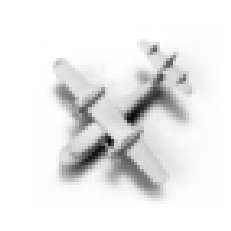

fake images


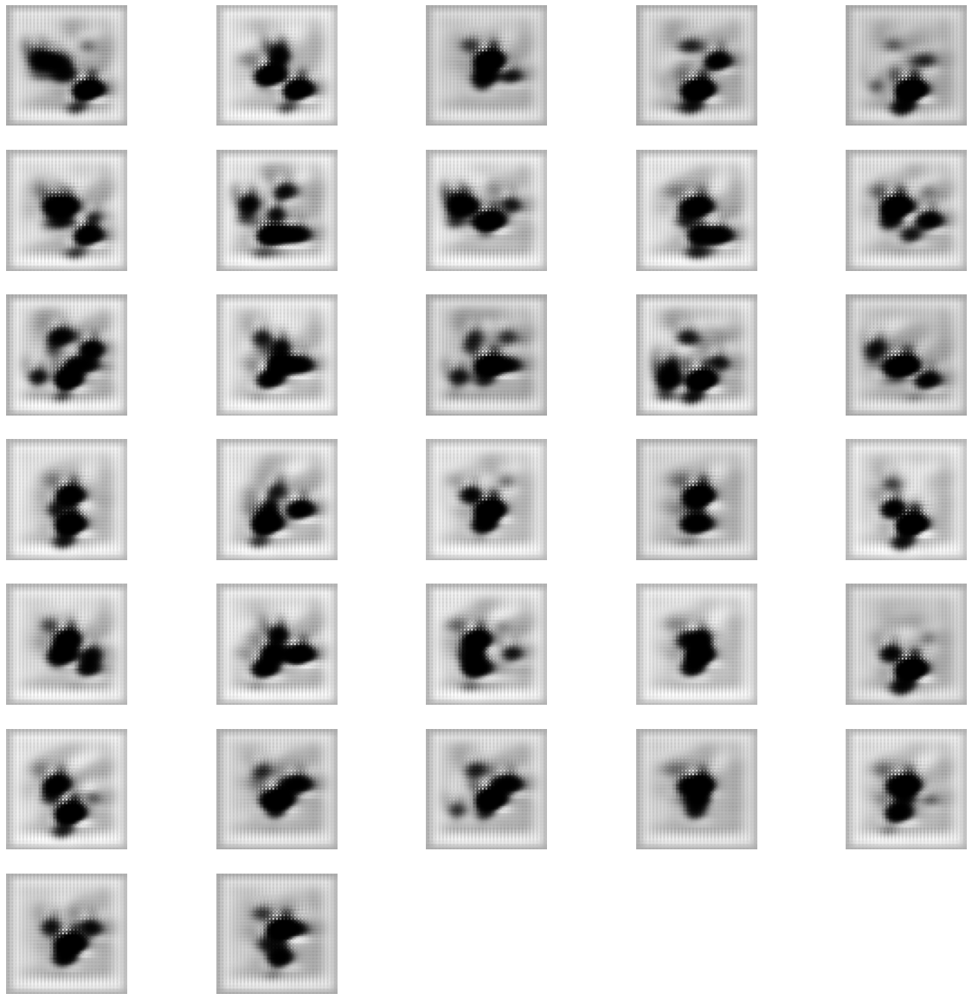

Epoch 0, Generator loss: 3.8052585124969482, discriminator loss: -0.17396589120229078


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


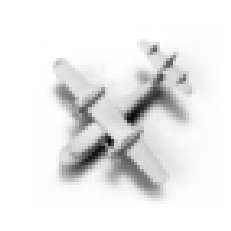

fake images


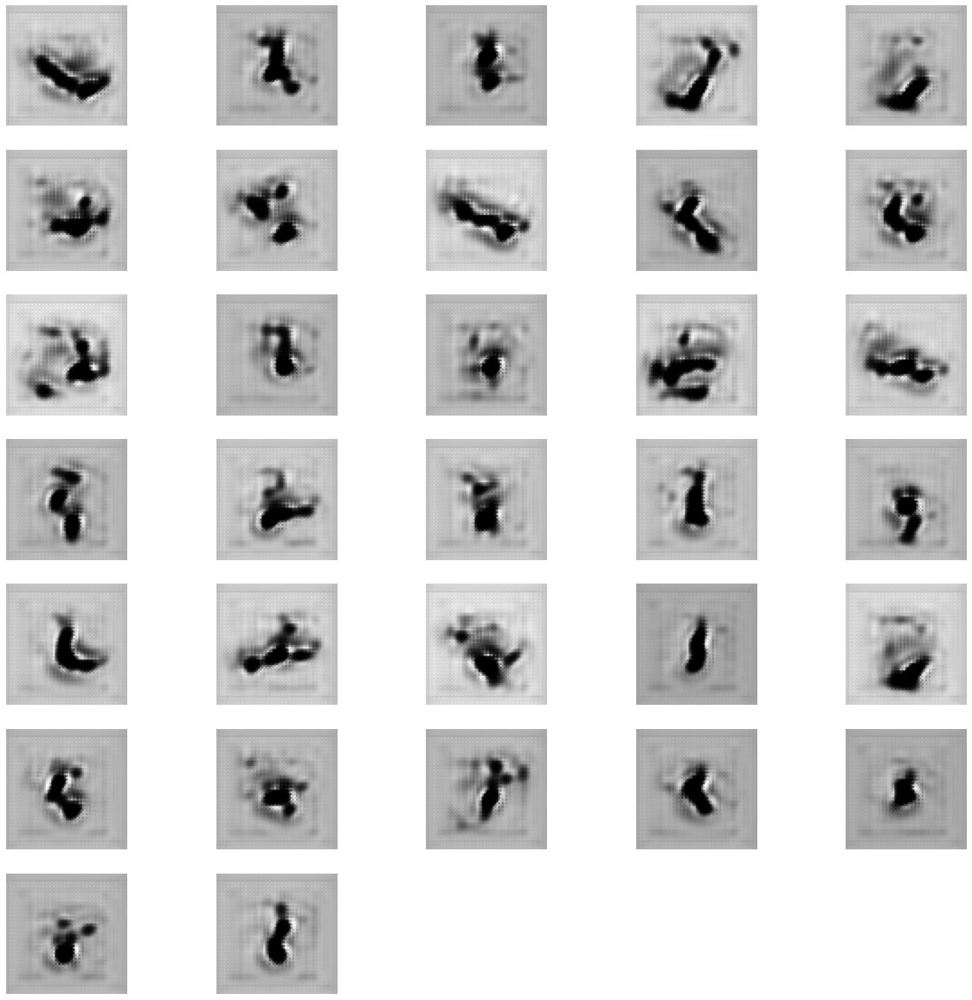

Epoch 1, Generator loss: 1.0773528814315796, discriminator loss: -0.1275365532686313


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


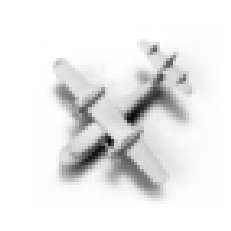

fake images


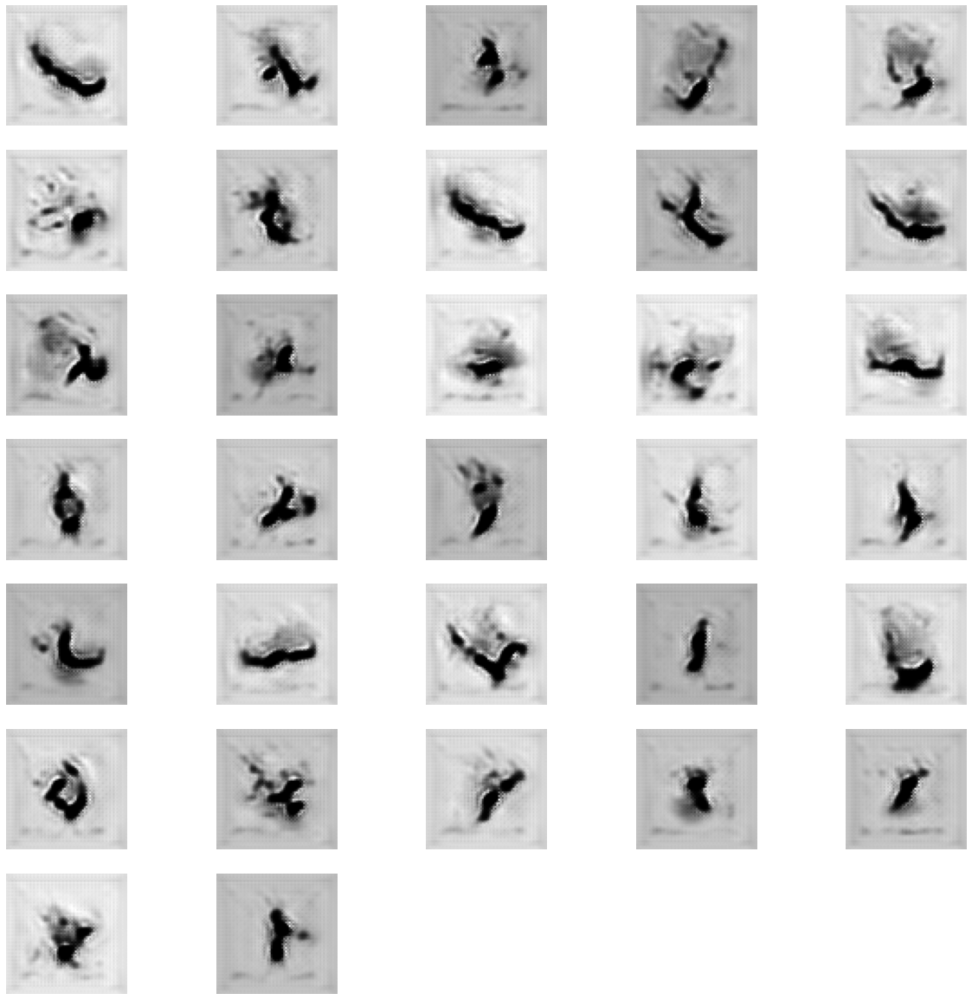

Epoch 2, Generator loss: 1.7451114654541016, discriminator loss: 0.13093495368957517


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


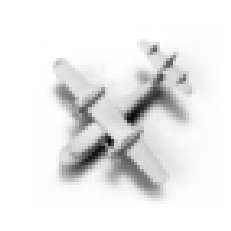

fake images


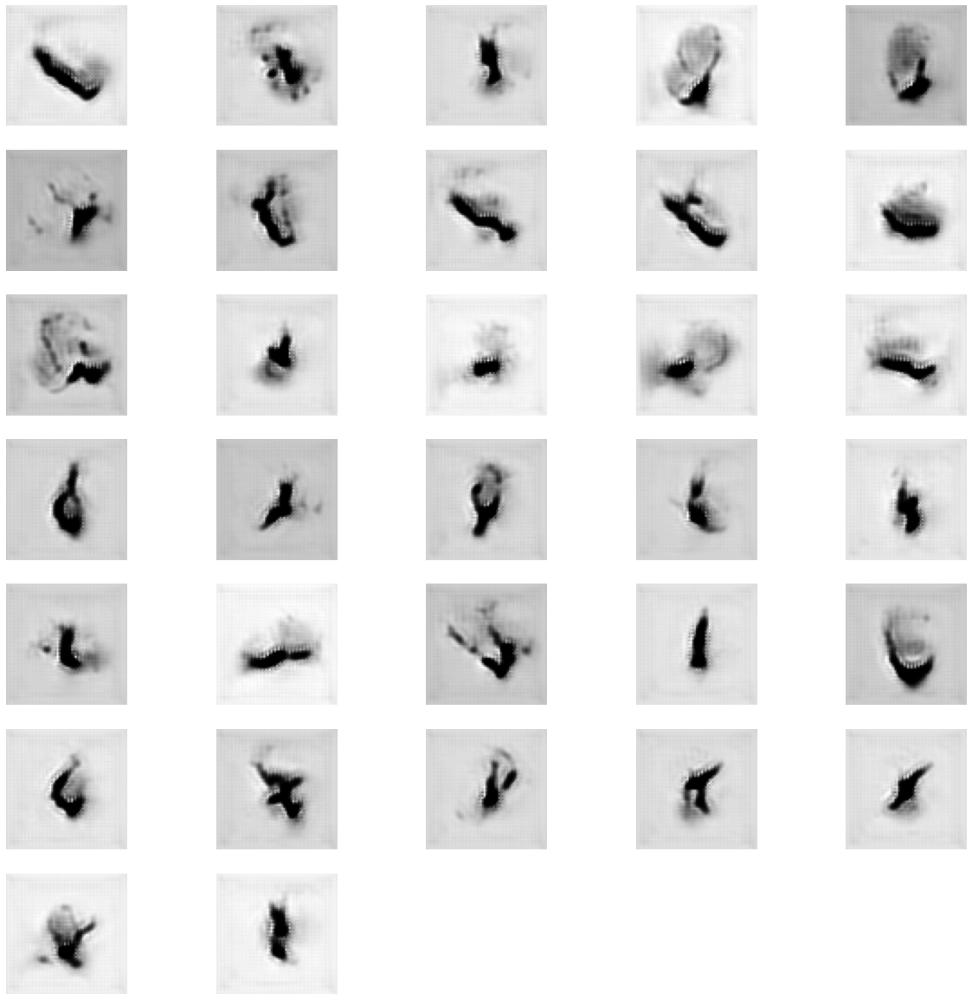

Epoch 3, Generator loss: 1.8183362483978271, discriminator loss: -0.7267077366511028


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


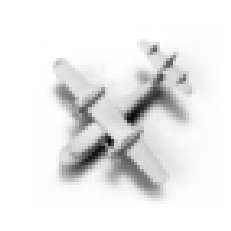

fake images


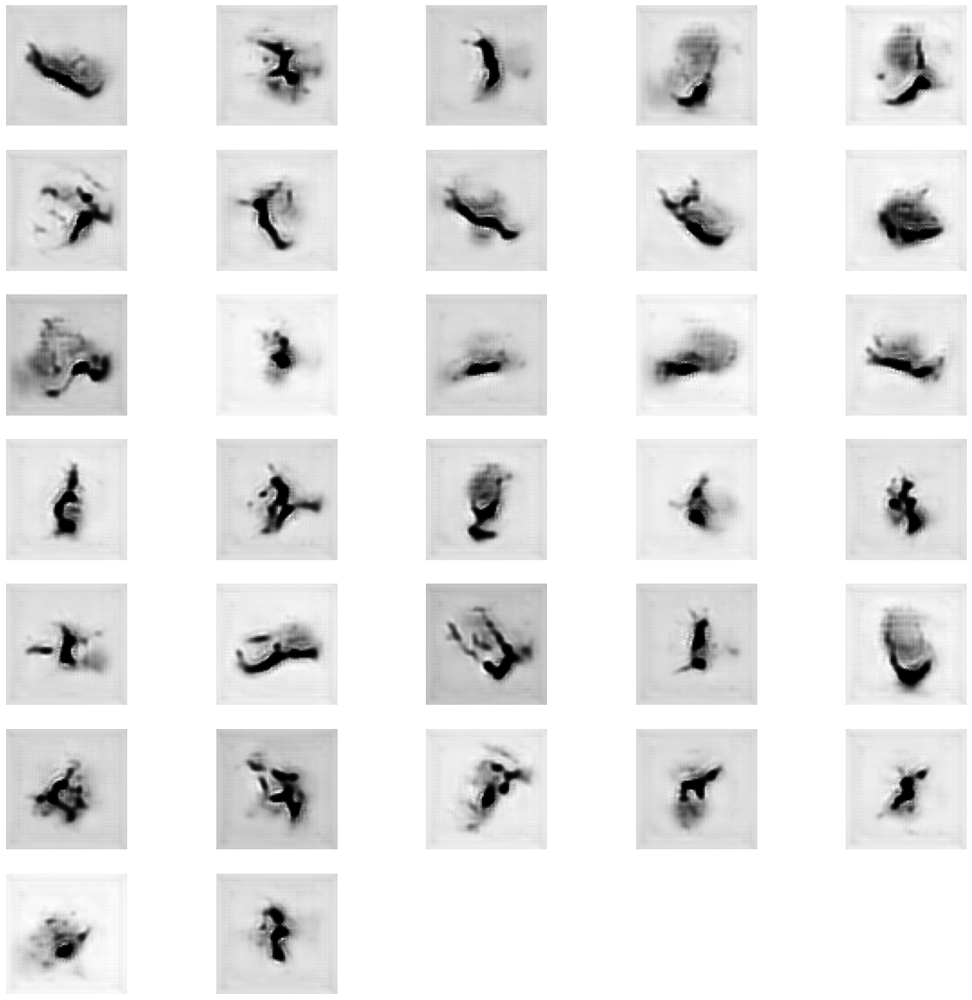

Epoch 4, Generator loss: 0.5618900060653687, discriminator loss: 0.6689864297707876


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


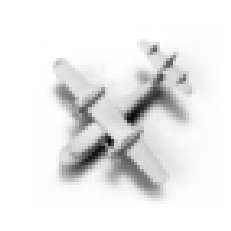

fake images


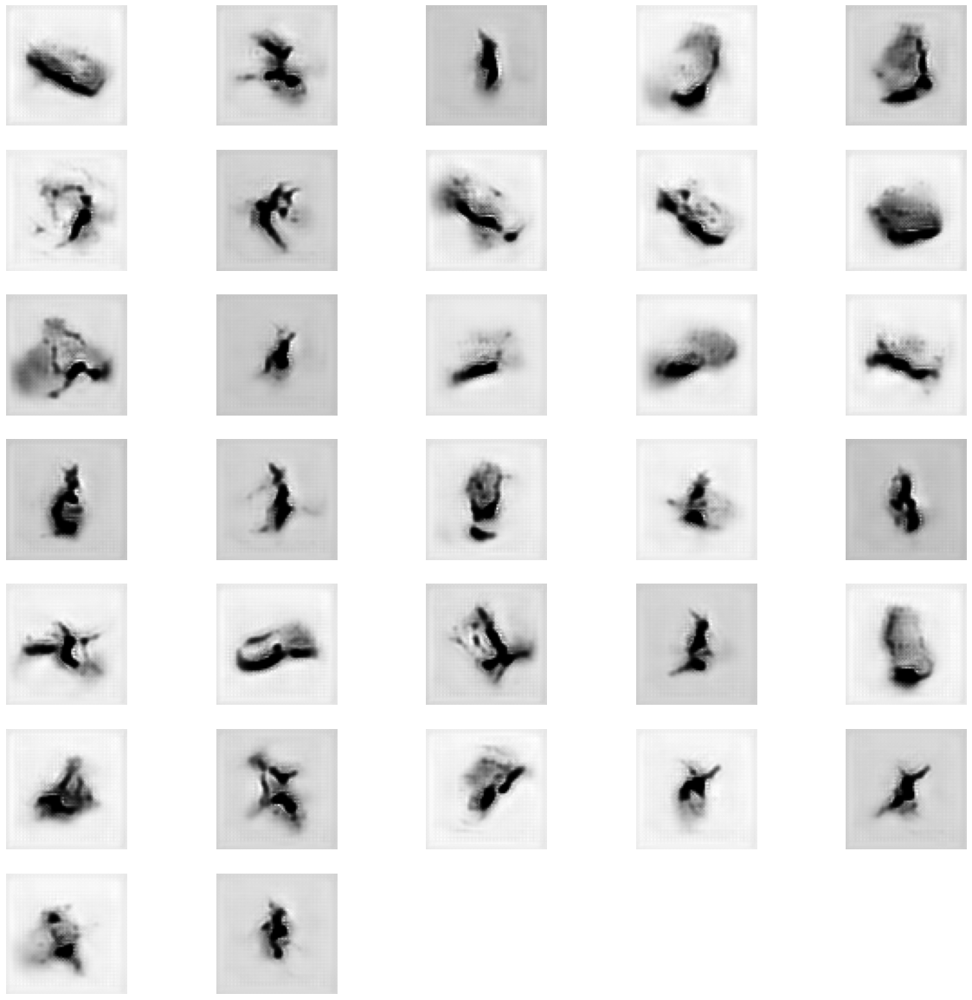

Epoch 5, Generator loss: 0.8311327695846558, discriminator loss: -0.24293179685870805


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


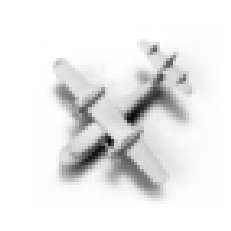

fake images


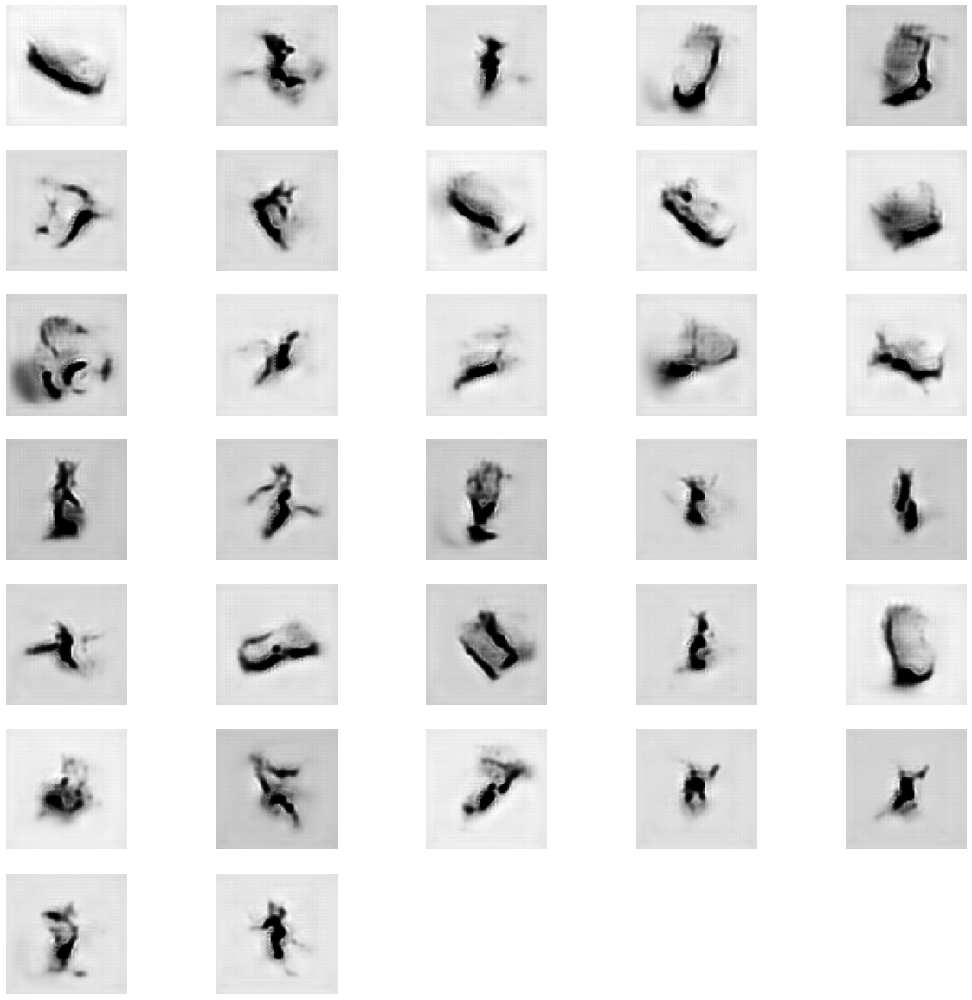

Epoch 6, Generator loss: 1.3626741170883179, discriminator loss: 0.07419935365517932


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


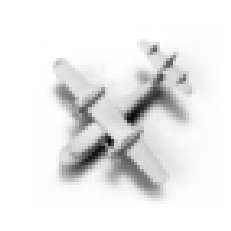

fake images


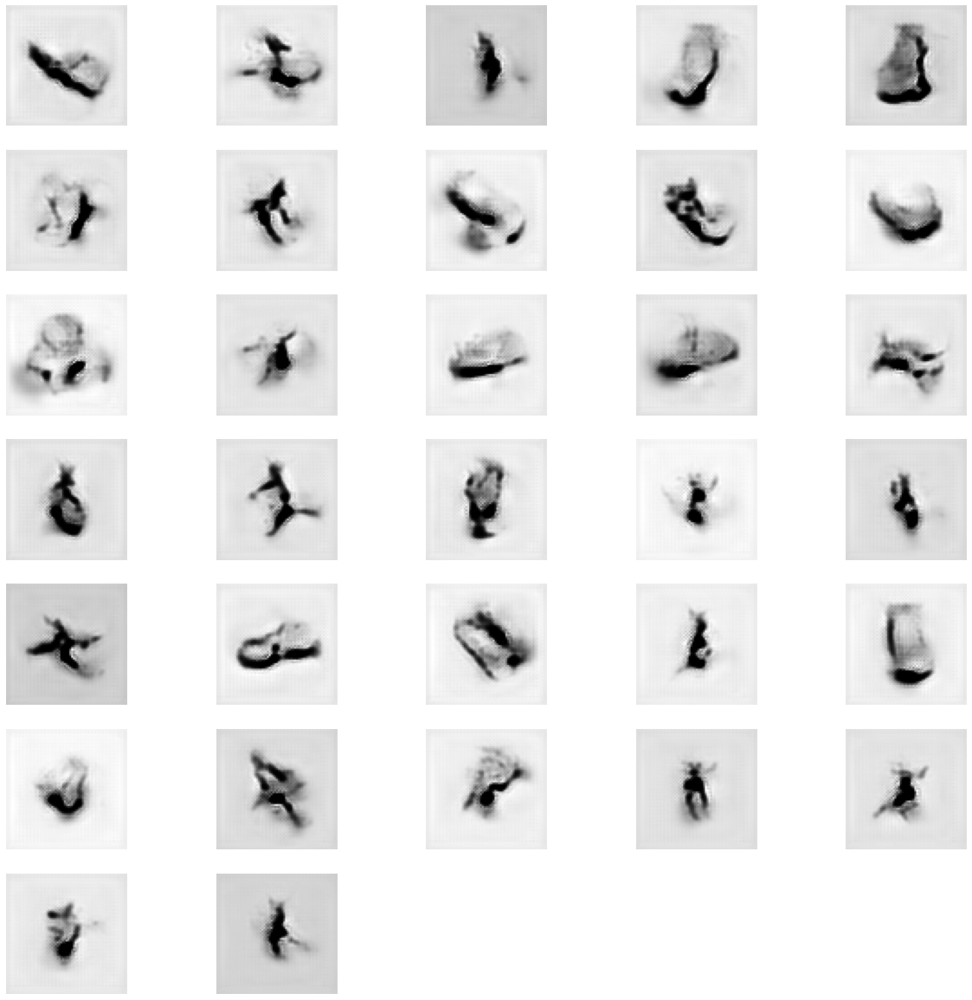

Epoch 7, Generator loss: 1.2300312519073486, discriminator loss: 0.11443824569384257


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


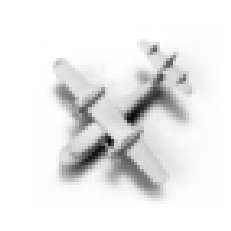

fake images


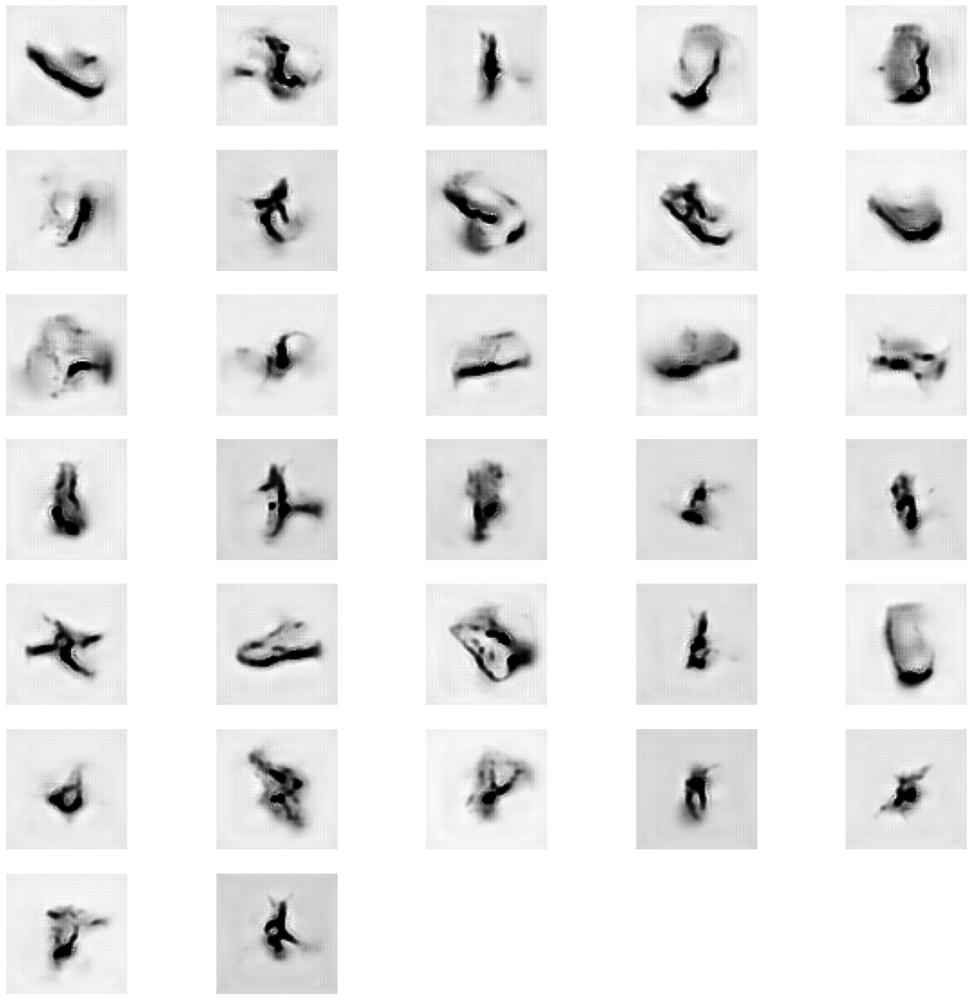

Epoch 8, Generator loss: 0.8116714954376221, discriminator loss: 0.14227510492006937


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


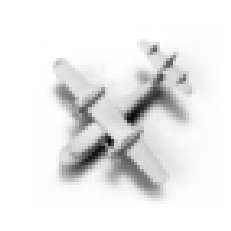

fake images


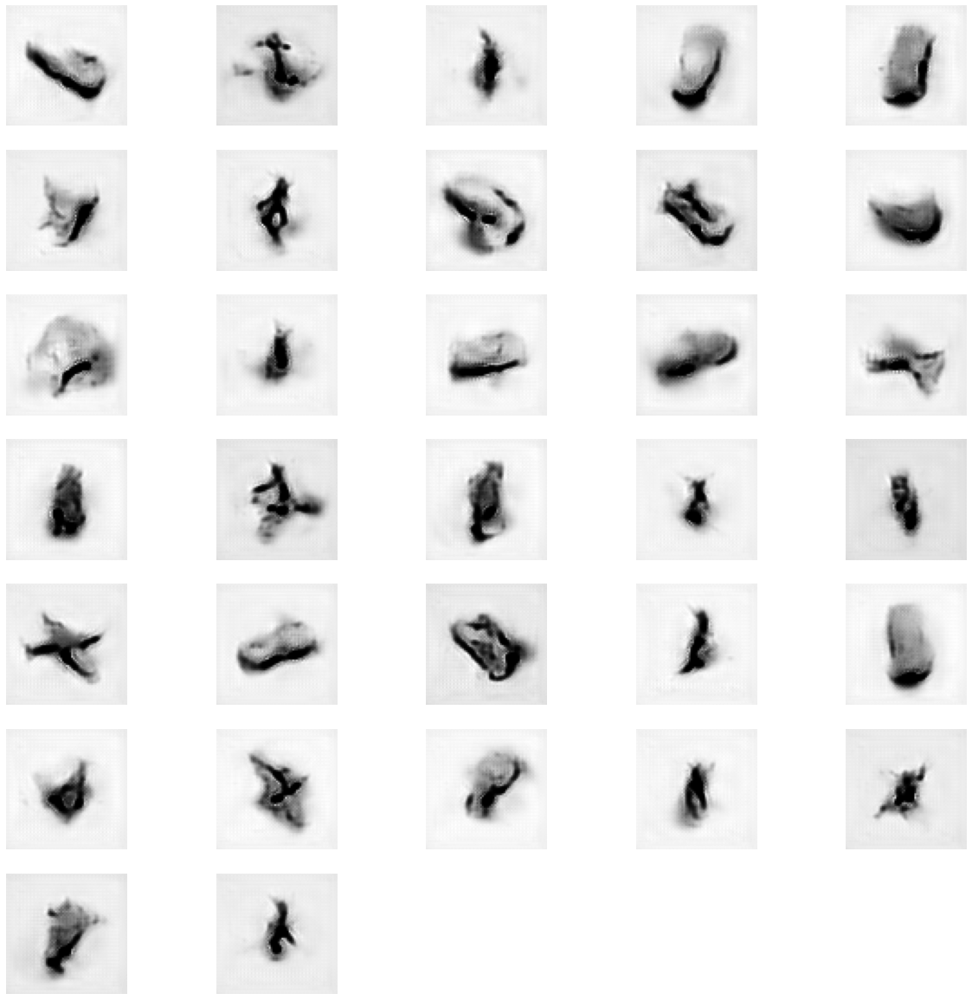

Epoch 9, Generator loss: 0.5666358470916748, discriminator loss: -0.046114916602770506


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


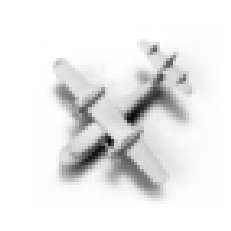

fake images


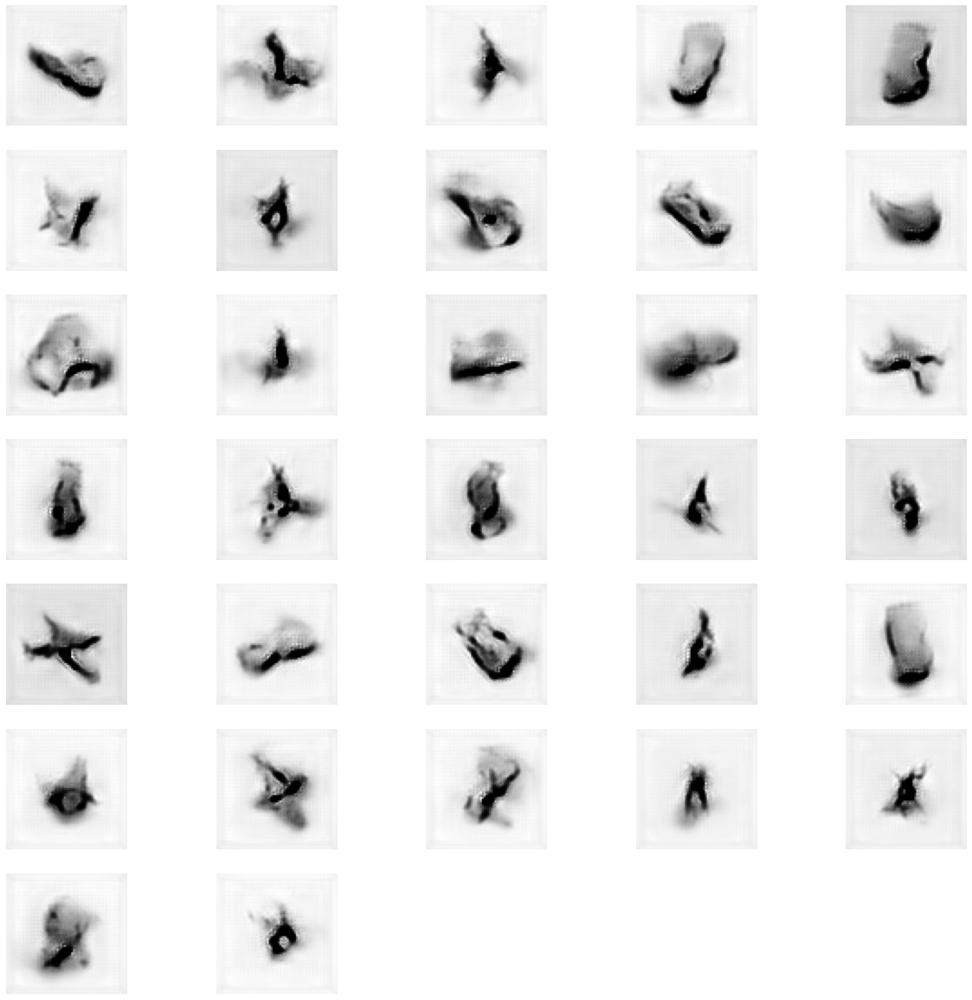

Epoch 10, Generator loss: 0.8172092437744141, discriminator loss: -0.014328089853127793


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


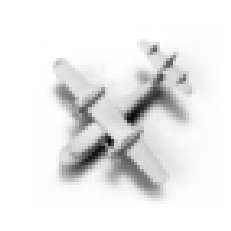

fake images


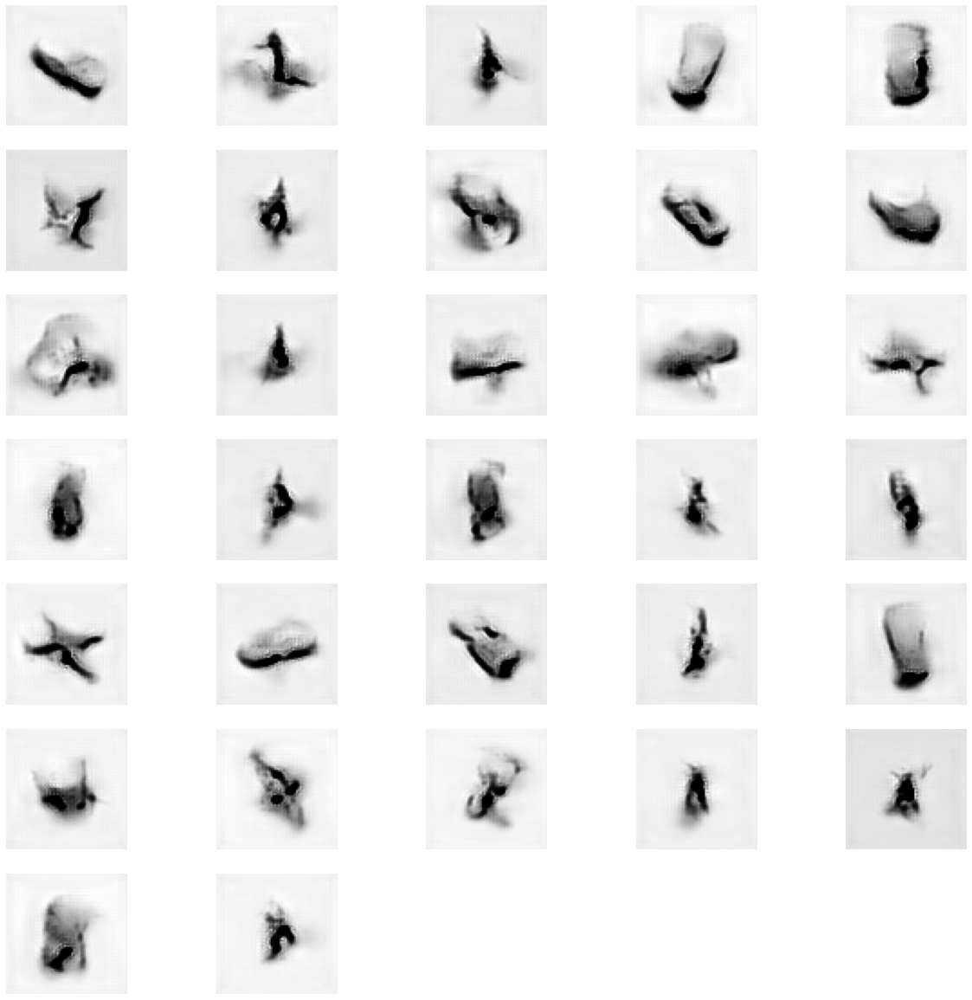

Epoch 11, Generator loss: 0.8483262062072754, discriminator loss: 0.1555907262954861


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


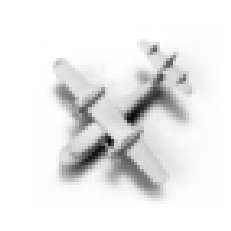

fake images


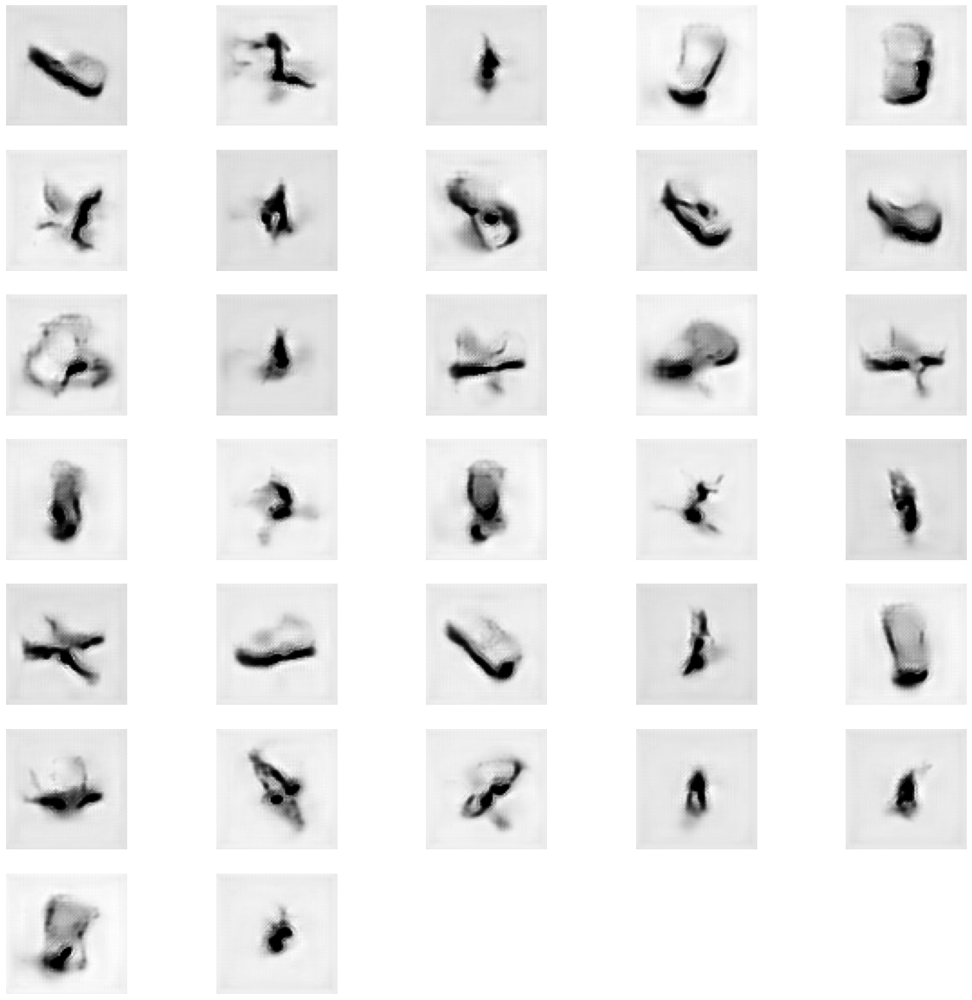

Epoch 12, Generator loss: 0.863109290599823, discriminator loss: -0.1726474737127622


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


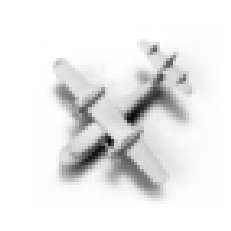

fake images


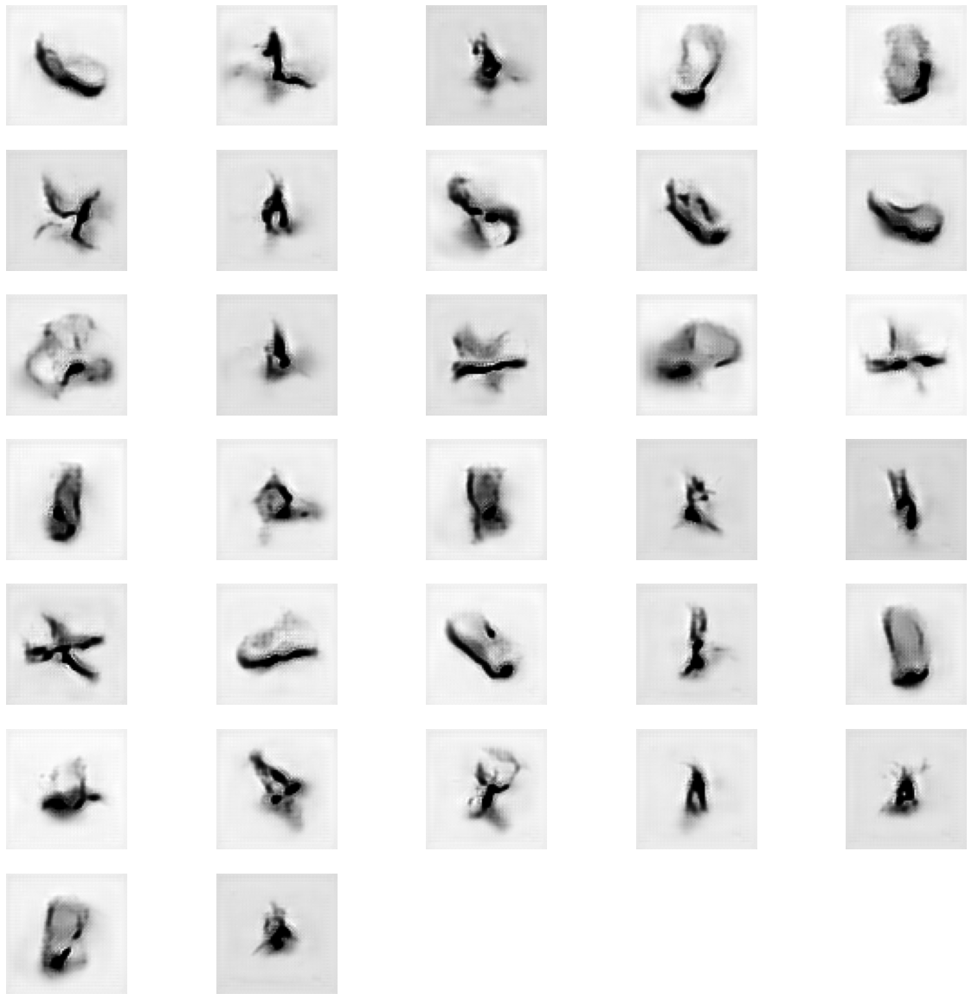

Epoch 13, Generator loss: 0.5331699848175049, discriminator loss: -0.15195626641313237


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


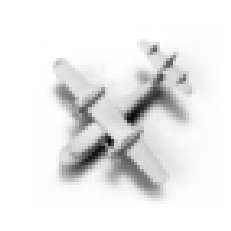

fake images


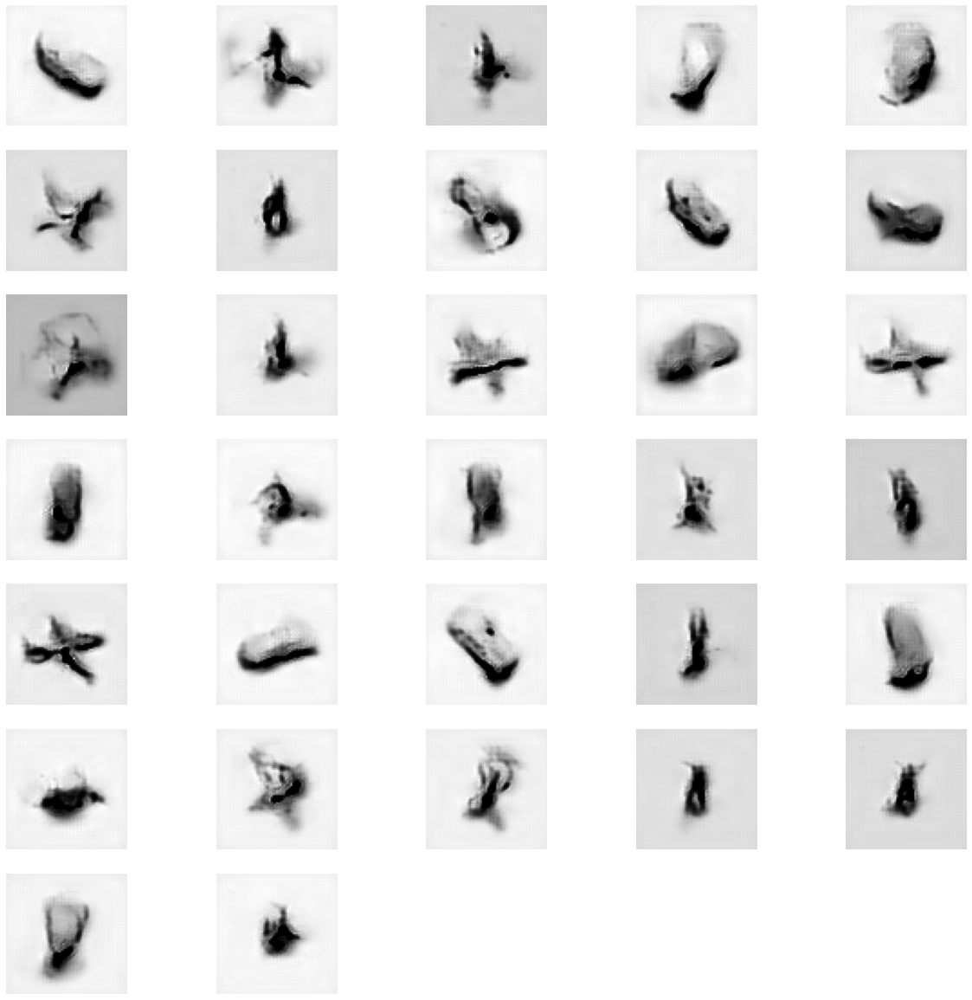

Epoch 14, Generator loss: 0.47671863436698914, discriminator loss: -0.11047814786434174


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


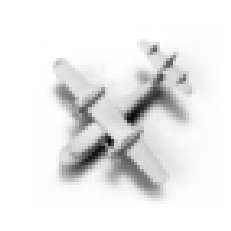

fake images


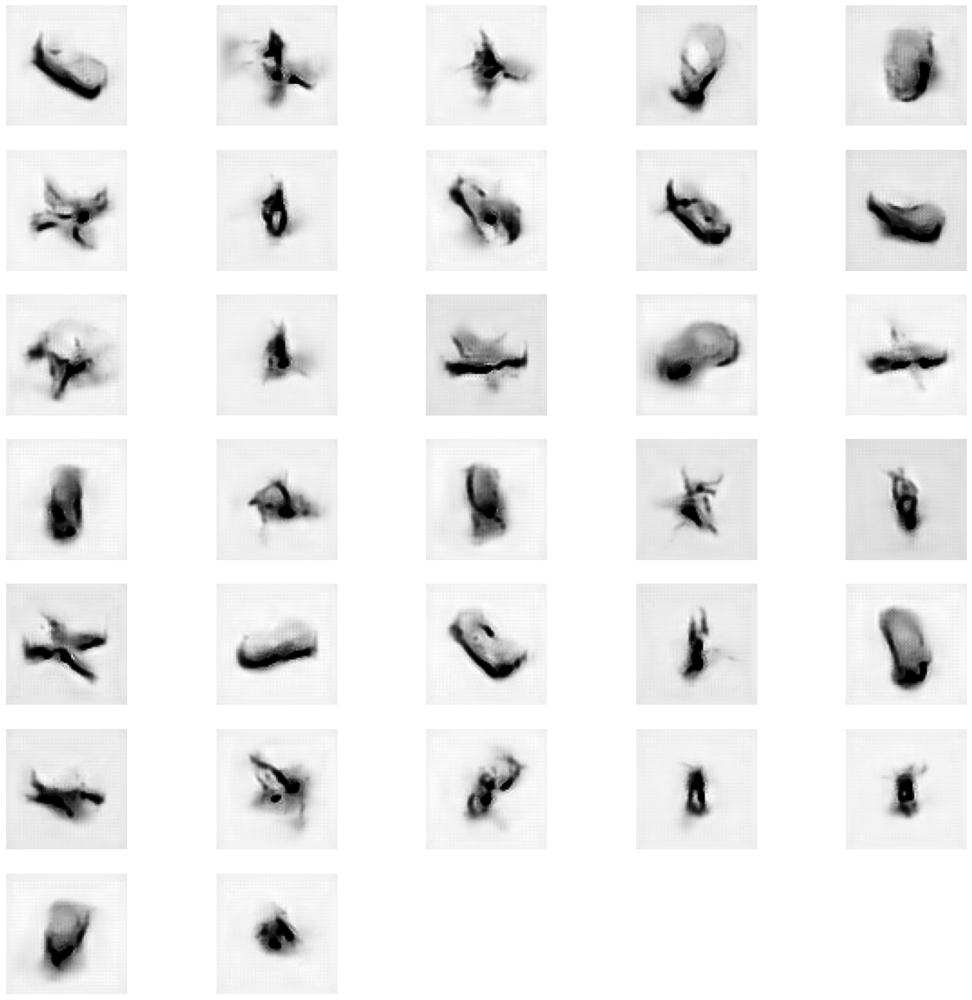

Epoch 15, Generator loss: 0.6933293342590332, discriminator loss: 0.0036545395851135254


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


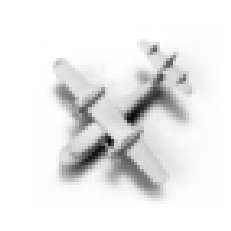

fake images


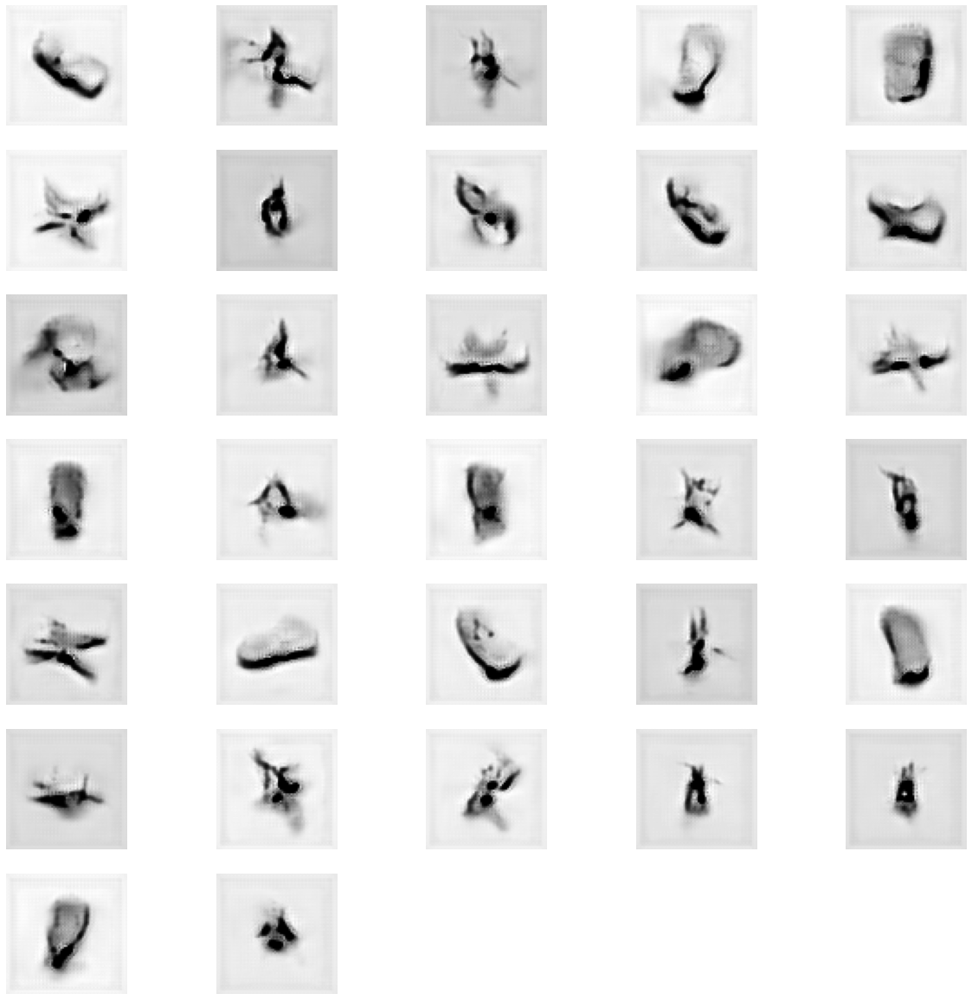

Epoch 16, Generator loss: 0.9289392232894897, discriminator loss: -0.09470933303236961


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


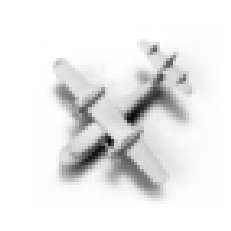

fake images


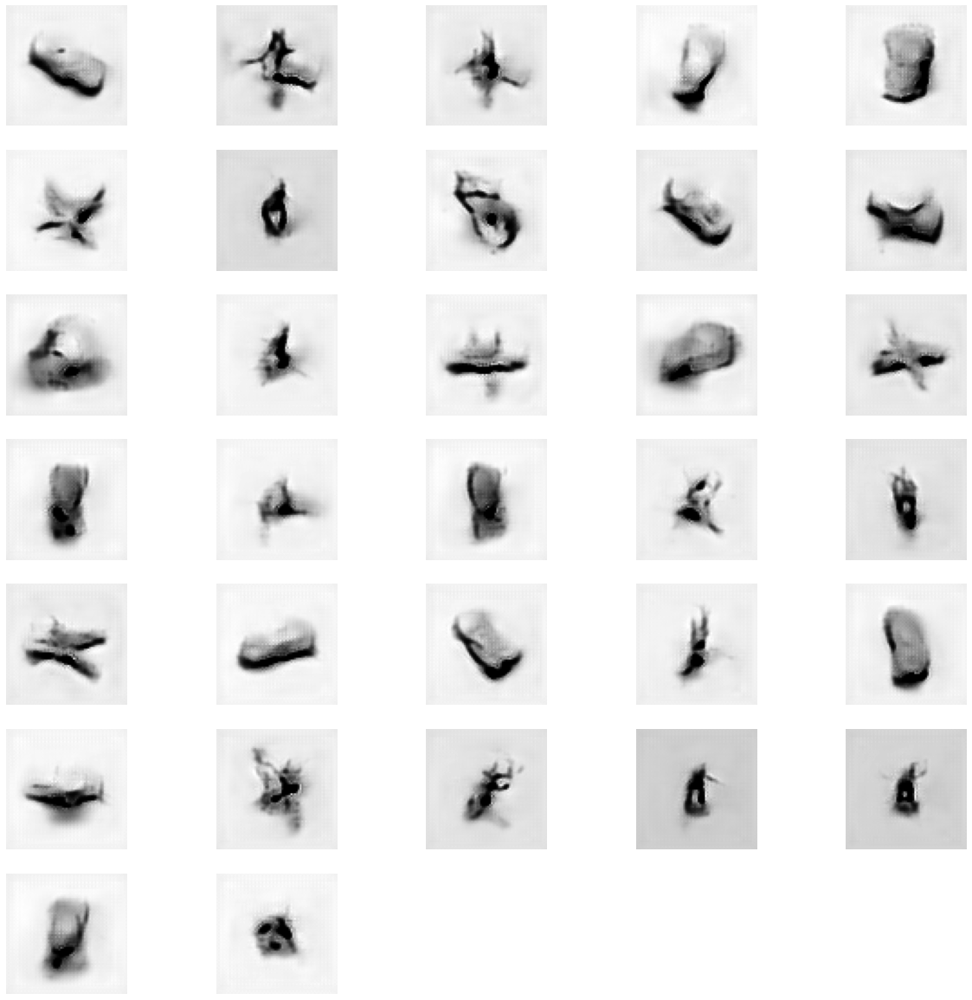

Epoch 17, Generator loss: 0.6888144016265869, discriminator loss: -0.10696763048569362


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


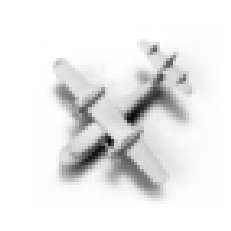

fake images


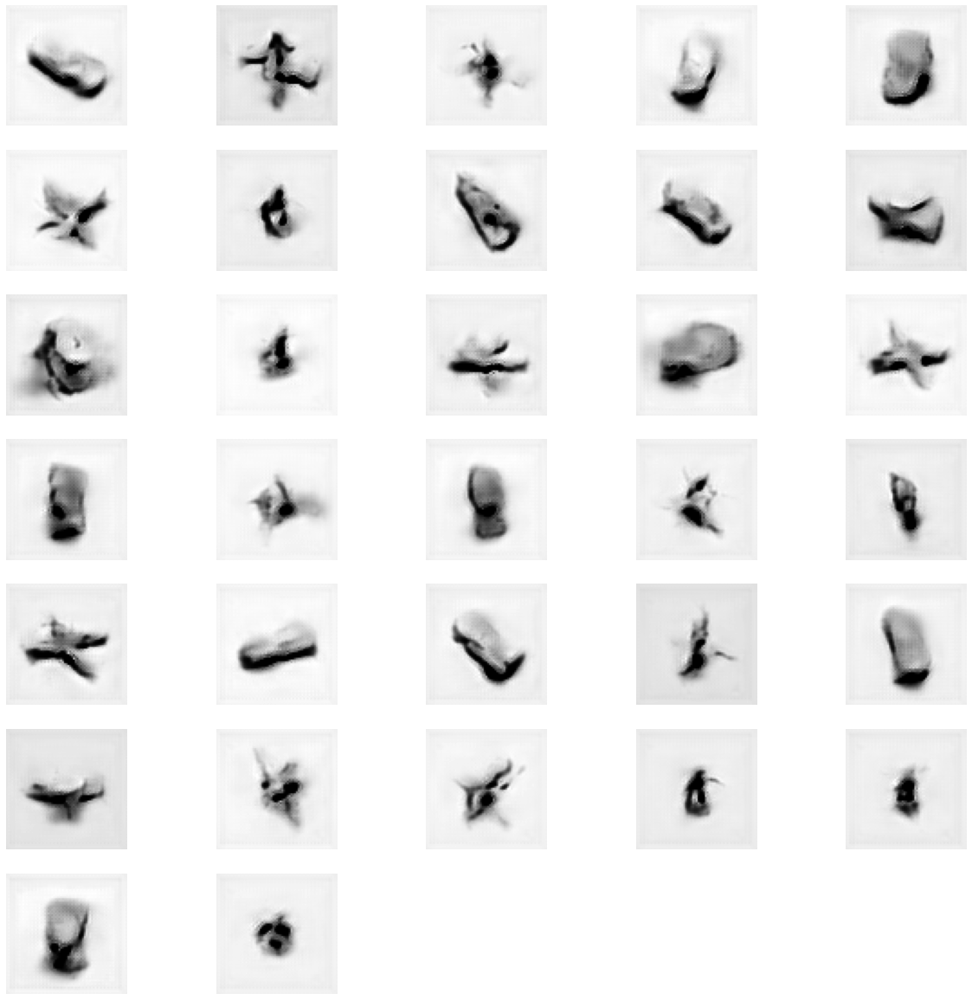

Epoch 18, Generator loss: 0.6951414942741394, discriminator loss: -0.021679212649663278


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


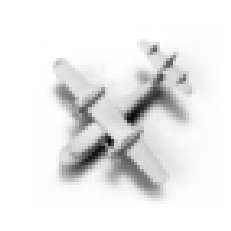

fake images


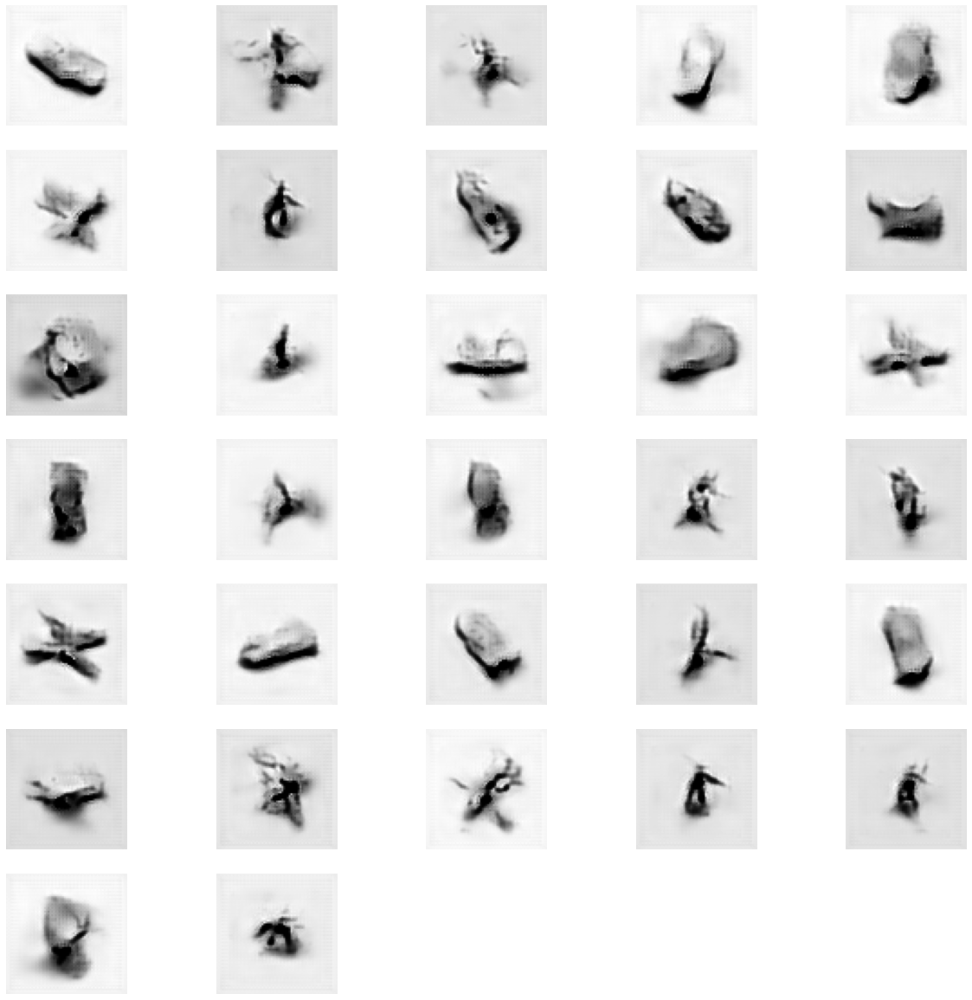

Epoch 19, Generator loss: 1.452930212020874, discriminator loss: 0.07304507990678152


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


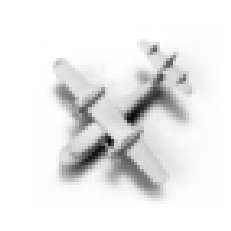

fake images


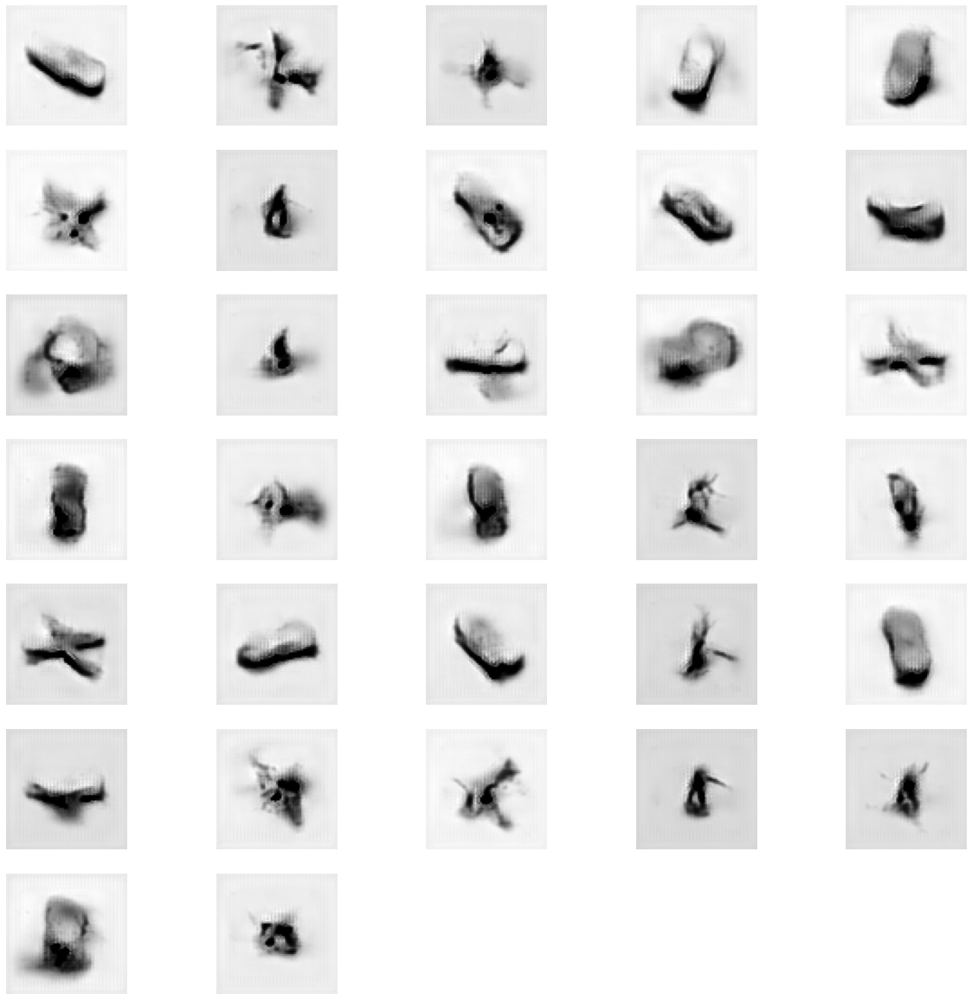

Epoch 20, Generator loss: 1.2794444561004639, discriminator loss: -0.41080118219057715


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


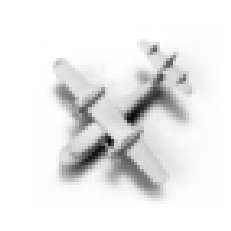

fake images


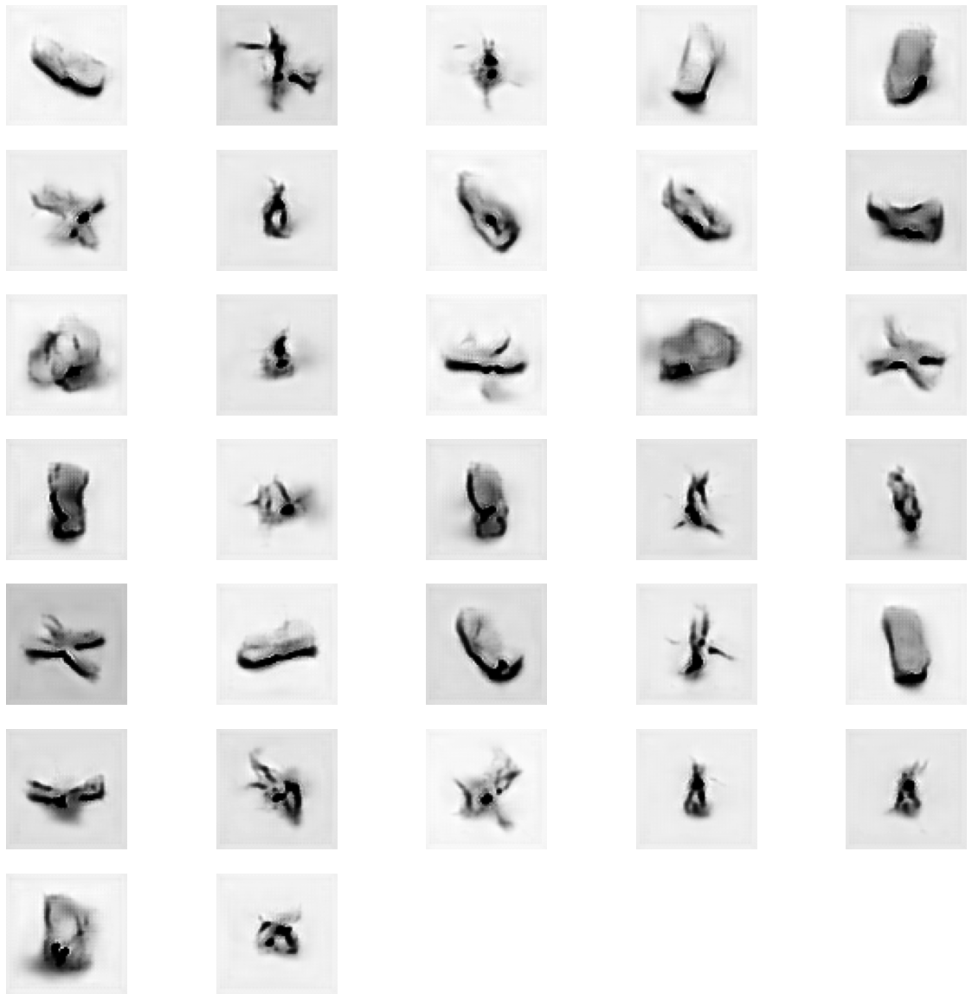

Epoch 21, Generator loss: 0.7488295435905457, discriminator loss: 0.006157919764518738


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


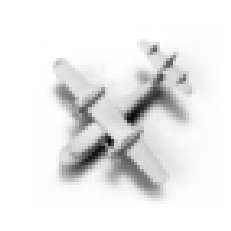

fake images


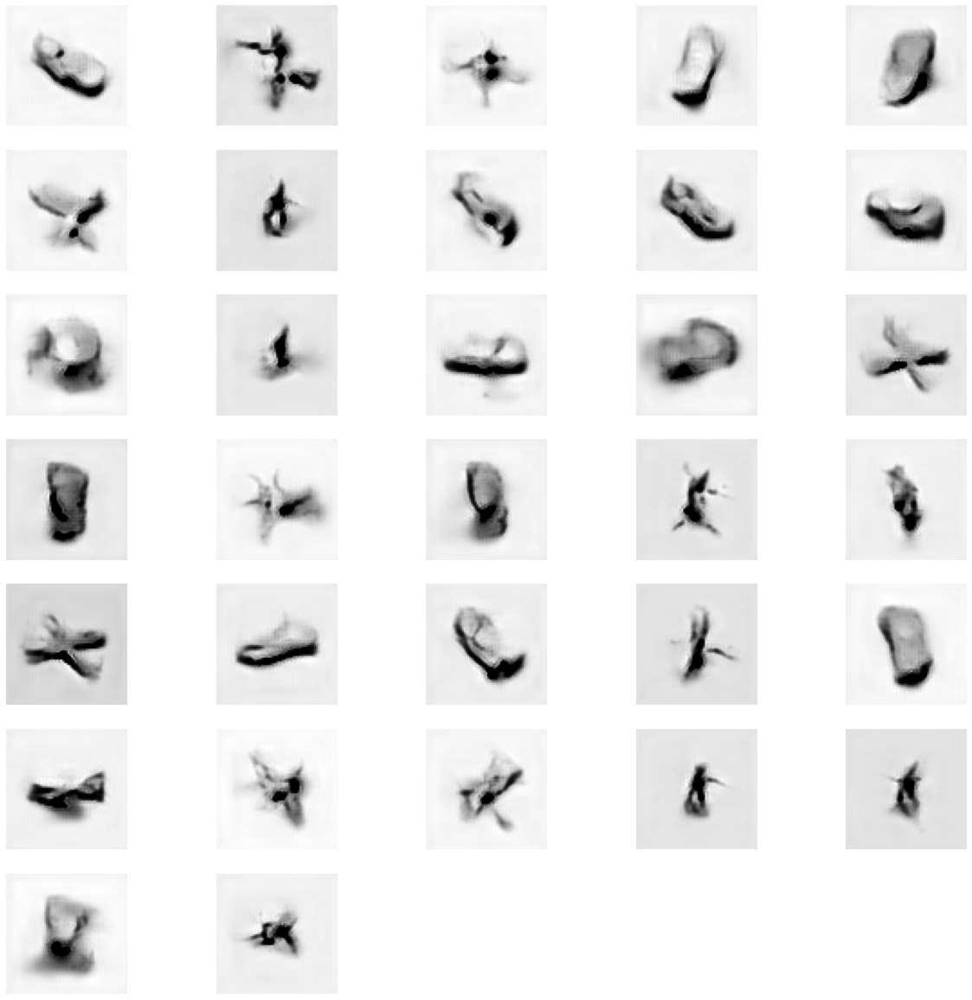

Epoch 22, Generator loss: 0.9233660697937012, discriminator loss: -0.1030627079308033


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


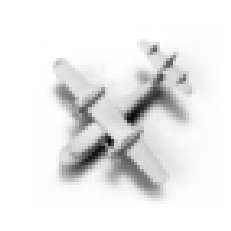

fake images


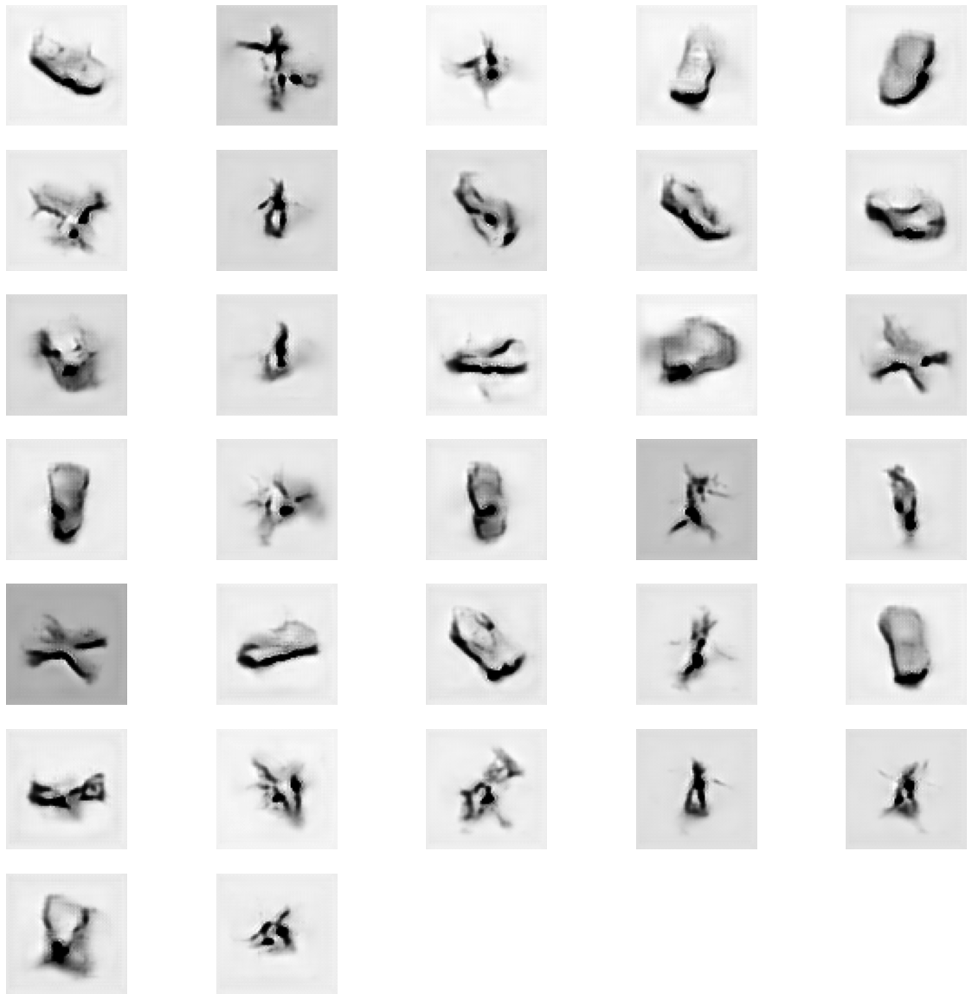

Epoch 23, Generator loss: 0.9882544279098511, discriminator loss: 0.099520410100619


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


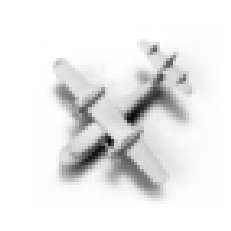

fake images


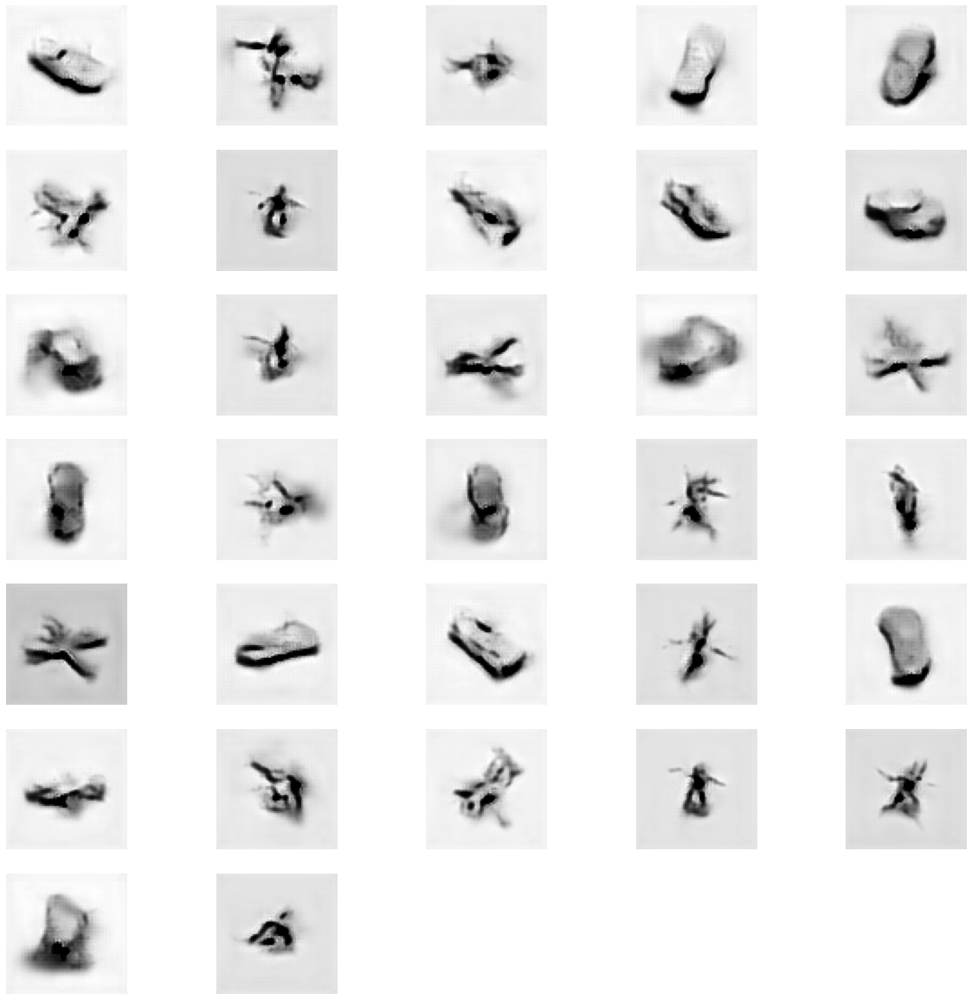

Epoch 24, Generator loss: 0.7589144706726074, discriminator loss: 0.012995608150959029


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


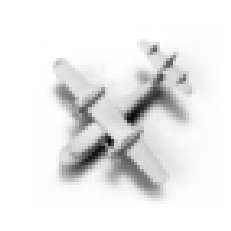

fake images


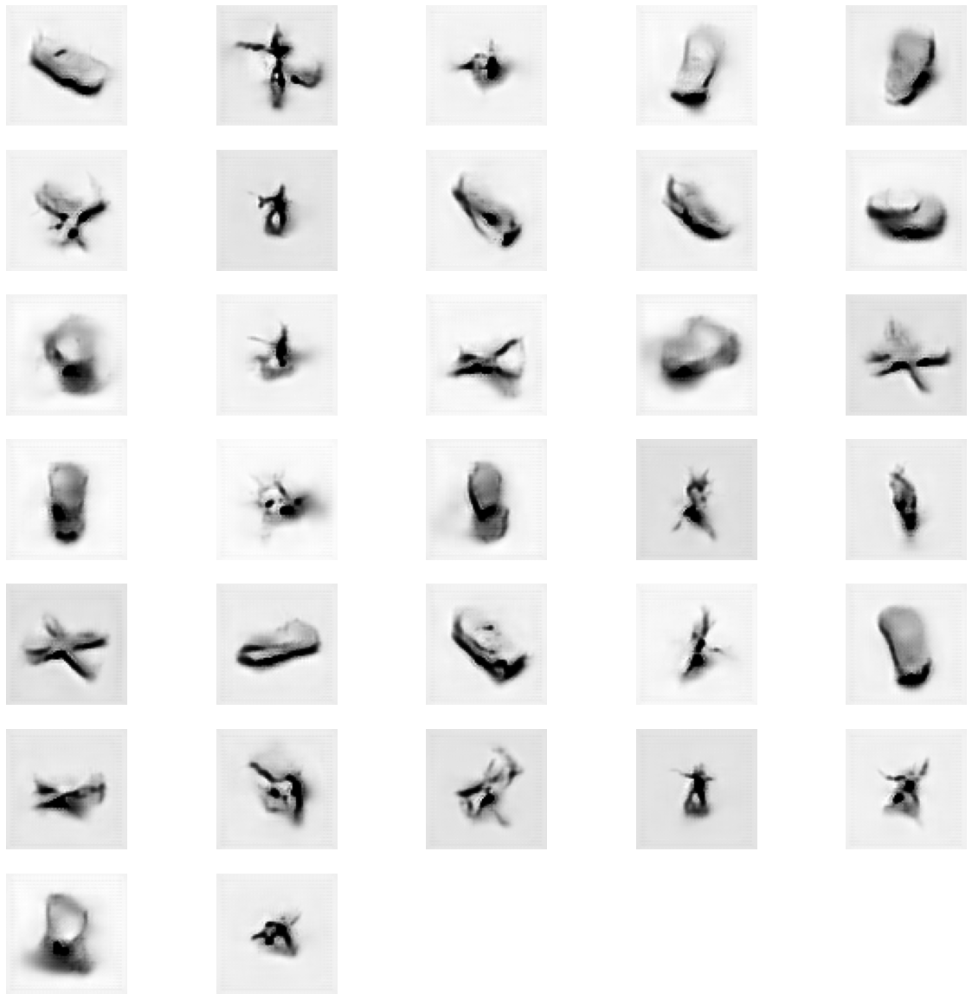

Epoch 25, Generator loss: 0.6204038858413696, discriminator loss: -0.013595432043075562


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


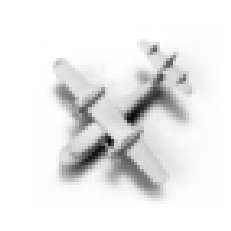

fake images


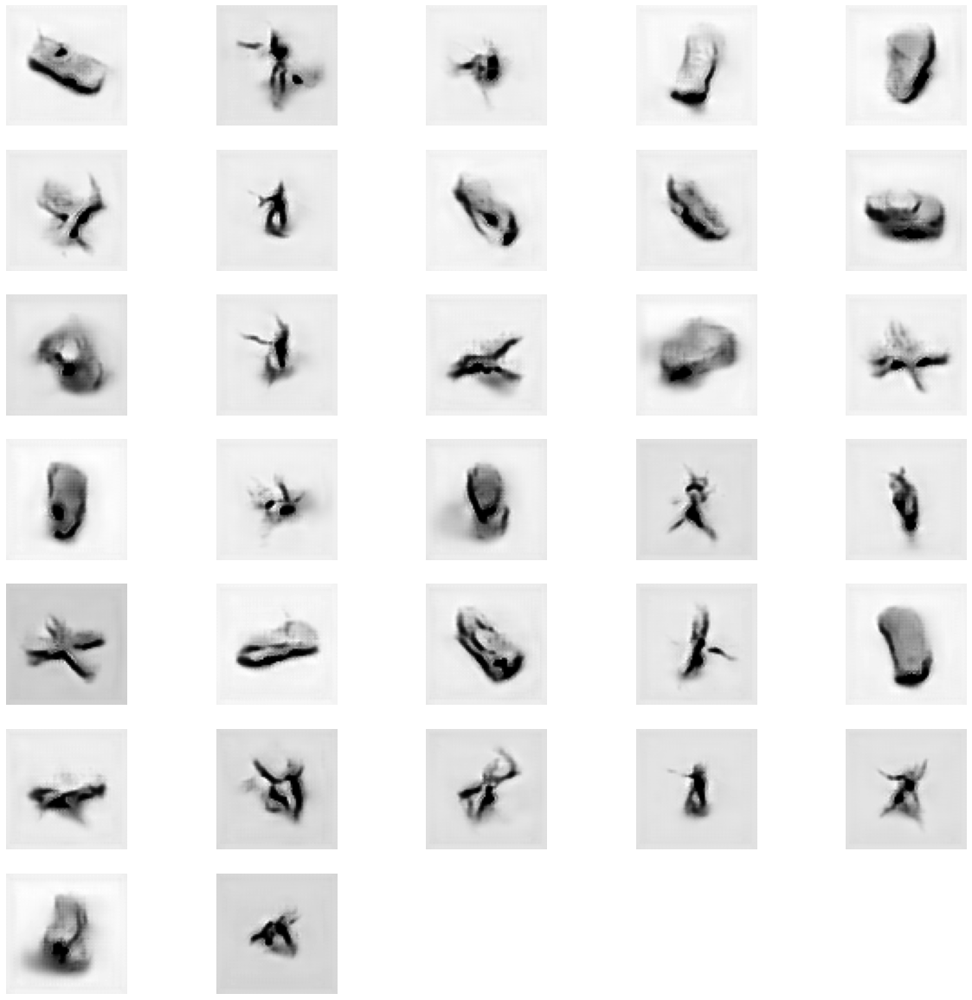

Epoch 26, Generator loss: 1.1968554258346558, discriminator loss: -0.14398376022775966


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


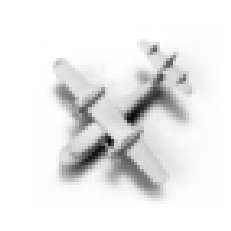

fake images


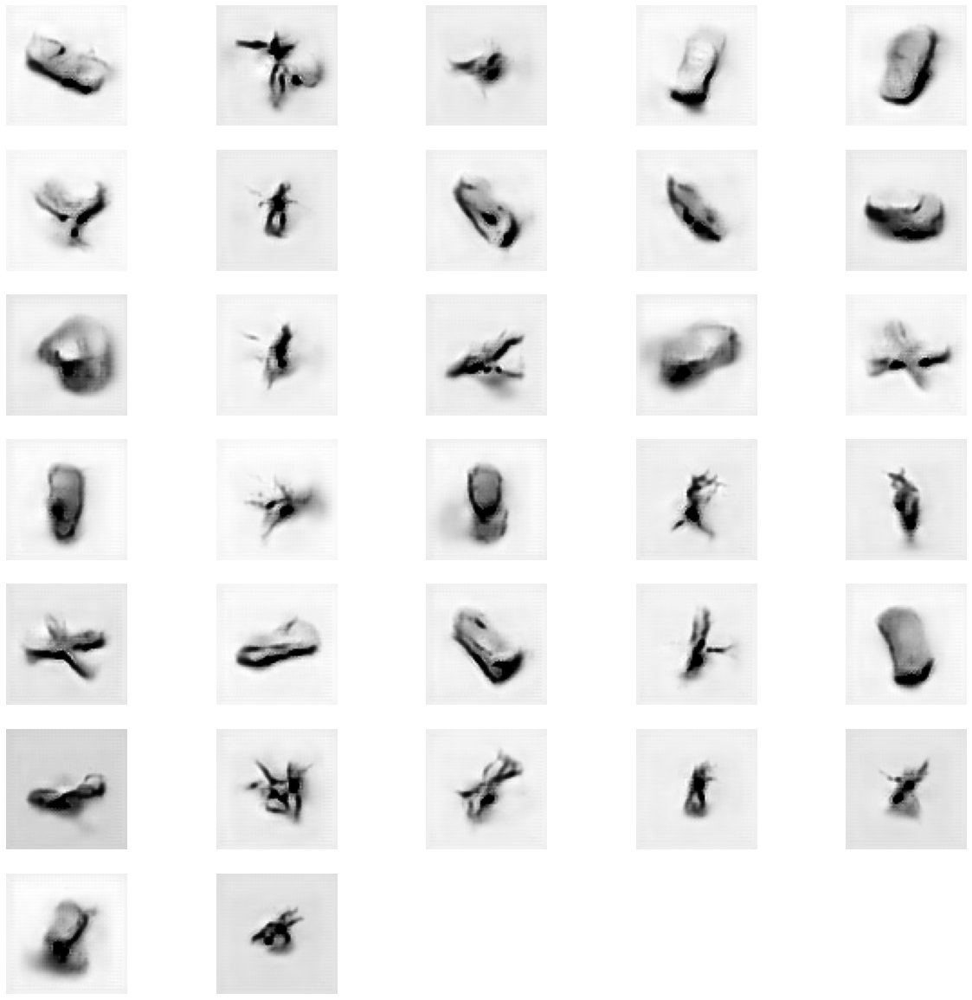

Epoch 27, Generator loss: 0.39089903235435486, discriminator loss: 0.5017203092575073


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


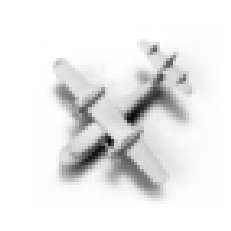

fake images


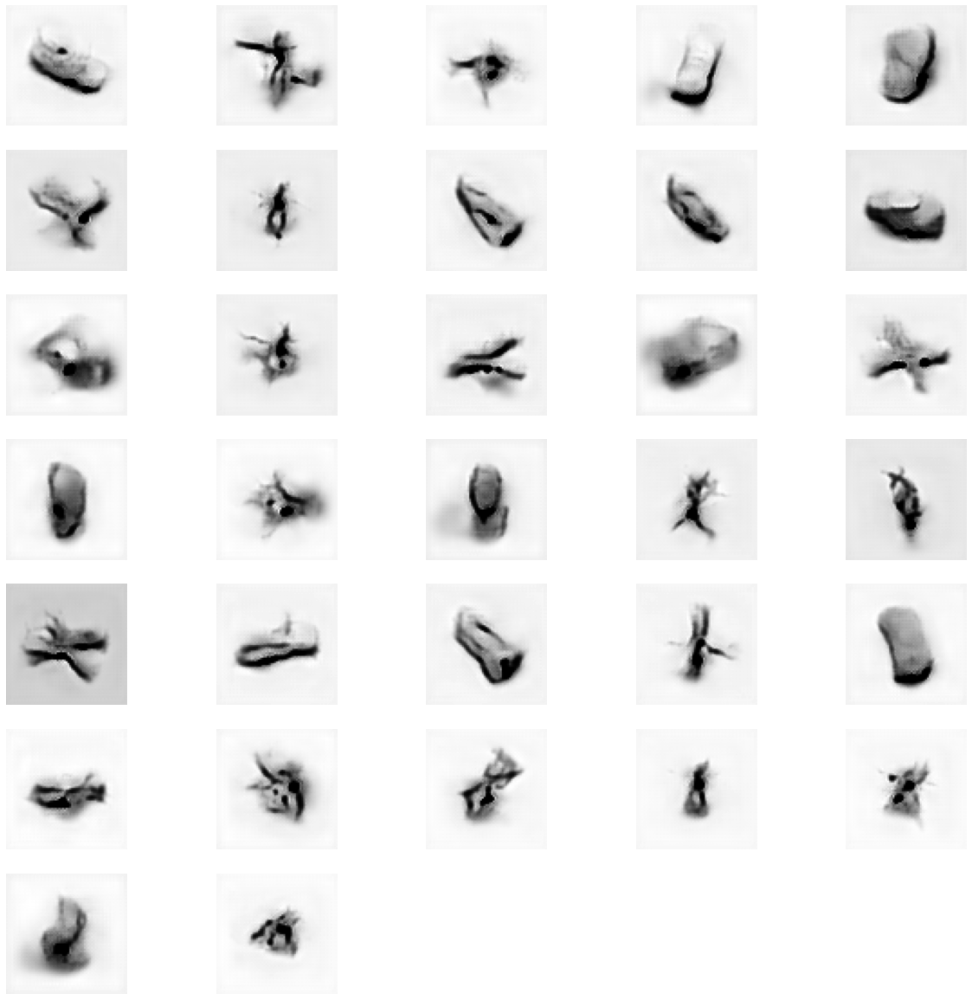

Epoch 28, Generator loss: 0.70157790184021, discriminator loss: -0.2234509744060536


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


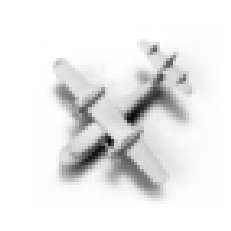

fake images


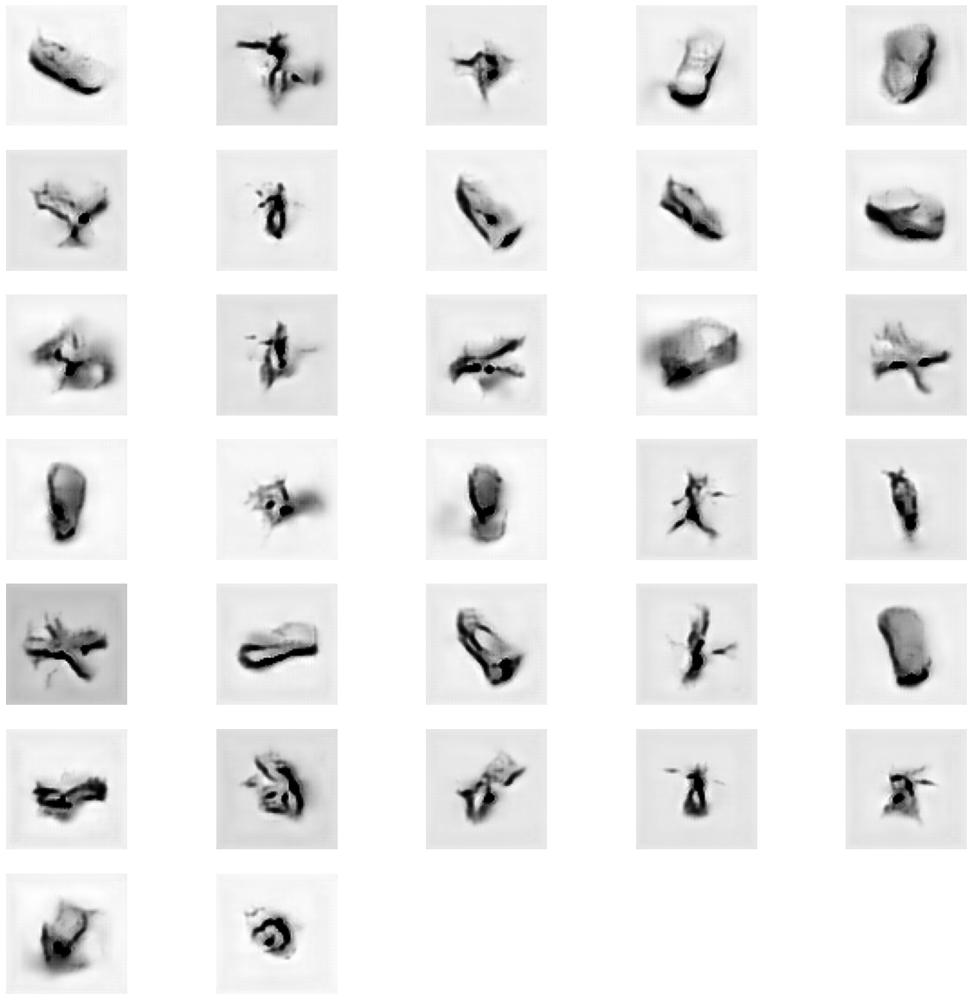

Epoch 29, Generator loss: 0.22583094239234924, discriminator loss: -0.06534914920727411


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


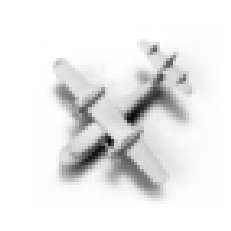

fake images


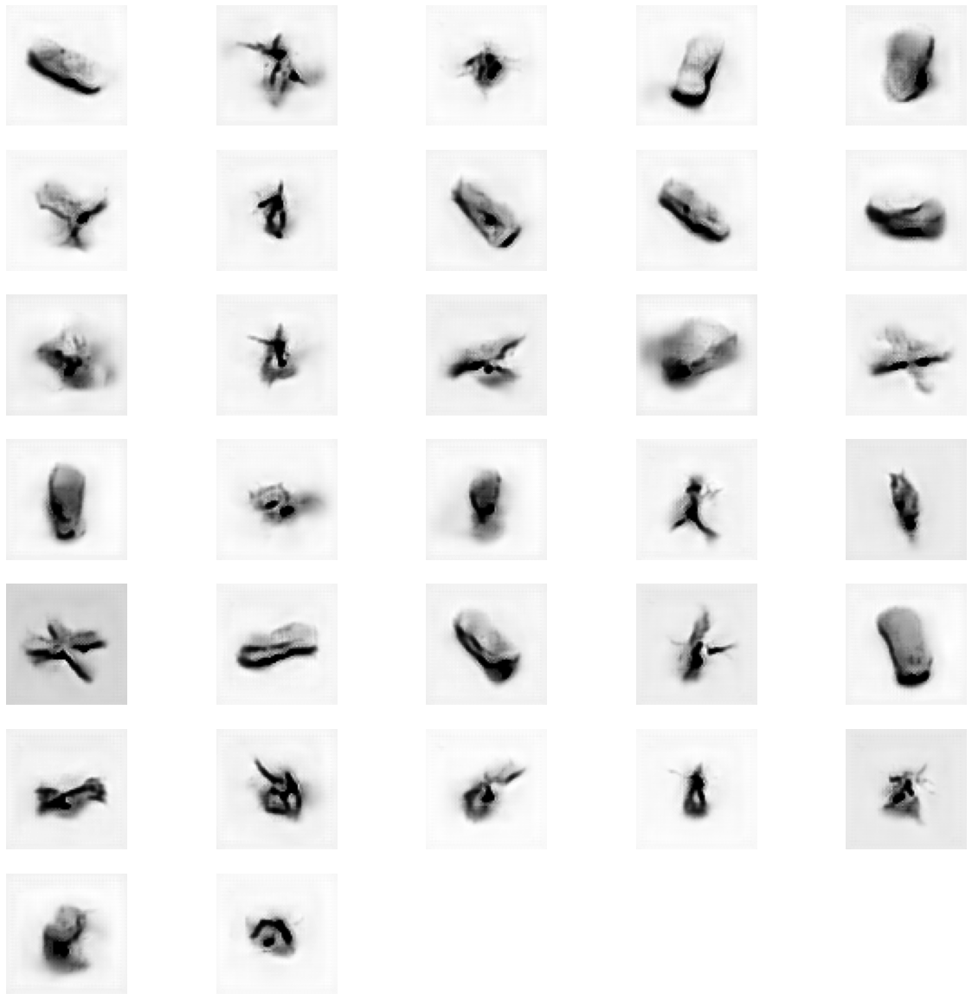

Epoch 30, Generator loss: 0.8645316958427429, discriminator loss: -0.1874321798483531


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


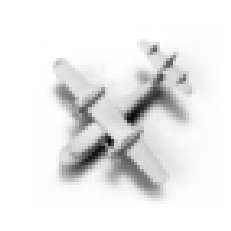

fake images


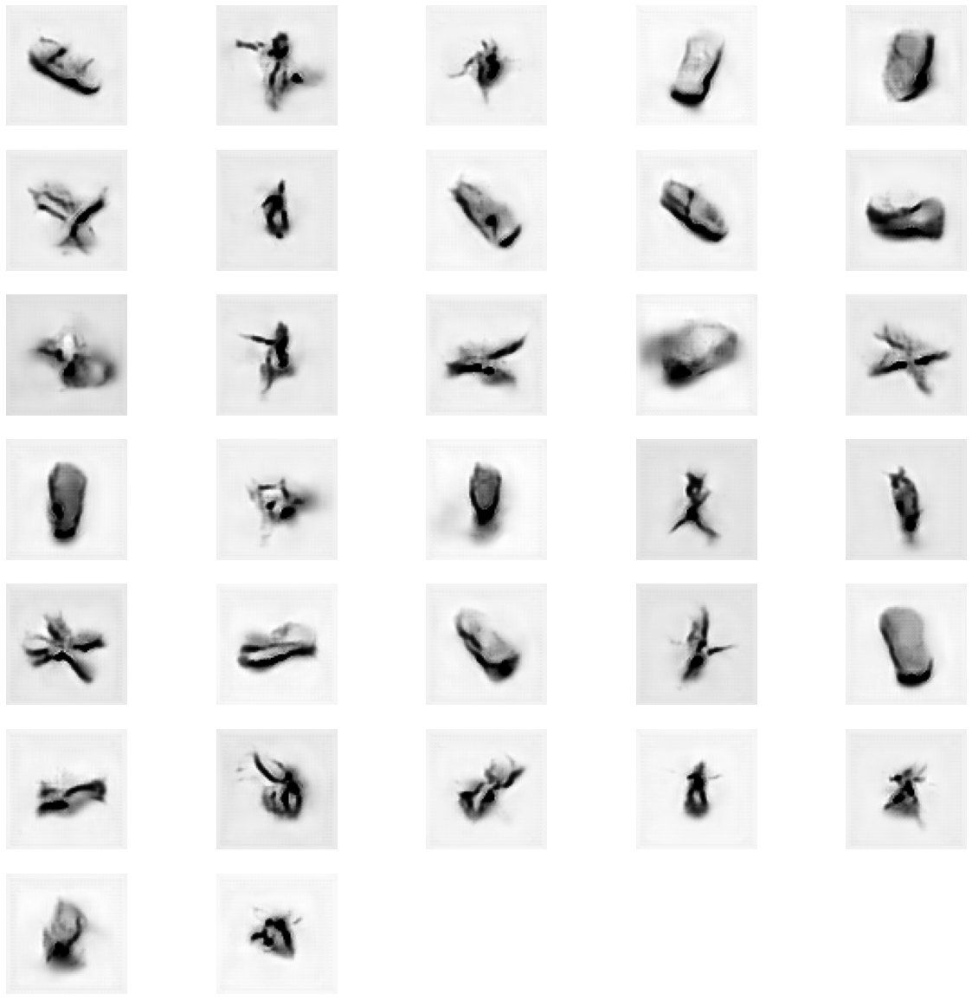

Epoch 31, Generator loss: 0.5291958451271057, discriminator loss: 0.5877180298169454


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


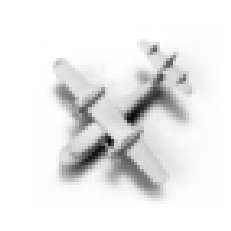

fake images


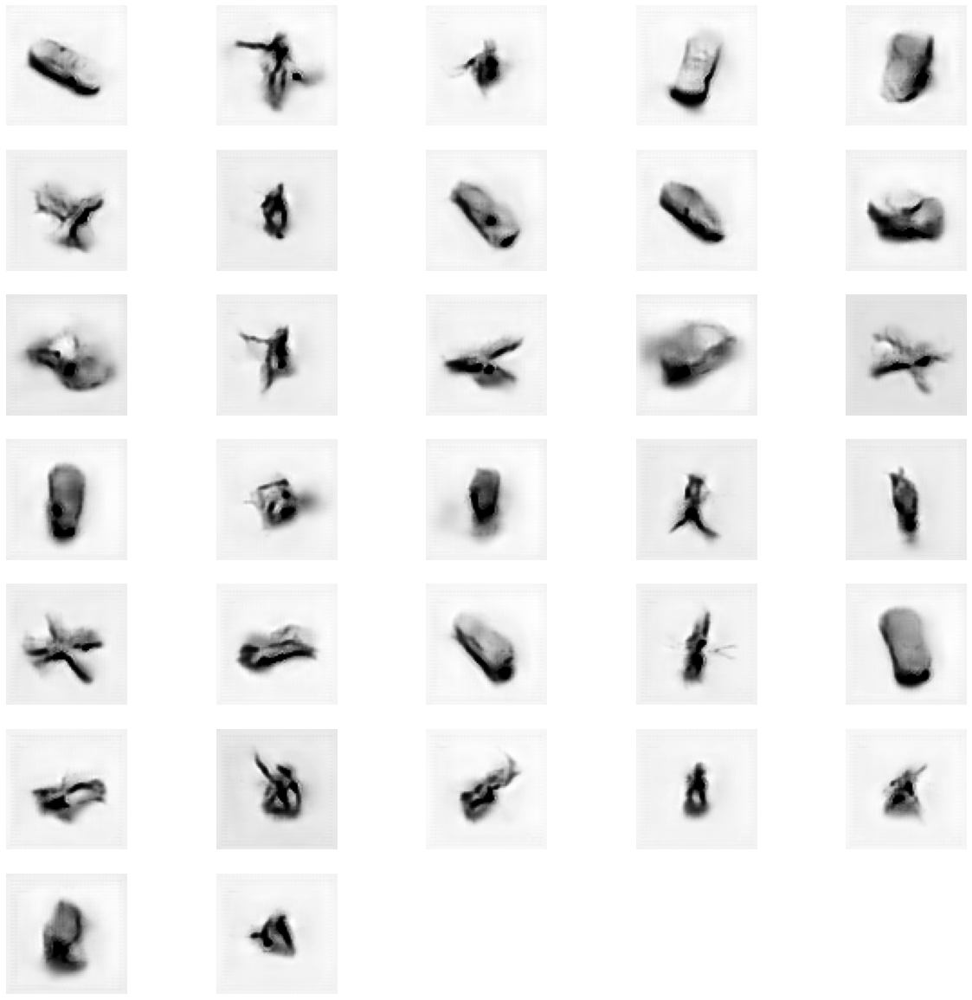

Epoch 32, Generator loss: 0.42704981565475464, discriminator loss: -0.03313396871089935


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


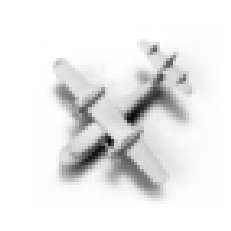

fake images


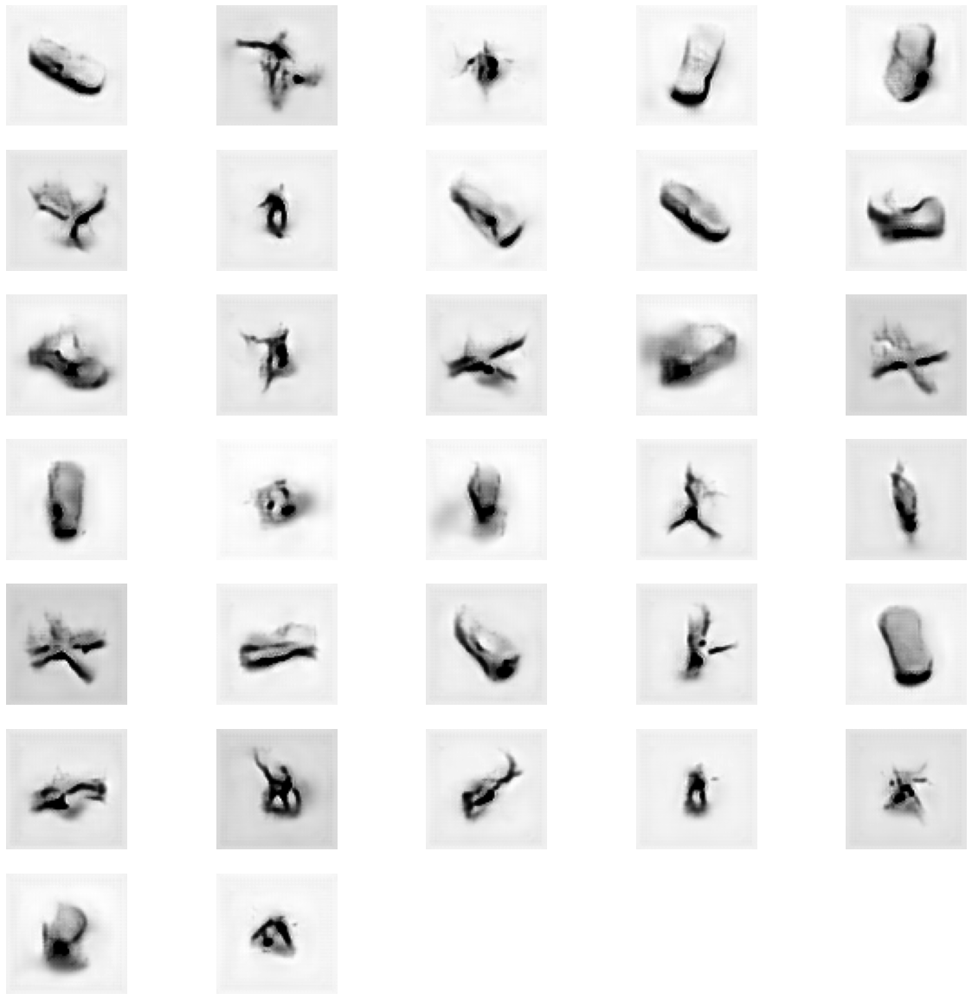

Epoch 33, Generator loss: 1.0959762334823608, discriminator loss: -0.04260732978582382


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


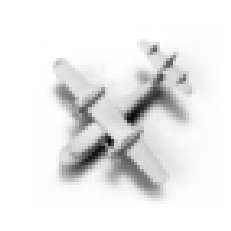

fake images


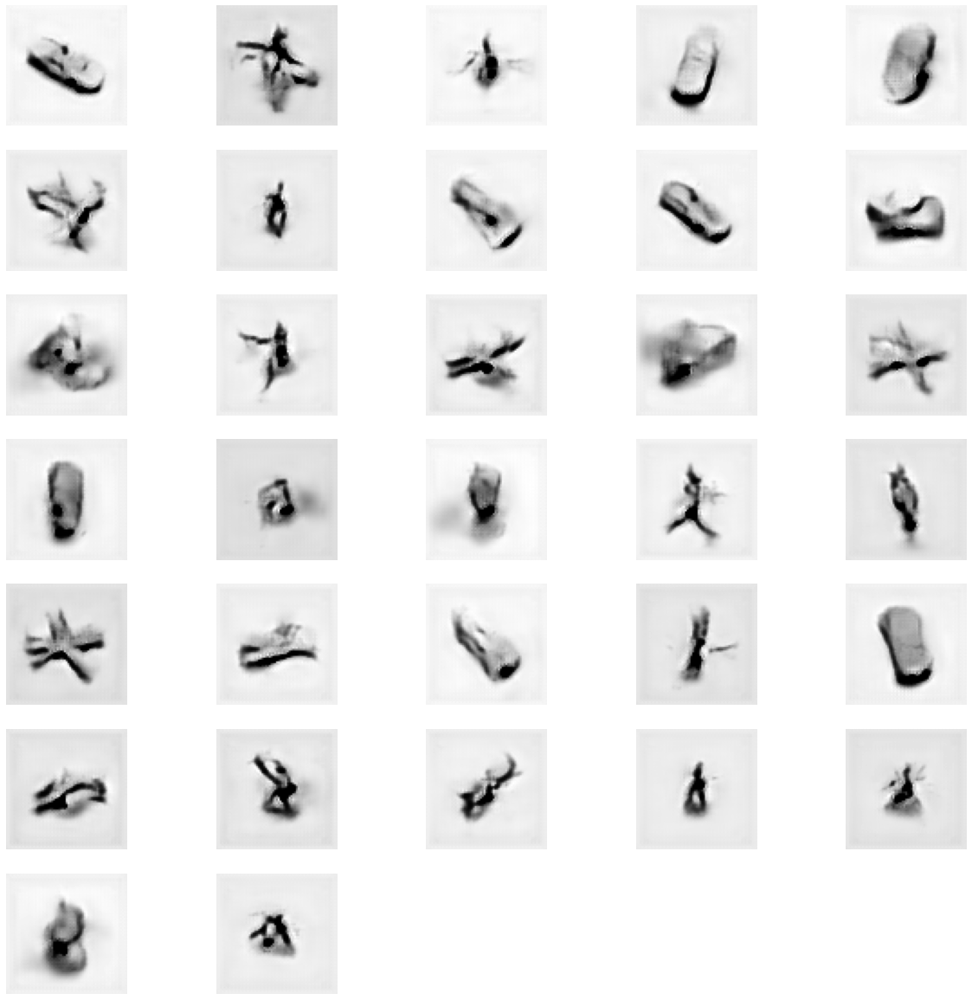

Epoch 34, Generator loss: 0.6588011384010315, discriminator loss: -0.020733694235483824


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


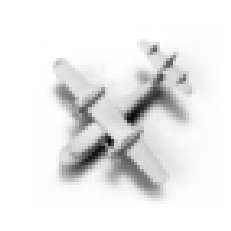

fake images


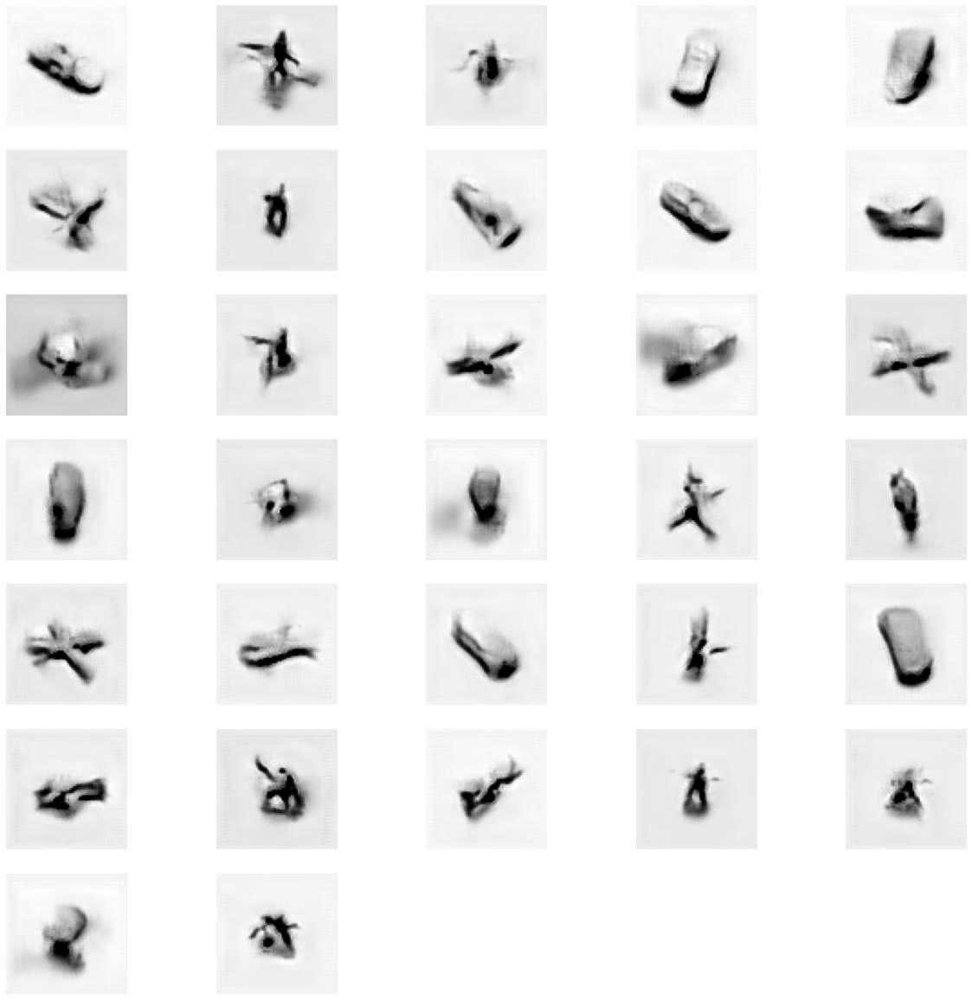

Epoch 35, Generator loss: 0.522465705871582, discriminator loss: 0.12671129157145816


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


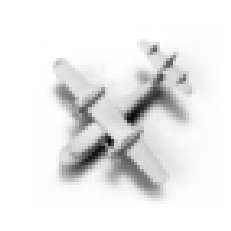

fake images


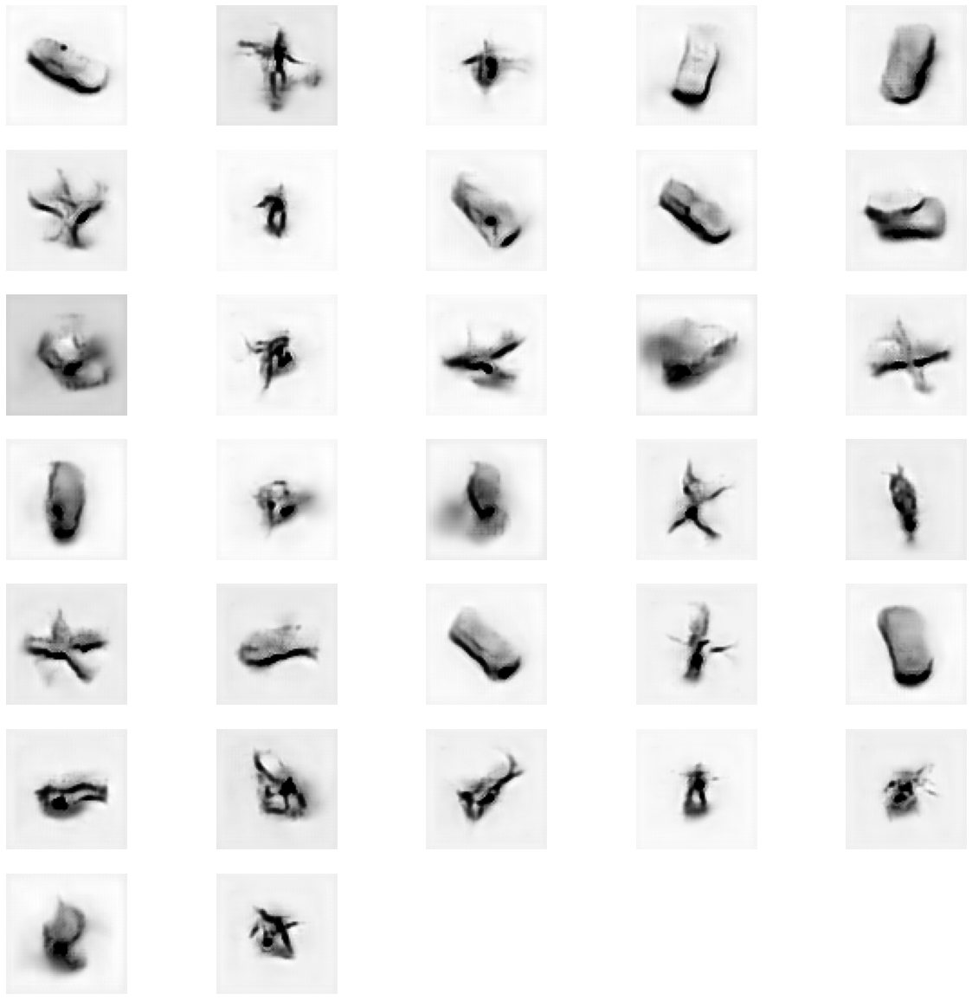

Epoch 36, Generator loss: 0.39864417910575867, discriminator loss: 0.0326604942480723


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


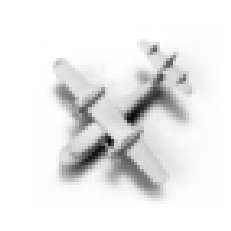

fake images


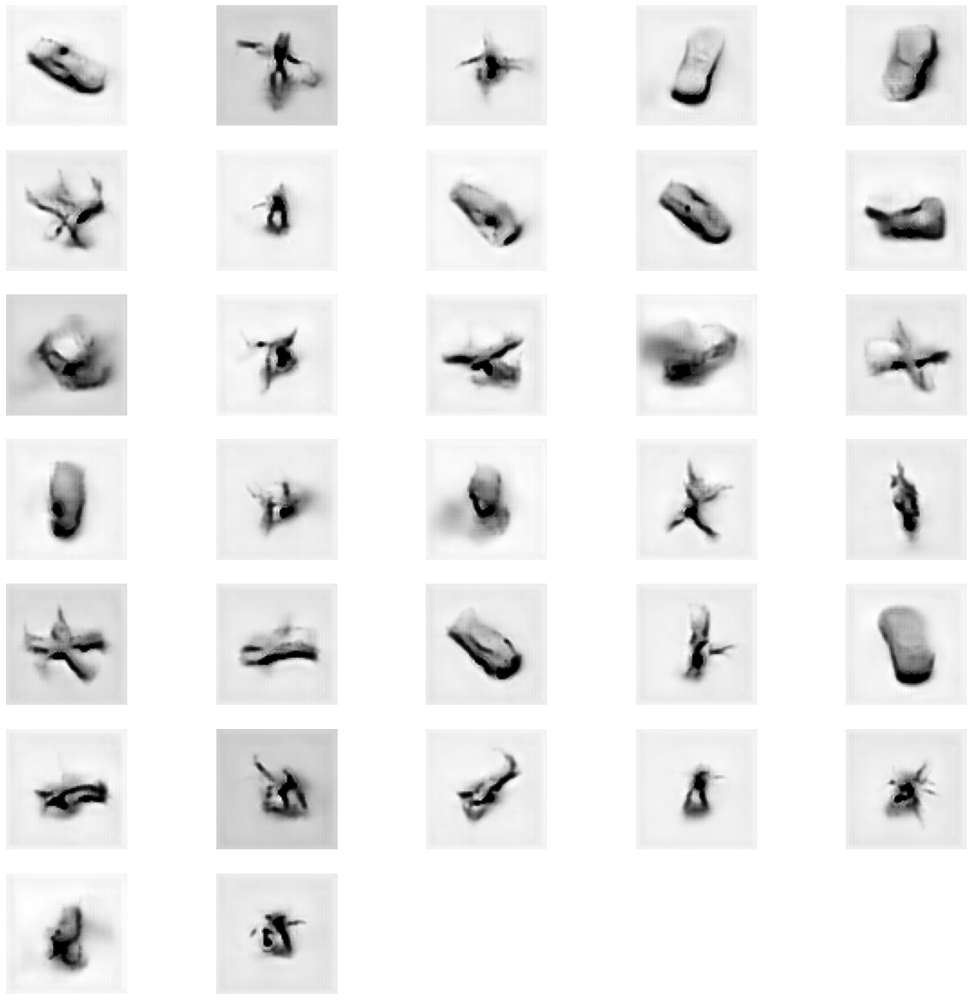

Epoch 37, Generator loss: 0.7469674944877625, discriminator loss: 0.028914819161097227


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


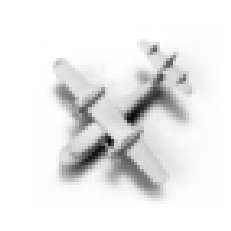

fake images


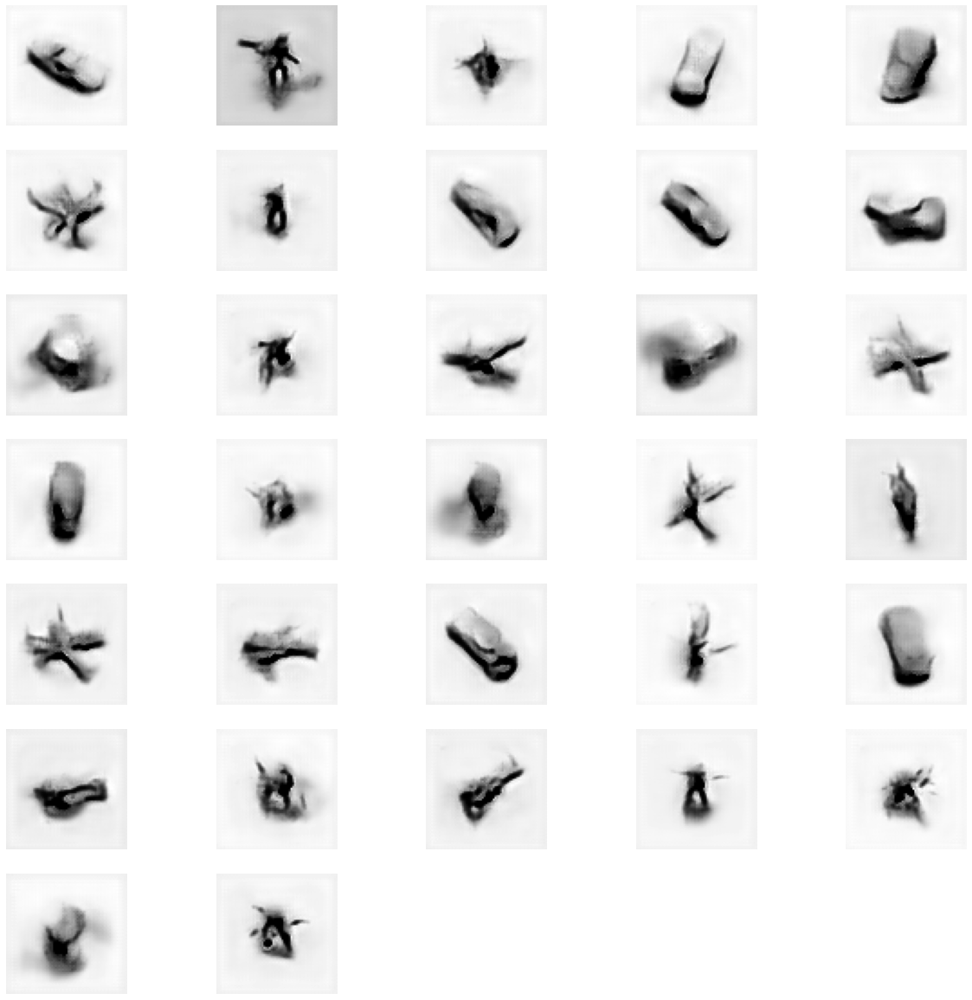

Epoch 38, Generator loss: 0.6813006401062012, discriminator loss: -0.03207945326964061


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


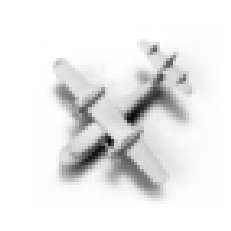

fake images


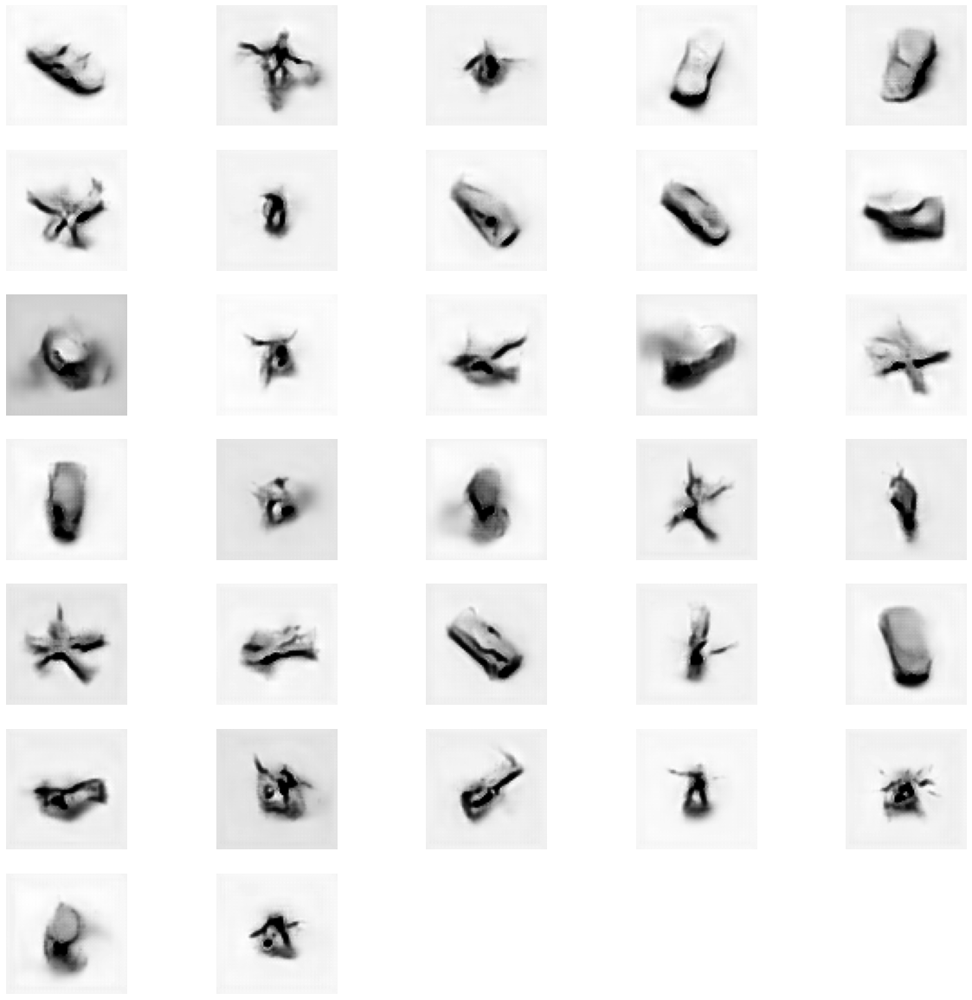

Epoch 39, Generator loss: 0.5273054242134094, discriminator loss: 0.20266522467136383


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


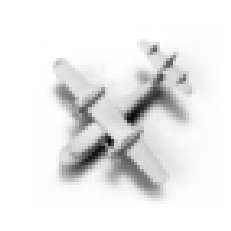

fake images


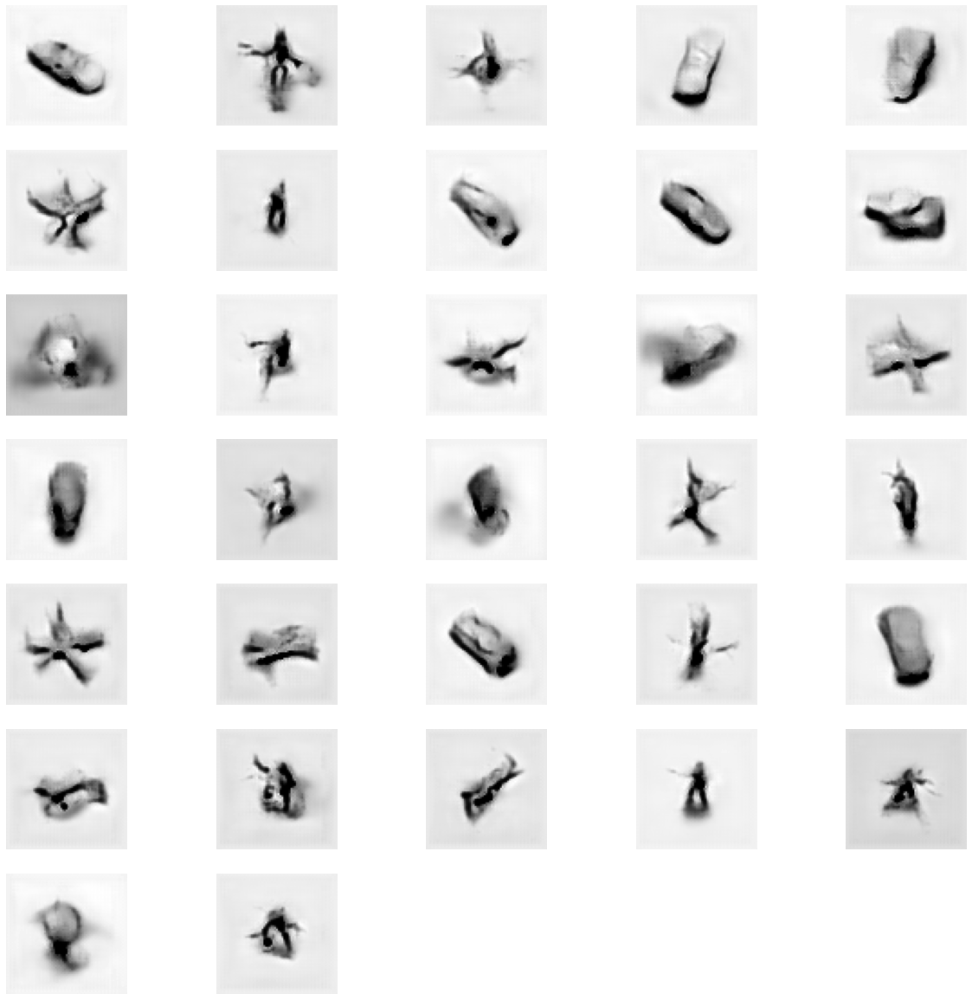

Epoch 40, Generator loss: 0.5671619176864624, discriminator loss: 0.15341384708881378


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


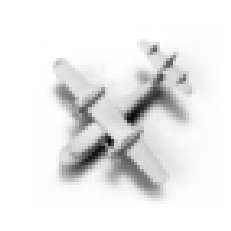

fake images


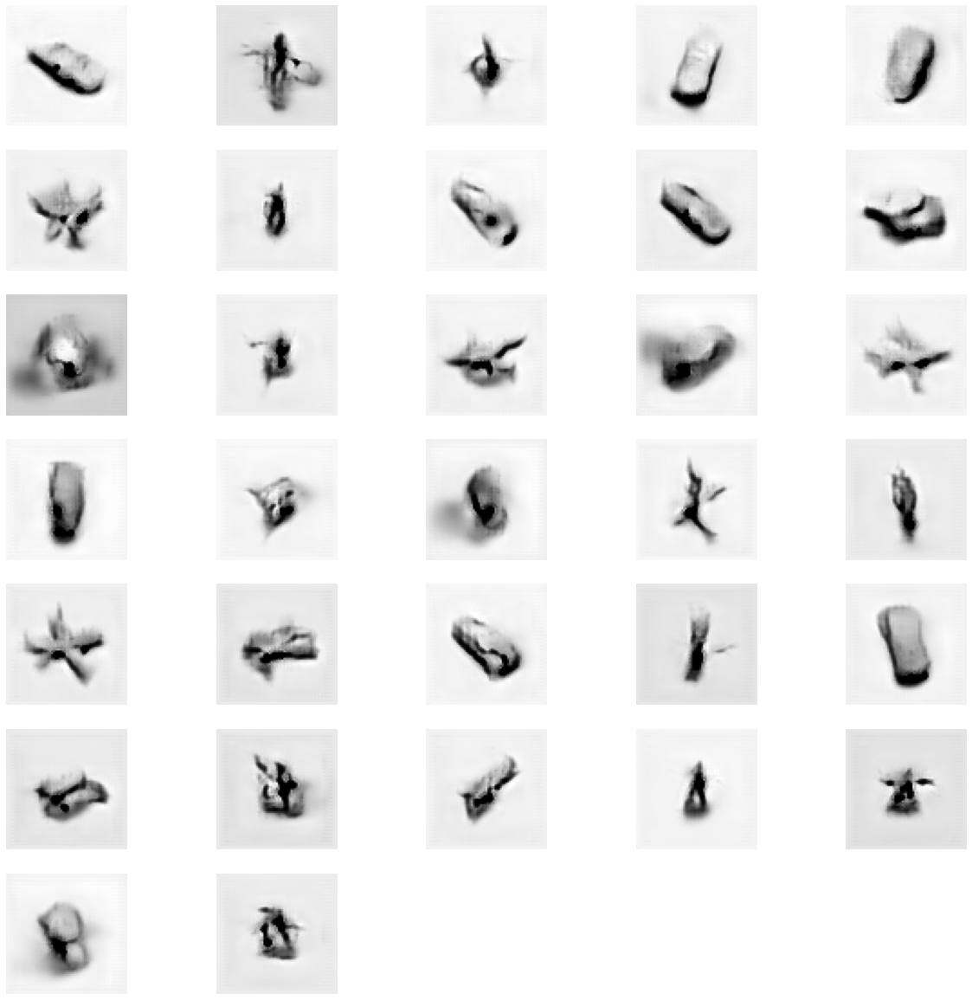

Epoch 41, Generator loss: 0.6141196489334106, discriminator loss: 0.47494272391001385


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


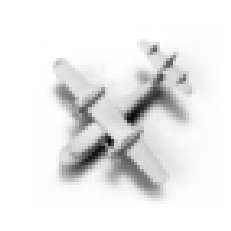

fake images


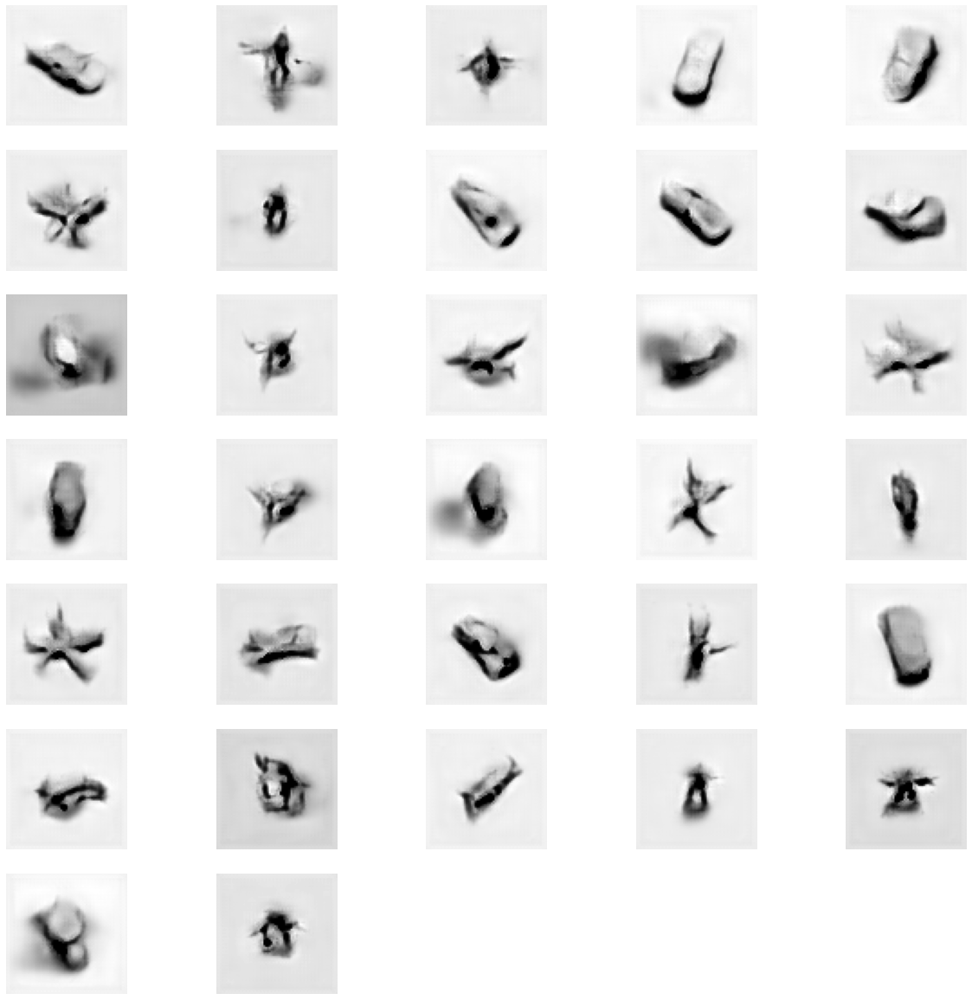

Epoch 42, Generator loss: 0.9511755704879761, discriminator loss: -0.32389165957768756


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


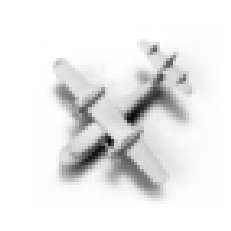

fake images


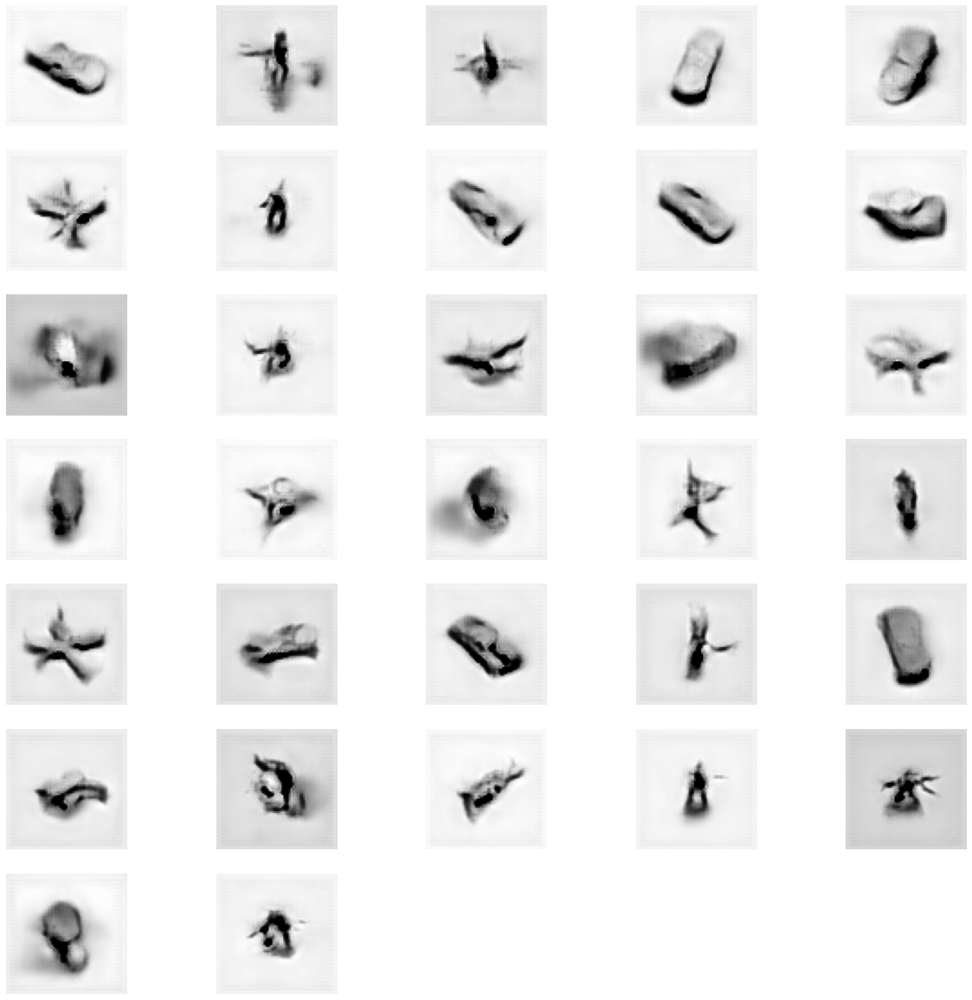

Epoch 43, Generator loss: 0.6296106576919556, discriminator loss: 0.07062979539235434


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


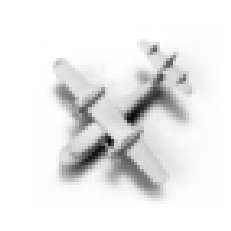

fake images


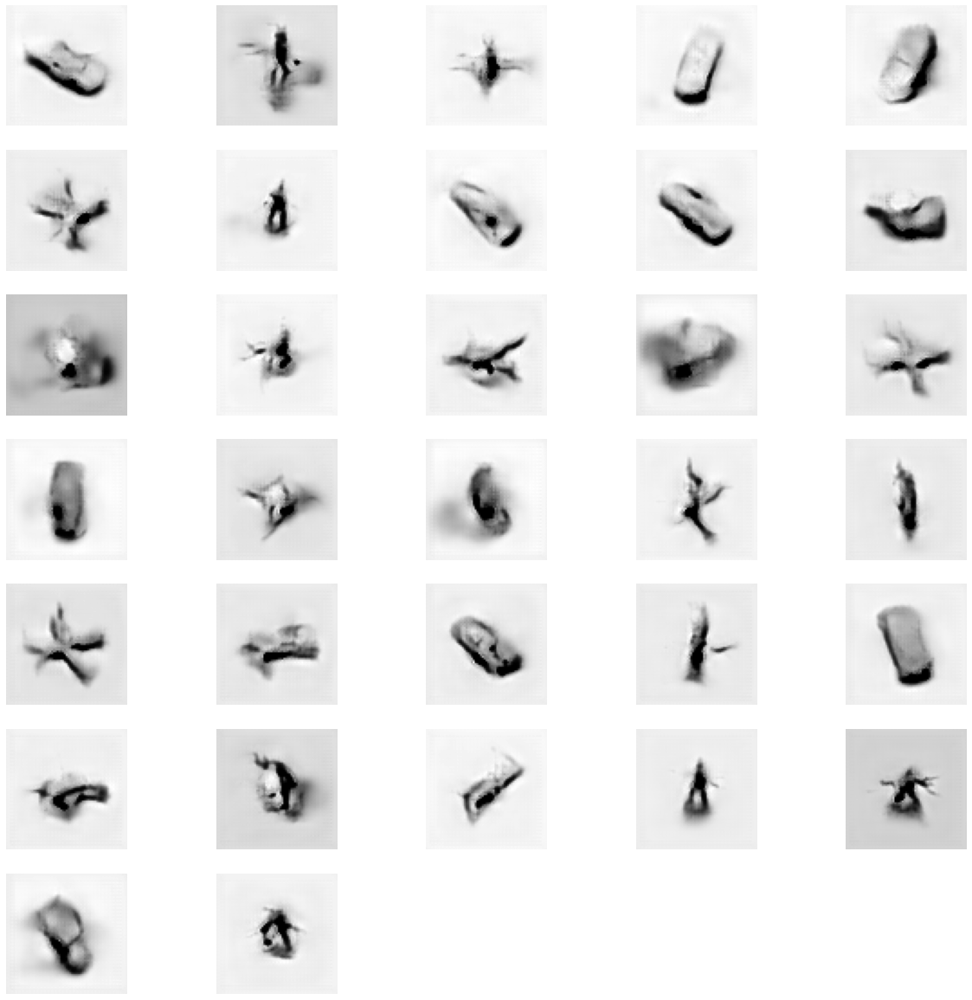

Epoch 44, Generator loss: 0.28131505846977234, discriminator loss: 0.7211204866568248


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


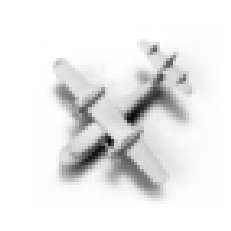

fake images


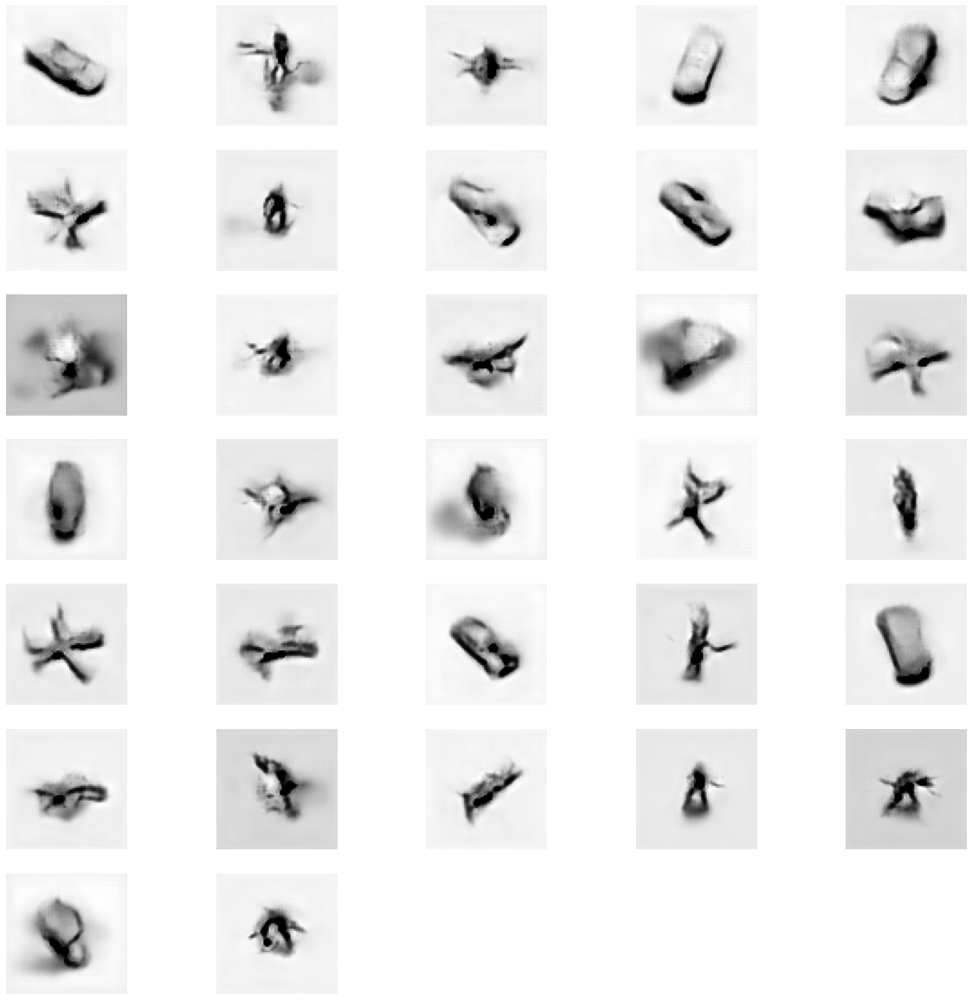

Epoch 45, Generator loss: 0.1908840388059616, discriminator loss: -0.10849035282929739


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


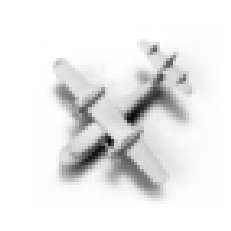

fake images


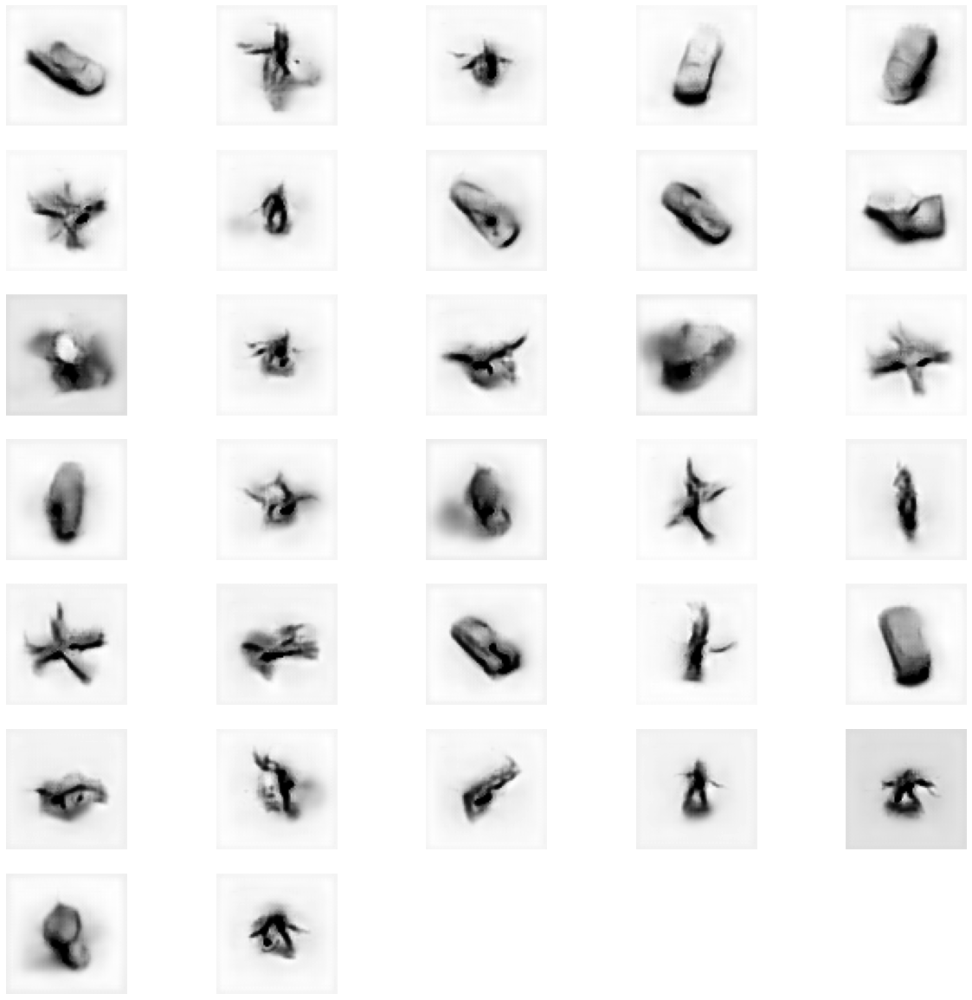

Epoch 46, Generator loss: 0.6513024568557739, discriminator loss: 0.2913743890821933


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


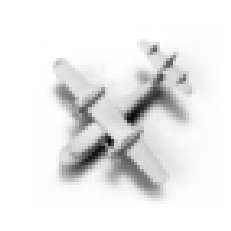

fake images


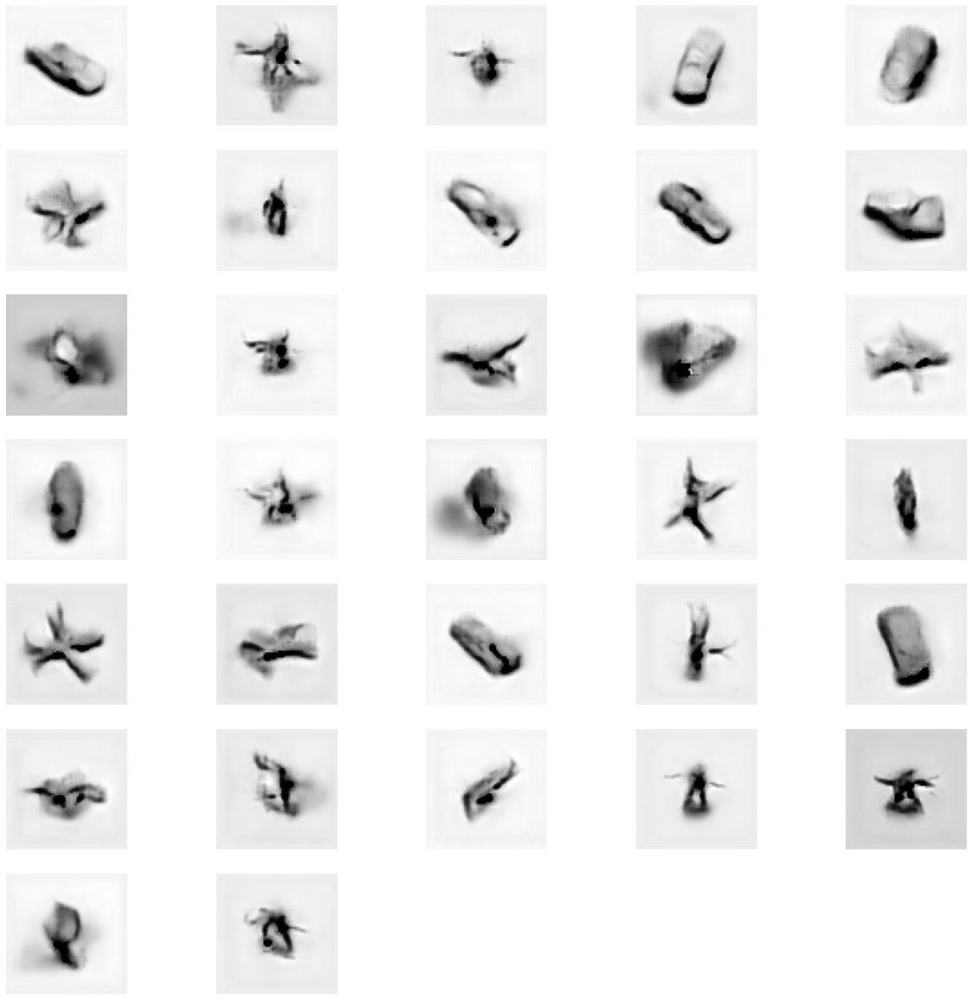

Epoch 47, Generator loss: 0.6077576875686646, discriminator loss: 0.7447711030642192


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


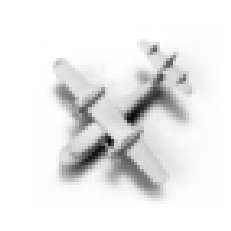

fake images


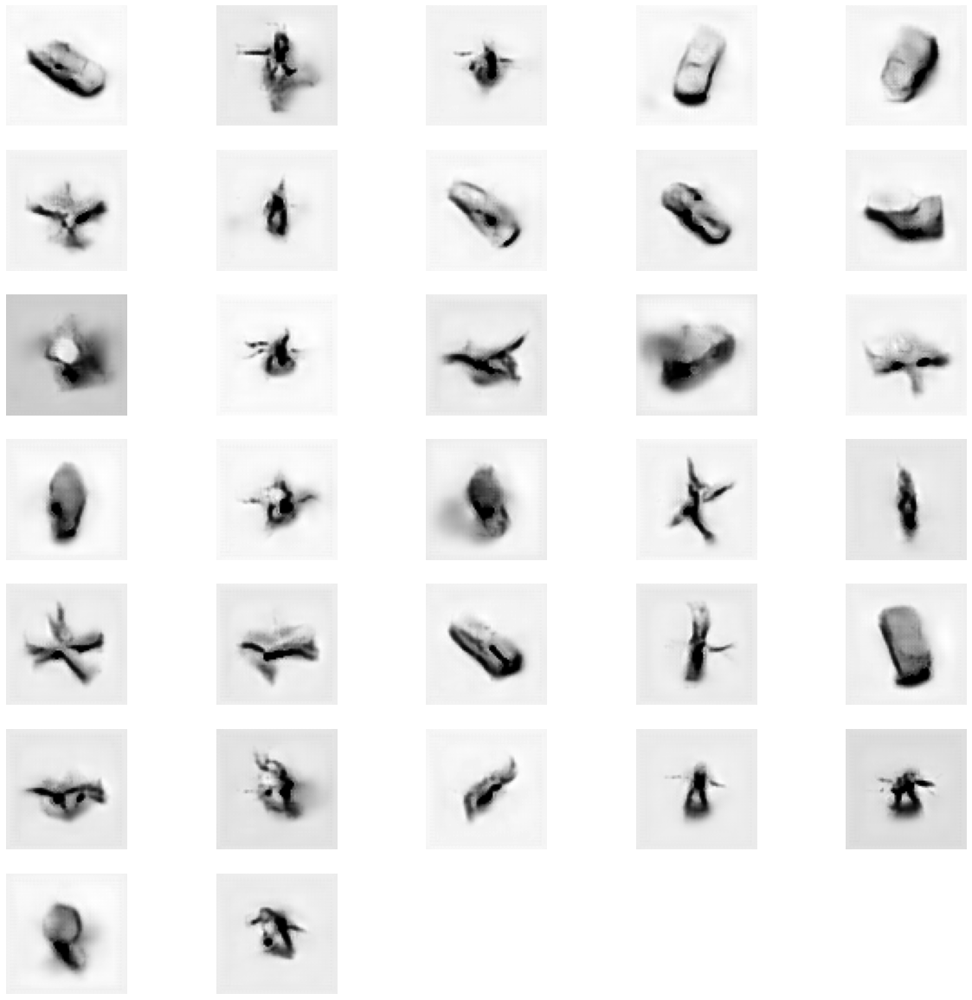

Epoch 48, Generator loss: 0.2229594886302948, discriminator loss: -0.1697961116830508


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


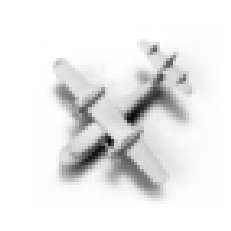

fake images


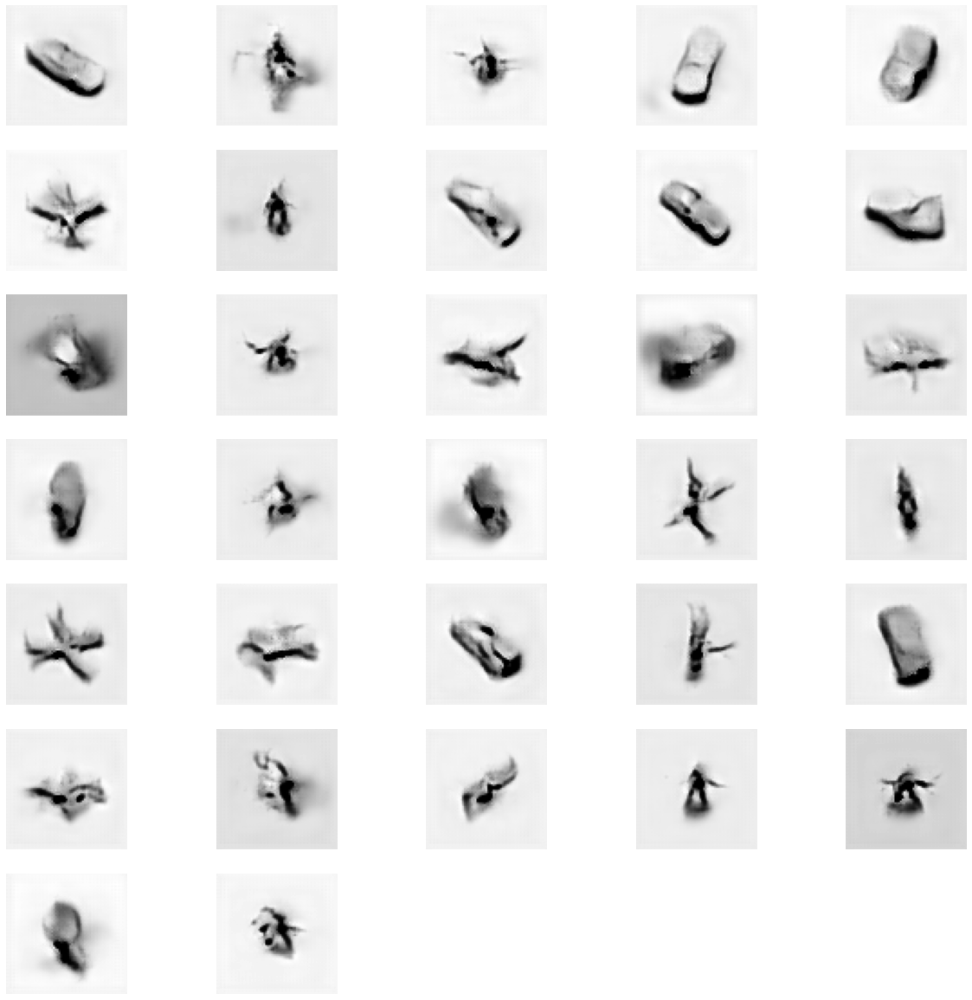

Epoch 49, Generator loss: 0.6251016855239868, discriminator loss: -0.08244896431763966


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


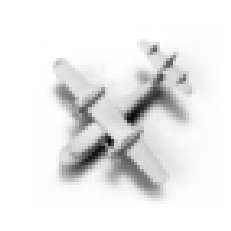

fake images


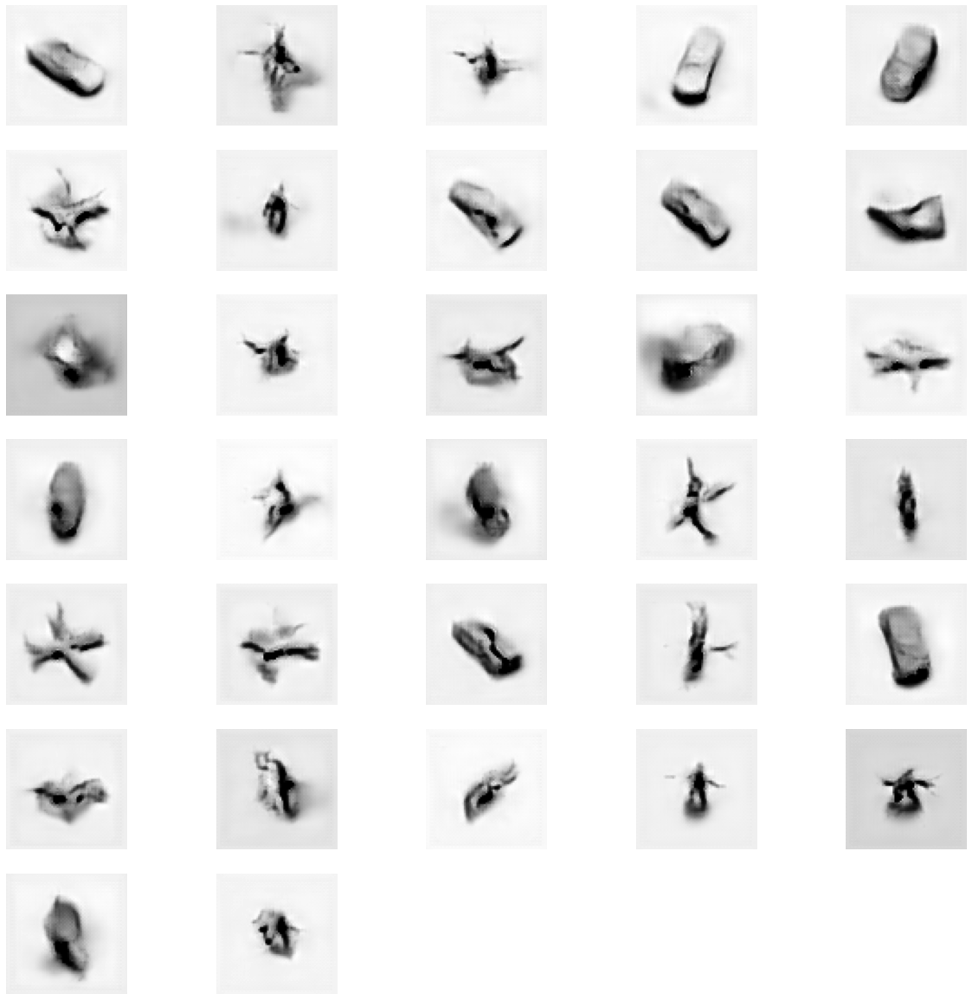

Epoch 50, Generator loss: 0.8500032424926758, discriminator loss: -0.40550270676612854


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


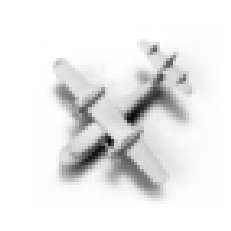

fake images


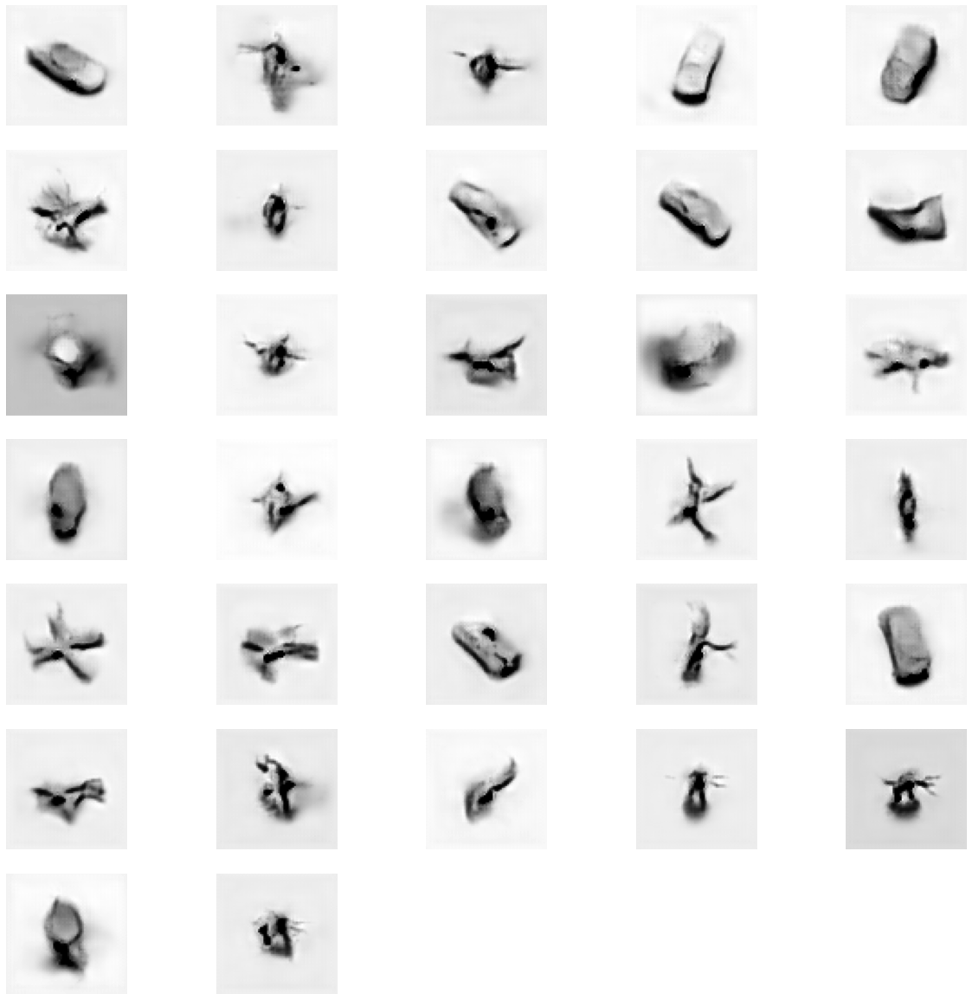

Epoch 51, Generator loss: 0.23778101801872253, discriminator loss: -0.02317177007595698


  0%|          | 0/1519 [00:00<?, ?it/s]

original image


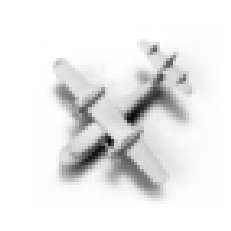

fake images


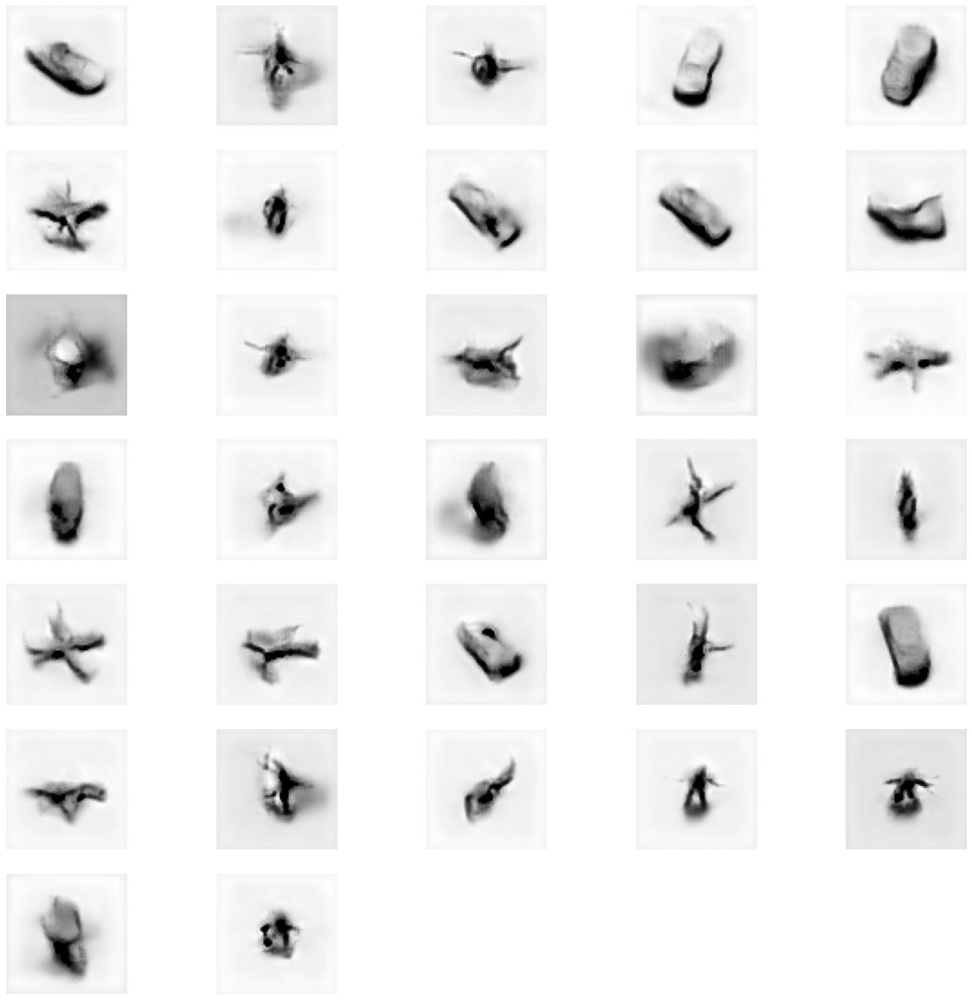

Epoch 52, Generator loss: 0.5707366466522217, discriminator loss: 0.03189963350693383


  0%|          | 0/1519 [00:00<?, ?it/s]

In [ ]:
def multi_one_hot(labels: torch.Tensor, classes: torch.tensor) -> torch.Tensor:        
    """
    Takes a label tensor which multiple categories.
    Creates a one_tensor for each of these categories and combines them in the end to one tensor.
    
    Parameters
    ----------
    labels: torch.Tensor of float
        Contains the classes for multiple categories.
    classes: torch.Tensor of int
        Contains the number of classes for each category.
        
    Returns
    -------
    torch.Tensor
        The combined one_hot tensor object.
    """
    # Define a variable for the output tensor.
    out_labels = None
    
    # Split the label vector in one vector for each category and then loop over each of these new vectors.
    chunks = torch.split(labels, 1, dim=1)
    for i in range(0, len(chunks)):
        # Remove the redundant dimension 1.
        reshaped_chunk = torch.reshape(chunks[i], (labels.size(0),))
        
        # Create the one_hot coded vector for one category.
        one_hot_labels = torch.nn.functional.one_hot(reshaped_chunk, num_classes=classes[i])
        
        # Add the one_hot coded vector to the output vector.
        if out_labels == None:
            out_labels = one_hot_labels
        else:
            out_labels = torch.cat([out_labels, one_hot_labels], 1)
    
    return out_labels


# Create output folder and the images folder inside the output folder.
os.mkdir(RES_OUTPUT_FOLDER)
os.mkdir(os.path.join(RES_OUTPUT_FOLDER, RES_IMAGE_FOLDER))

# Lists for storing the losses.
gen_loss_epoch = []
gen_loss_step = []
crit_loss_epoch = []
crit_loss_step = []
test_loss_epoch = []

# Use the test labels to create a one_hot label tensor.
test_labels = RUN_TEST_LABELS.repeat([PREP_BATCH_SIZE, 1])
test_one_hot_labels = multi_one_hot(test_labels, RUN_LABEL_CHANNELS).to(RUN_DEVICE)

# Create a noise vector, for testing and combine it with the test labels.
test_noise = get_noise(PREP_BATCH_SIZE, RUN_Z_DIM, RUN_DEVICE)
test_noise_and_labels = torch.cat((test_noise.float(), test_one_hot_labels.float()), 1)

# Create a one_hot image tensor based on the test labels.
test_image_one_hot_labels = test_one_hot_labels[:, :, None, None]
test_image_one_hot_labels = test_image_one_hot_labels.repeat(1, 1, PREP_IMAGE_SIZE, PREP_IMAGE_SIZE).to(RUN_DEVICE)

# Run epoch.
for epoch in range(RUN_EPOCHS):  
    # Set loader count and length for showing the last result of the epoch.
    loader_count = 0
    loader_length = len(loader_train)
    
    # Inside the epoch run each batch from the data loader.
    for real, labels in tqdm(loader_train):
        # Create variable for current batch size.
        cur_batch_size = len(real)
        
        # Increase counter.
        loader_count += 1

        # Set the real image to the chosen device.
        real = real.to(RUN_DEVICE)

        # Create one_hot labels and image.       
        one_hot_labels = multi_one_hot(labels, RUN_LABEL_CHANNELS).to(RUN_DEVICE)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, PREP_IMAGE_SIZE, PREP_IMAGE_SIZE).to(RUN_DEVICE)

        mean_iteration_critic_loss = 0
        for _ in range(RUN_CRITIC_REPEAT):
            # Get the noise vector.
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, RUN_Z_DIM, device=RUN_DEVICE)
            # Combine the noise vector with the one_hot labels.
            noise_and_labels = torch.cat((fake_noise.float(), one_hot_labels.float()), 1)
            
            # Create the fake image.
            fake = gen(noise_and_labels).to(RUN_DEVICE)                                     
            
            # Combine real and fake image with the one_hot image.
            fake_image_and_labels = torch.cat((fake, image_one_hot_labels), 1)
            real_image_and_labels = torch.cat((real, image_one_hot_labels), 1)                           
            
            # Send both images through the critic.
            crit_fake_pred = crit(fake_image_and_labels.detach())
            crit_real_pred = crit(real_image_and_labels)
            
            # Calculate the gradient penalty.
            epsilon = torch.rand(cur_batch_size, 1, 1, 1, device=RUN_DEVICE, requires_grad=True)
            gradient = get_gradient(crit, real_image_and_labels, fake_image_and_labels.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, RUN_CRITIC_LAMBDA)

            # Keep track of the average critic loss in this batch.
            mean_iteration_critic_loss += crit_loss.item() / RUN_CRITIC_REPEAT
            
            # Update the gradients.
            crit_loss.backward(retain_graph=True)
            
            # Update the optimizer.
            crit_opt.step()
        
        # Add the critics loss value to the list, after each step.
        crit_loss_step += [mean_iteration_critic_loss]
           
        # Get the noise vector for updating the generator.
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, RUN_Z_DIM, device=RUN_DEVICE)
        
        # Combine the noise vector with the one_hot labels.
        noise_and_labels_2 = torch.cat((fake_noise_2.float(), one_hot_labels.float()), 1)        
        
        # Create fake image for updating the generator. 
        fake_2 = gen(noise_and_labels_2).to(RUN_DEVICE)        
        
        # Combine the fake image with the one_hot image.
        fake_image_and_labels_2 = torch.cat((fake_2, image_one_hot_labels), 1)
        
        # Calculate the prediction and update the generator.
        crit_fake_pred_2 = crit(fake_image_and_labels_2)
        gen_loss = get_gen_loss(crit_fake_pred_2)
        gen_loss.backward()
        gen_opt.step()
        
        # Add the generator loss value to the list, after each step.
        gen_loss_step += [gen_loss.item()]

        # Show the generated images.
        if loader_count == loader_length:            
            # Add the generator and the critic loss to the lists, after each epoch.
            crit_loss_epoch += [mean_iteration_critic_loss]
            gen_loss_epoch += [gen_loss.item()]
            
            # Set the generator and the critic to evaluation mode.
            gen.eval()
            crit.eval()
            
            # Use the test_noise to create images and calculate the loss.
            test_fake = gen(test_noise_and_labels).to(RUN_DEVICE)
            test_fake_image_and_labels = torch.cat((test_fake, test_image_one_hot_labels), 1)
            test_pred = crit(test_fake_image_and_labels.detach())
            test_loss = get_gen_loss(test_pred)
            test_loss_epoch.append(test_loss.item())

            # Save the model to disk.
            if epoch == RUN_EPOCHS - 1:
                torch.save(gen, os.path.join(RES_OUTPUT_FOLDER, '{}model_{:04d}.p'.format(RES_MODEL_PATH, epoch)))
            
            # Set the generator and the critic back into training mode.
            gen.train()
            crit.train()

            # Create a pyplot with the fake images.
            if epoch % RUN_DISPLAY_EACH == 0:
                print('original image')
                show_tensor_images(np.array(test_image), [], 1, int(RES_PLOT_SIZE/RES_PLOT_COLUMNS), 0, '')
                pred_result = test_fake.cpu().detach().numpy()
                pred_result = pred_result * 255
                print('fake images')
                show_tensor_images(pred_result, [], RES_PLOT_COLUMNS, RES_PLOT_SIZE, 0,
                                   os.path.join(
                                       RES_OUTPUT_FOLDER,
                                       RES_IMAGE_FOLDER ,
                                       'image_for_epoch_{:04d}'.format(epoch)
                                   )
                                  )

            # Print the loss values for this epoch.
            print(f"Epoch {epoch}, Generator loss: {gen_loss.item()}, discriminator loss: {mean_iteration_critic_loss}")

print('Finished training the network.')

## Results
### Description
* Show loss value in a line diagram.
* Save the loss values to file.
* Create a GIF file from the single PNG files.
* Show the GIF file.

In [ ]:
# Show loss value for each step in the training process.
plt.plot(np.array(gen_loss_step), label='gen-loss', color='red')
plt.plot(np.array(crit_loss_step), label='crit-loss', color='blue')
plt.xlabel('steps')
plt.ylabel('loss')
plt.legend()
plt.savefig(os.path.join(RES_OUTPUT_FOLDER, RES_LOSS_PLOT_TRAIN))
plt.show()

# Show all loss values after each epoch.
plt.plot(np.array(gen_loss_epoch), label='gen-loss', color='red')
plt.plot(np.array(crit_loss_epoch), label='crit-loss', color='blue')
plt.plot(np.array(test_loss_epoch), label='test-loss', color='green')
plt.xlabel('epochs')
plt.ylabel('loss')
plt.legend()
plt.savefig(os.path.join(RES_OUTPUT_FOLDER, RES_LOSS_PLOT_TEST))
plt.show()

# Store data in text files.
np.savetxt(os.path.join(RES_OUTPUT_FOLDER, RES_LOSS_DATA_CRIT), np.array(crit_loss_epoch))
np.savetxt(os.path.join(RES_OUTPUT_FOLDER, RES_LOSS_DATA_GEN), np.array(gen_loss_epoch))
np.savetxt(os.path.join(RES_OUTPUT_FOLDER, RES_LOSS_DATA_TEST), np.array(test_loss_epoch))

# Get all the PNG filenames and sort them.
filenames = glob.glob(os.path.join(RES_OUTPUT_FOLDER, RES_IMAGE_FOLDER, 'image*.png'))
filenames = sorted(filenames)

# Create one GIF file from all the PNG files.
images = []
gif_file = os.path.join(RES_OUTPUT_FOLDER, RES_GIF_FILE)
for filename in filenames:
    images.append(imageio.v2.imread(filename))
imageio.mimsave(gif_file, images, fps=3)

# Show the GIF file.
Image(url=gif_file)